In [1228]:
%load_ext autoreload
%autoreload 2

import os
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import iqr
from astropy.coordinates import SkyCoord, EarthLocation, AltAz, ICRS
from astropy.time import Time
from astropy.timeseries import LombScargle
from astropy.wcs import WCS
from astropy import units as u
from astropy.io import fits
from astropy import constants
from astropy.modeling.models import BlackBody
from astropy.visualization import quantity_support
from tqdm import tqdm


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [45]:
#Move up to RAFTS directory
if os.getcwd().endswith('/RAFTS'):
    pass
else:
    os.chdir('..')

In [46]:
pwd

'/Users/fbianco/RAFTS'

In [47]:
!pip install photutils

In [1343]:

from photutils.psf import IntegratedGaussianPRF, PSFPhotometry, ImagePSF, MoffatPSF, CircularGaussianPRF, CircularGaussianPSF, GaussianPSF, GaussianPRF, CircularGaussianSigmaPRF
from photutils.detection import DAOStarFinder
from photutils.aperture import CircularAperture
from photutils.background import MMMBackground, LocalBackground


from utils import filt_interp, dpar, dtan, lamb_eff_md, dcr_offset, celest_to_pa, inverse_Teff, inverseTeff, inverseWeff, lorentzian, find_min_max_adjacent, variance_weighted_mean, chrDistAng
import globals
import defs as defs


from config import *


In [1230]:
CircularGaussianPSF?

Init signature:
CircularGaussianPSF(
    *,
    flux=1,
    x_0=0,
    y_0=0,
    fwhm=1,
    bbox_factor=5.5,
    **kwargs,
)
Docstring:     
A circular 2D Gaussian PSF model.

This model is evaluated by sampling the 2D Gaussian at the input
coordinates. The Gaussian is normalized such that the analytical
integral over the entire 2D plane is equal to the total flux.

Parameters
----------
flux : float, optional
    Total integrated flux over the entire PSF.

x_0 : float, optional
    Position of the peak along the x axis.

y_0 : float, optional
    Position of the peak along the y axis.

fwhm : float, optional
    The full width at half maximum (FWHM) of the Gaussian.

bbox_factor : float, optional
    The multiple of the standard deviation (sigma) used to define
    the bounding box limits.

**kwargs : dict, optional
    Additional optional keyword arguments to be passed to the
    `astropy.modeling.Model` base class.

See Also
--------
GaussianPSF, GaussianPRF, CircularGaussianPRF, 

(3000.0, 10000.0)

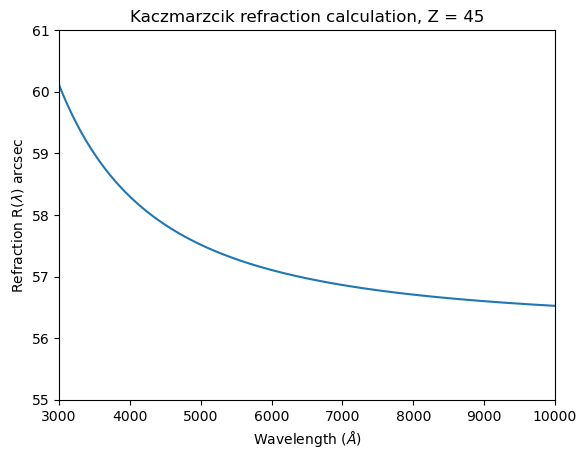

In [49]:
#plt.plot(np.arange(3000, 10000), R(l = np.arange(3000, 10000), Z = 45))
plt.plot(np.arange(3000, 10000), dcr_offset(w_eff=np.arange(3000, 10000), airmass= 1 / np.cos(np.deg2rad(45))))
plt.xlabel(r'Wavelength ($\AA$)')
plt.ylabel(r'Refraction R($\lambda$) arcsec')
plt.title('Kaczmarzcik refraction calculation, Z = 45')
plt.ylim(55,61)
plt.xlim(3000, 10000)

In [50]:
#PARAMS
flare_ref_pos = np.array([323.0, 429.5])

filters = ['u', 'g', 'r', 'i', 'z', 'y']

filtercolors = {
            "u": "#66CCEE",
            "g": "#228833",
            "r": "#CCBB44",
            "i": "#EE6677",
            "z": "#AA3377",
            "y": "#4B3713",
            " ": None}

In [51]:
hdu_list = fits.open('dwfflare/0a7936112f3150350b27277900f88de2_c4d_151218_061807_ooi_g_v1.fits.fz')
hdu_list.info()

Filename: dwfflare/0a7936112f3150350b27277900f88de2_c4d_151218_061807_ooi_g_v1.fits.fz
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     251   ()      
  1  S29           1 CompImageHDU    129   (2046, 4094)   float32   
  2  S31           1 CompImageHDU    129   (2046, 4094)   float32   
  3  S25           1 CompImageHDU    129   (2046, 4094)   float32   
  4  S26           1 CompImageHDU    129   (2046, 4094)   float32   
  5  S27           1 CompImageHDU    129   (2046, 4094)   float32   
  6  S28           1 CompImageHDU    129   (2046, 4094)   float32   
  7  S20           1 CompImageHDU    129   (2046, 4094)   float32   
  8  S21           1 CompImageHDU    129   (2046, 4094)   float32   
  9  S22           1 CompImageHDU    129   (2046, 4094)   float32   
 10  S23           1 CompImageHDU    129   (2046, 4094)   float32   
 11  S24           1 CompImageHDU    129   (2046, 4094)   float32   
 12  S14           1 CompImageHDU    129 

In [52]:
hdu_list[16].data

array([[28.64088 , 31.617392, 24.957178, ..., 27.005594, 32.783024,
        29.117338],
       [20.971172, 30.57876 , 24.09615 , ..., 23.898054, 27.95859 ,
        20.740602],
       [28.406326, 25.357933, 29.101353, ..., 29.05602 , 25.20106 ,
        18.529772],
       ...,
       [26.60759 , 34.178654, 29.469402, ..., 30.430195, 37.16763 ,
        21.072706],
       [22.315039, 34.979946, 32.176346, ..., 27.95241 , 32.472675,
        18.84519 ],
       [37.708824, 38.4955  , 28.122744, ..., 32.688633, 38.295967,
        35.173634]], dtype=float32)

In [867]:
imnames = np.array(os.listdir('dwfflare'))
imnames = np.array([i for i in imnames if i.endswith("fits.fz") or i.endswith("fits")])
len(imnames)

74

In [868]:
print(f"image sequence length {len(imnames)}")

image sequence length 74


In [869]:
#Collect DATE-OBS list
datelist = []

for i, imname in enumerate(imnames):
    try:
        image_header = fits.getheader('dwfflare/' + imname, ext=0)
        datelist.append(image_header['DATE-OBS'])

    except:
        print(i, 'EXT not found')
        datelist.append(image_header['DATE-OBS'])

datearr = np.array(datelist)
len(datearr)

74

In [870]:
#Find .fits files that are missing S18 extension
badinds = []
for i, imname in enumerate(imnames):
    try:
        image_data = fits.getheader('dwfflare/' + imname, ext=16)

    except:
        print(i, 'EXT not found')
        badinds.append(i)

badinds = np.array(badinds)
print(f"bad images {badinds}")

bad images []


In [871]:
mask = np.ones(len(imnames), dtype=int)
if len(badinds) > 0:
    mask[badinds] = 0

mask = mask > 0
mask

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True])

In [872]:
imnames_timeordered = imnames[mask][np.argsort(datearr[mask])]
np.save('Outdata/imnames_timeordered.npy', imnames_timeordered)

b5179de7a72a8849306cf70093d016bc_c4d_151218_054742_ooi_g_v1.fits.fz 0


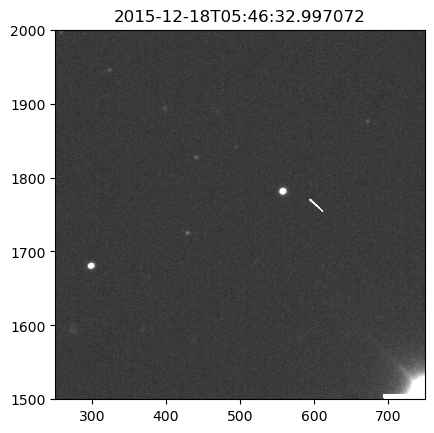

44e34c2464b4477790f1ddab41a0cf7c_c4d_151218_054831_ooi_g_v1.fits.fz 1


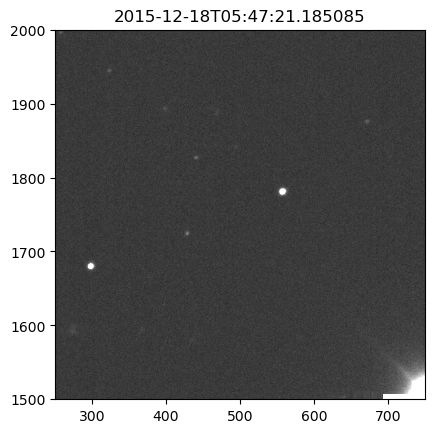

d2b98624b2c1e0051043ed108f6e7c63_c4d_151218_054916_ooi_g_v1.fits.fz 2


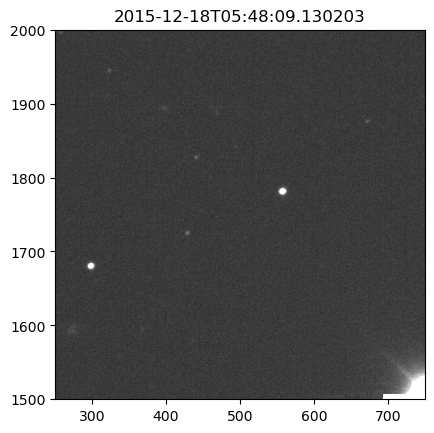

370d8dbb65092bb228338aadcd46c158_c4d_151218_055006_ooi_g_v1.fits.fz 3


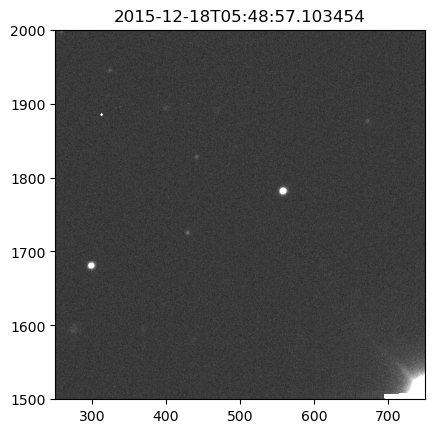

ade32d4a253351f296c2bd61b1948fb5_c4d_151218_055051_ooi_g_v1.fits.fz 4


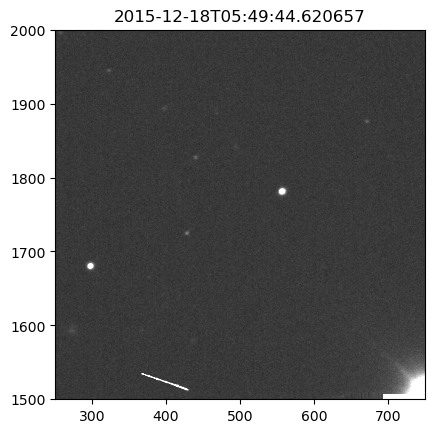

bda9e563645b4ef7e7f01338339cebdc_c4d_151218_055143_ooi_g_v1.fits.fz 5


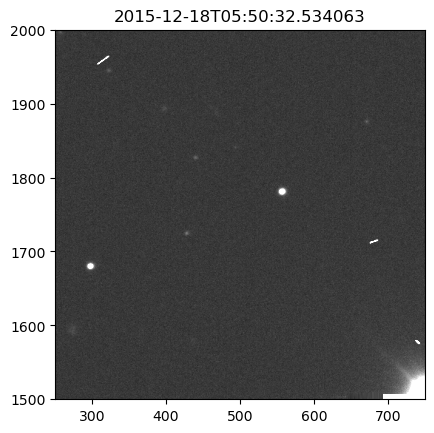

5e5d19a8b76fc07db04a6498ed480980_c4d_151218_055228_ooi_g_v1.fits.fz 6


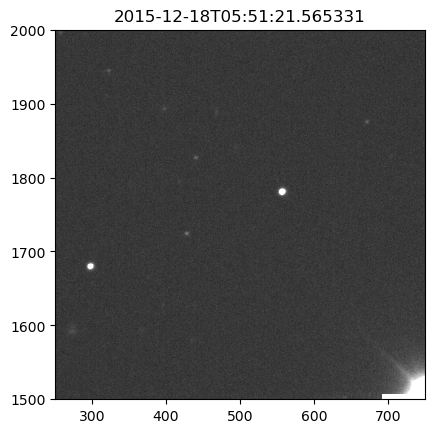

2984aa9c1e3c5a7fcdf1cf6112c01dc3_c4d_151218_055317_ooi_g_v1.fits.fz 7


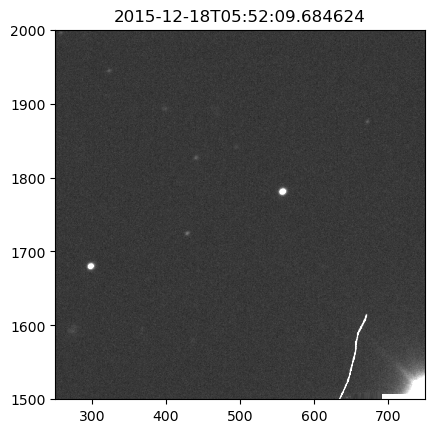

a9d2b01d33deca7b8e003abc0dd40e37_c4d_151218_055407_ooi_g_v1.fits.fz 8


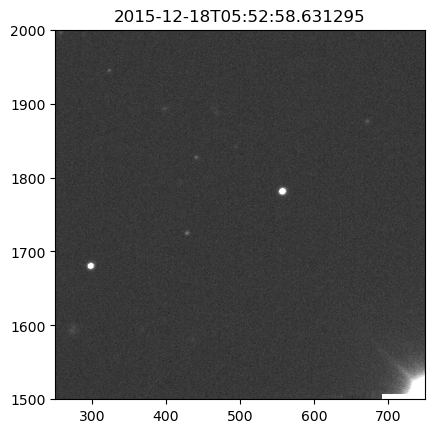

afb98733c62918af1816248b74cc446e_c4d_151218_055454_ooi_g_v1.fits.fz 9


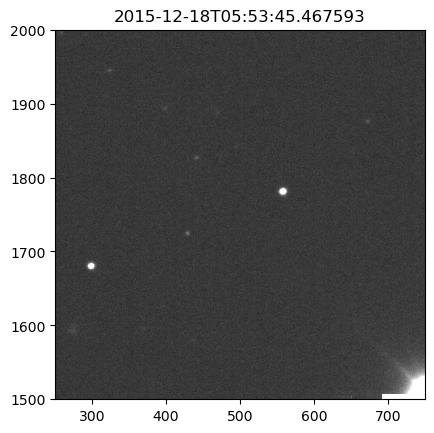

c5cab604683b516a212870ffab507f17_c4d_151218_055541_ooi_g_v1.fits.fz 10


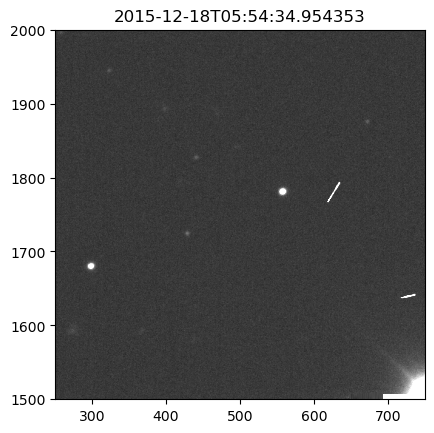

5fad601ba381f997e2b6c5948853adcb_c4d_151218_055629_ooi_g_v1.fits.fz 11


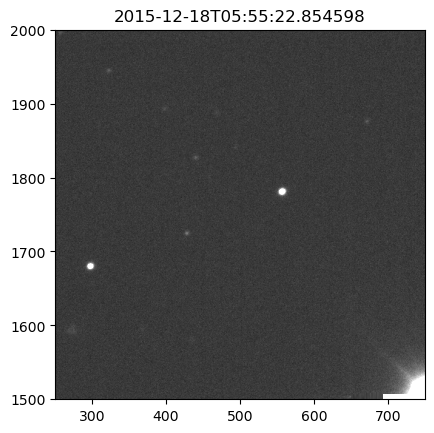

997f4475f26a50f2fab9aca7057bc34d_c4d_151218_055720_ooi_g_v1.fits.fz 12


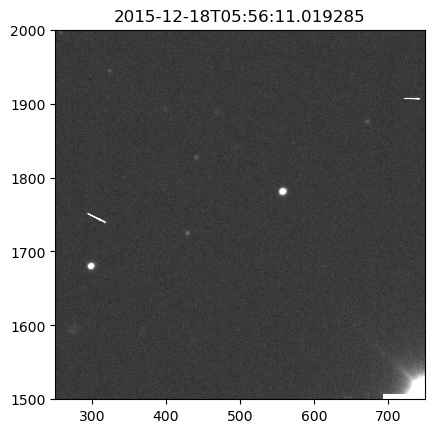

b9c32879cc22a5aa96520a31801615f1_c4d_151218_055809_ooi_g_v1.fits.fz 13


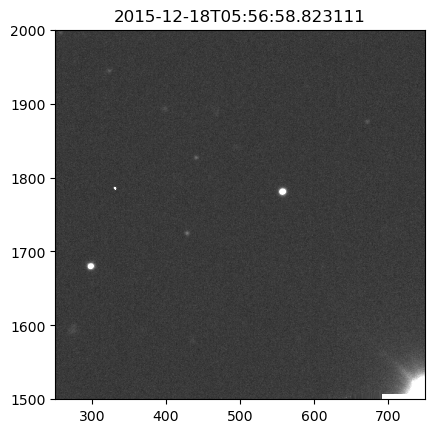

092570474462779fa0ac545c74b697bf_c4d_151218_055856_ooi_g_v1.fits.fz 14


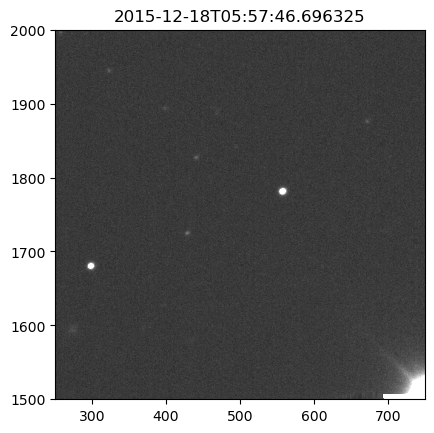

d9fc42e90f8eeef6fdd6cb92dc0241c9_c4d_151218_055947_ooi_g_v1.fits.fz 15


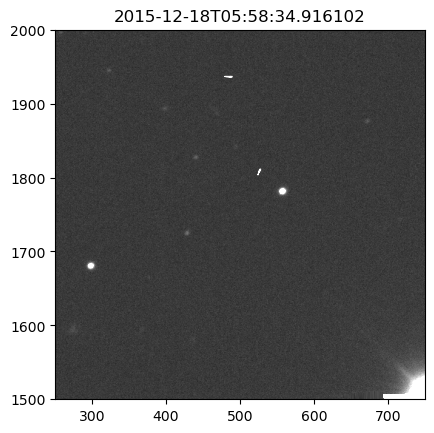

26c13b50b705e7924e5ea246b642523c_c4d_151218_060031_ooi_g_v1.fits.fz 16


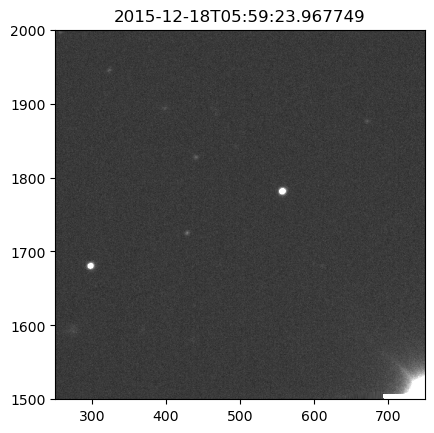

caf8c3bd78fbdbd32577a51c46801830_c4d_151218_060118_ooi_g_v1.fits.fz 17


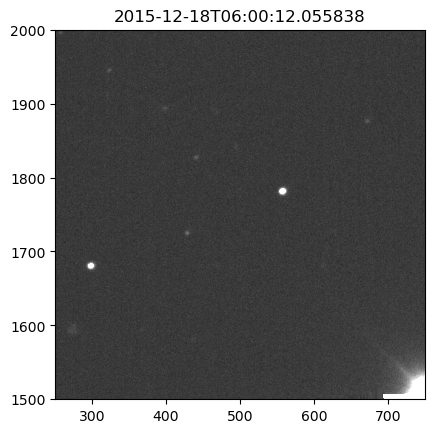

2e729528f63c6e173baaaf5b54df535d_c4d_151218_060208_ooi_g_v1.fits.fz 18


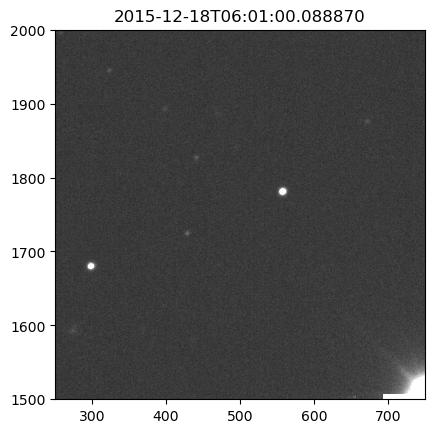

304cd4134c9535600fe55c7e63a71053_c4d_151218_060257_ooi_g_v1.fits.fz 19


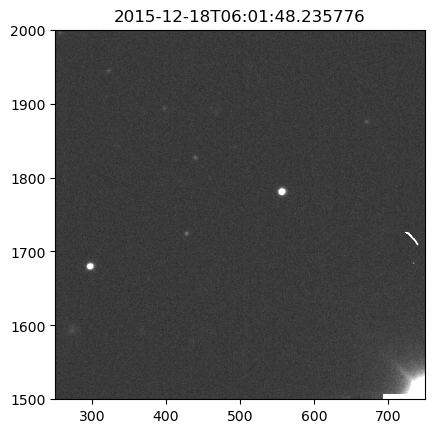

86dc03d642083c4411ef7acb103b7ed6_c4d_151218_060346_ooi_g_v1.fits.fz 20


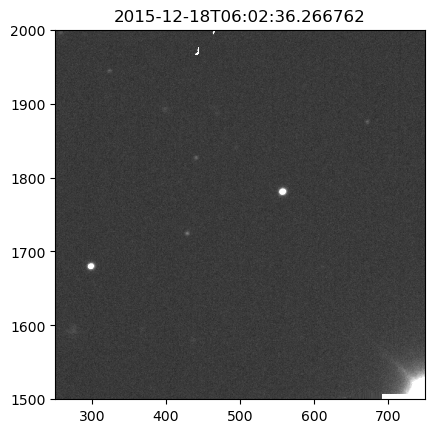

a9dced316614c919819ec7e155f4216a_c4d_151218_060433_ooi_g_v1.fits.fz 21


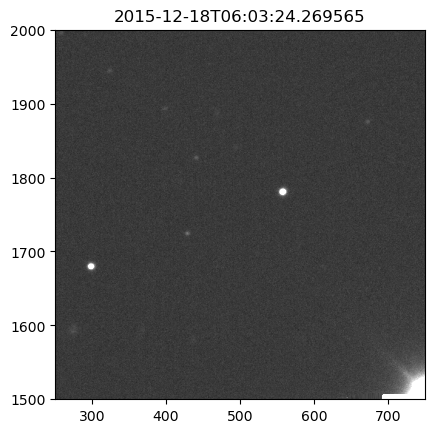

83f149944c64806aaa5454648d982d9e_c4d_151218_060521_ooi_g_v1.fits.fz 22


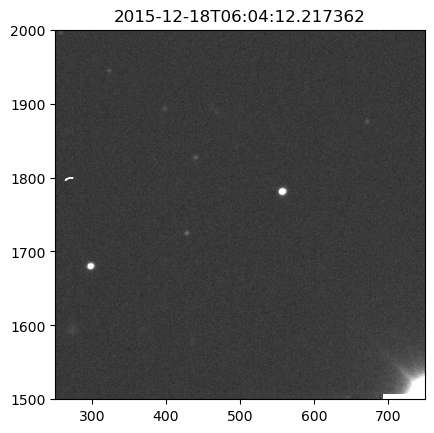

d904d4f514304d4f048be5ce85bf2c47_c4d_151218_060609_ooi_g_v1.fits.fz 23


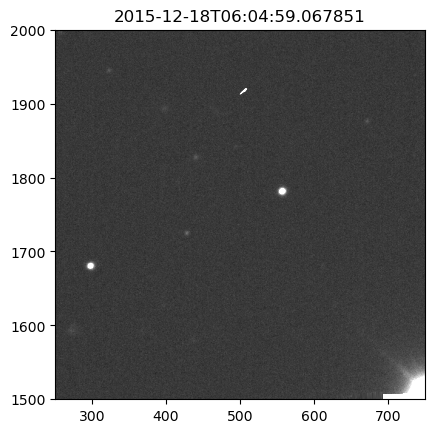

054934c394a7e0349352f660bfe1802b_c4d_151218_060655_ooi_g_v1.fits.fz 24


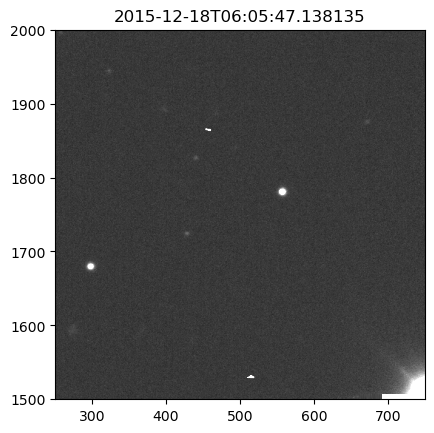

a58663caadc8b97bfaf4df72ed40e359_c4d_151218_060746_ooi_g_v1.fits.fz 25


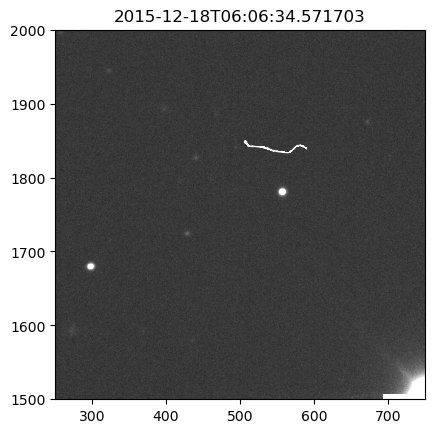

7ef731f77677d0bc75720d46628965ea_c4d_151218_060834_ooi_g_v1.fits.fz 26


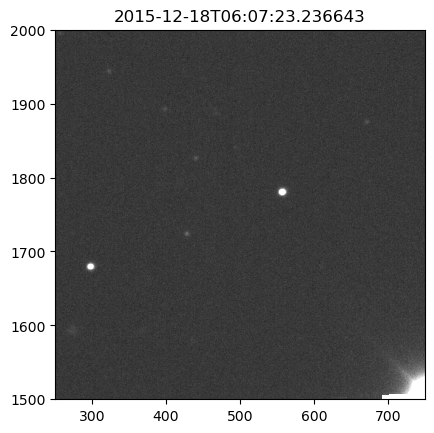

72804a00ade9048948bec579a6c1ba3b_c4d_151218_060925_ooi_g_v1.fits.fz 27


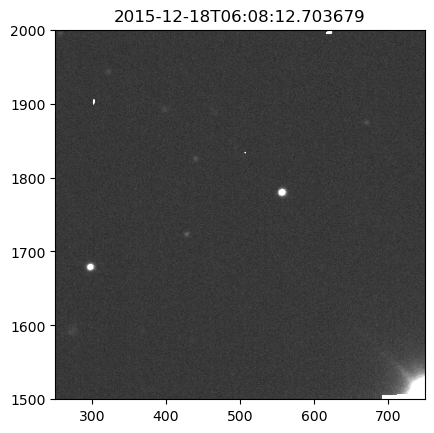

01f29585b8ab98b9445263645de2b759_c4d_151218_061011_ooi_g_v1.fits.fz 28


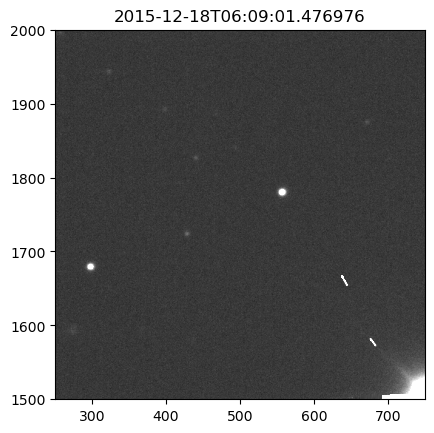

9719d5936f044286414621fffbf331a8_c4d_151218_061057_ooi_g_v1.fits.fz 29


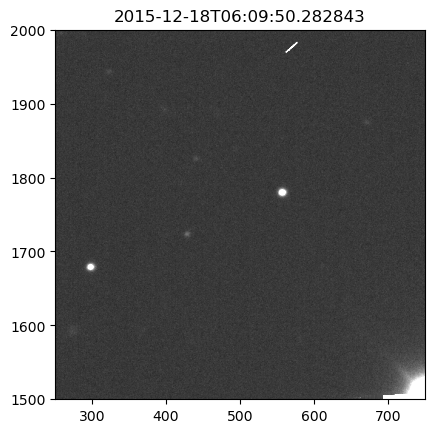

489f990fd94eb9cff4b14219e98b6bde_c4d_151218_061146_ooi_g_v1.fits.fz 30


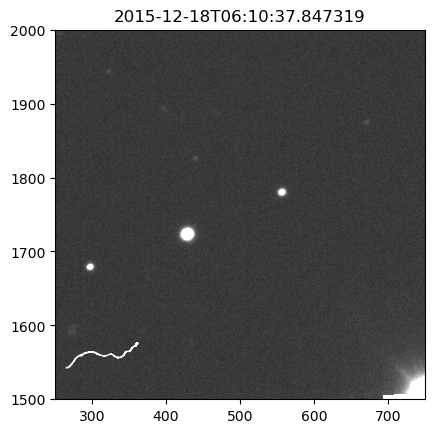

b4fd011a982f3ea4a2d00f14bb454f12_c4d_151218_061233_ooi_g_v1.fits.fz 31


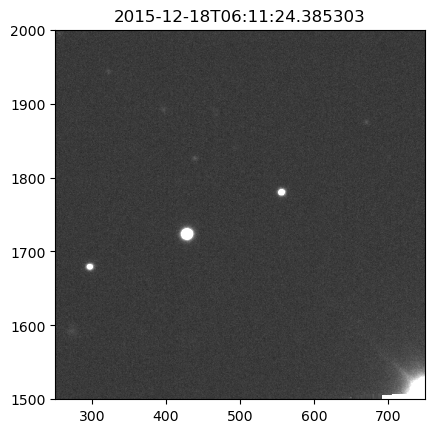

f4facbcacb39955e95a1e203476c0827_c4d_151218_061322_ooi_g_v1.fits.fz 32


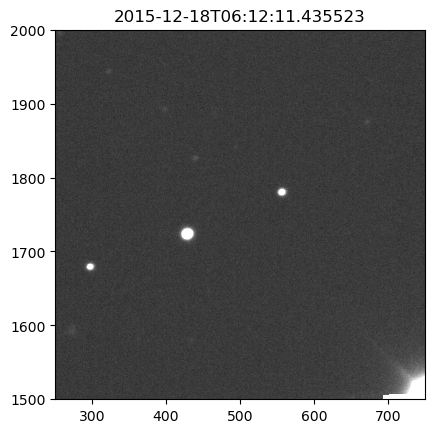

8c580798670c1fdc4ba4b9b98d649a9e_c4d_151218_061408_ooi_g_v1.fits.fz 33


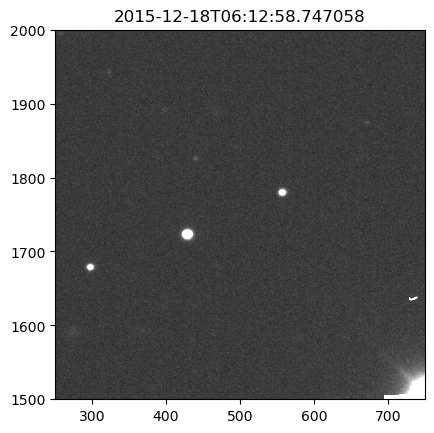

6e069b3ba2f921accc6c6bf54fbc8ea1_c4d_151218_061457_ooi_g_v1.fits.fz 34


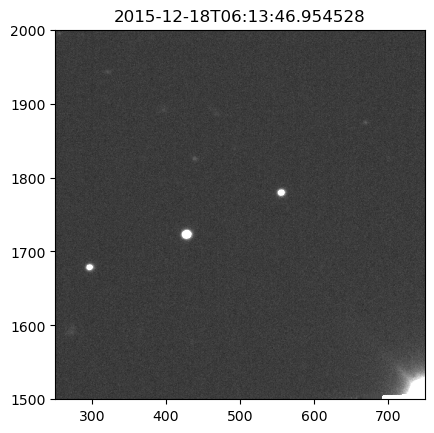

a537628670f94cbad17844c8821ca0df_c4d_151218_061546_ooi_g_v1.fits.fz 35


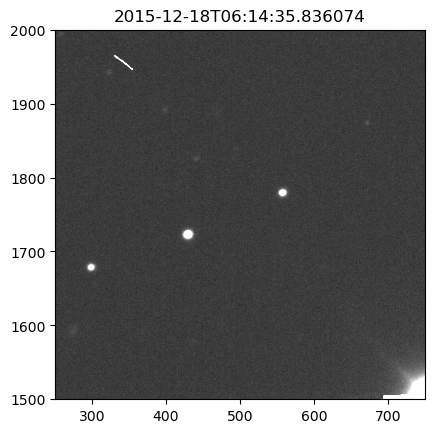

78072e64a2f620c81605bd60cbd54982_c4d_151218_061632_ooi_g_v1.fits.fz 36


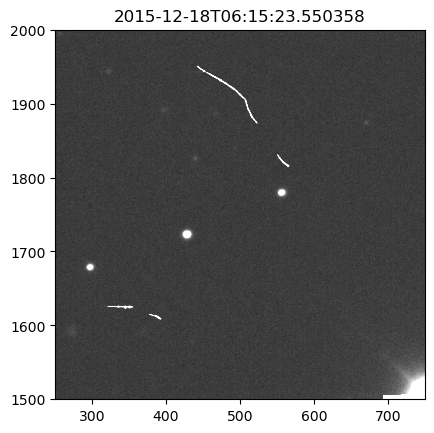

17dc442bf455de4ea83d3ccad3a9e54f_c4d_151218_061719_ooi_g_v1.fits.fz 37


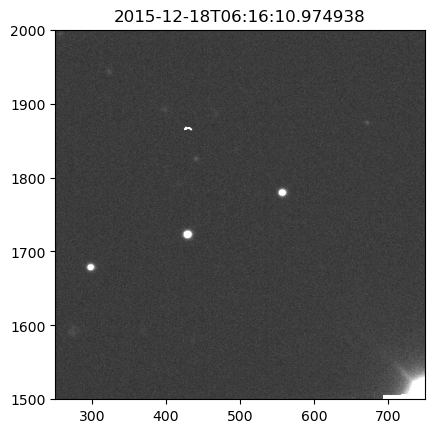

0a7936112f3150350b27277900f88de2_c4d_151218_061807_ooi_g_v1.fits.fz 38


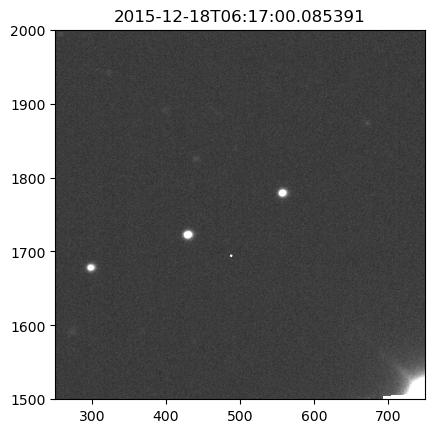

c924e401218b4ed9c25e2a55bf0bbedd_c4d_151218_061858_ooi_g_v1.fits.fz 39


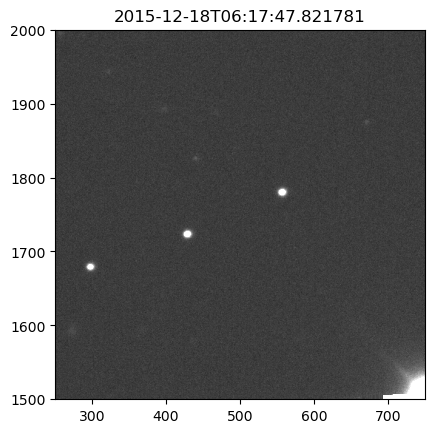

In [873]:
for i, imname in enumerate(imnames_timeordered[:40]):

    image_data = fits.getdata(ROOTDIR + '/dwfflare/' + imname, ext=16)
    image_header = fits.getheader(ROOTDIR + '/dwfflare/' + imname, ext=0)

    plt.imshow(np.rot90(image_data), cmap='gray', clim=(0,100))
    plt.title(image_header['DATE-OBS'])
    print(imname, i)
    plt.gca().invert_yaxis()
    #plt.gca().invert_xaxis()
    plt.xlim(250,750)
    plt.ylim(1500,2000)
    plt.show()

# SAVE FITS FILES FOR EXT 16 ONLY

In [874]:
def makefitsfromext(file, ext, outdir):
    hdu_list = fits.open(file)
    data = hdu_list[ext].data
    header = hdu_list[ext].header

    hdr = header
    hdr['DATE-OBS'] = hdu_list[0].header['DATE-OBS']

    empty_primary = fits.PrimaryHDU(header=hdr)

    image_hdu = fits.ImageHDU(data)

    hdul = fits.HDUList([empty_primary, image_hdu])

    hdul.writeto(outdir, overwrite=True)

In [875]:
times = []

for imname in imnames_timeordered:
    imname = imname[:-8] + '_S18' + imname[-8:]
    file = 'dwfflare/dwfflareS18/' + imname 
    header = fits.getheader('dwfflare/dwfflareS18/' + imname)
    time = Time(header['DATE-OBS'])
    times.append(time)

len(times)

74

Img 0


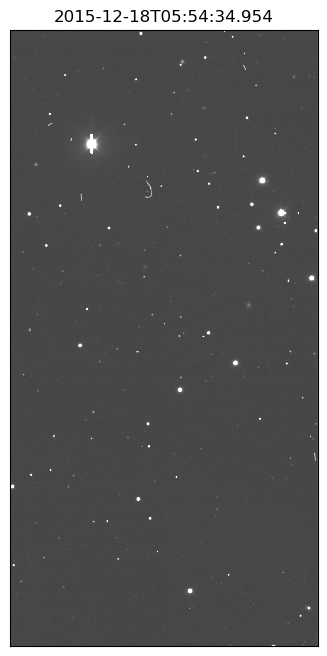

Img 1


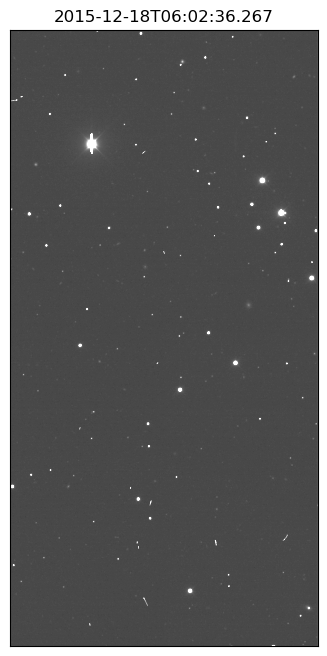

Img 2


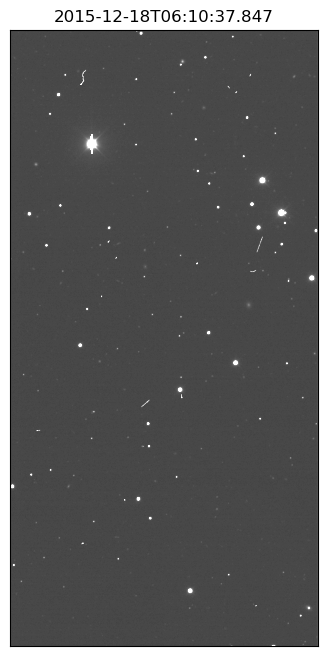

Img 3


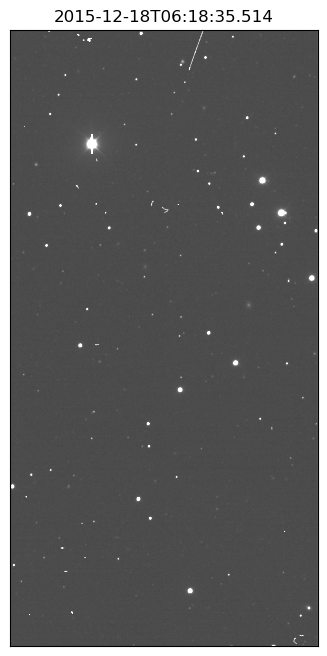

Img 4


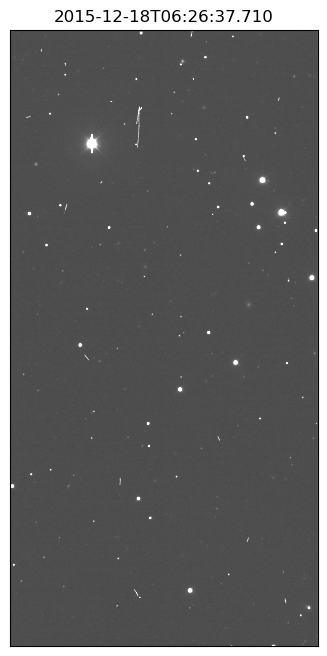

In [878]:
#Look at first 10 imgs
for i, imname in enumerate(imnames_timeordered[10:60:10]):
    imname = imname[:-8] + '_S18' + imname[-8:]
    file = 'dwfflare/dwfflareS18/' + imname 
    data = fits.getdata('dwfflare/dwfflareS18/' + imname)
    header = fits.getheader('dwfflare/dwfflareS18/' + imname)
    wcs = WCS(header)
    time = Time(header['DATE-OBS'])

    print('Img {}'.format(i))
    plt.figure(figsize=(16,8))
    plt.imshow(data, cmap='Greys_r', clim=(0,100))
    plt.title('{}'.format(time))
    plt.xticks([])
    plt.yticks([])
    plt.show()

# Check we understand the sky orientation

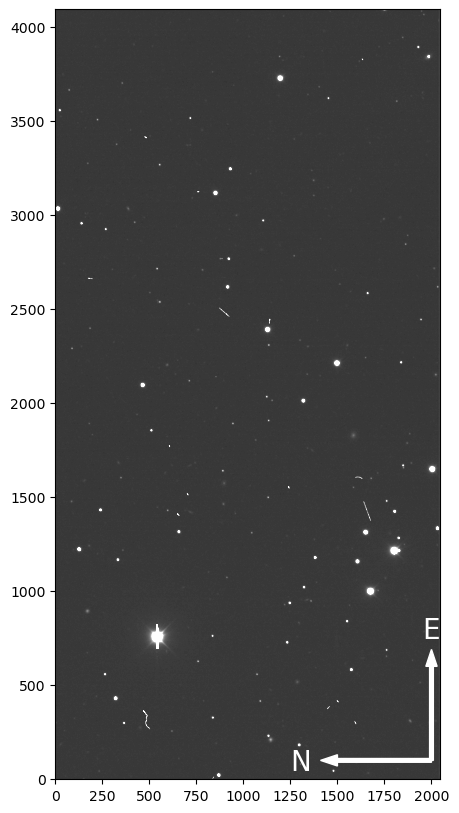

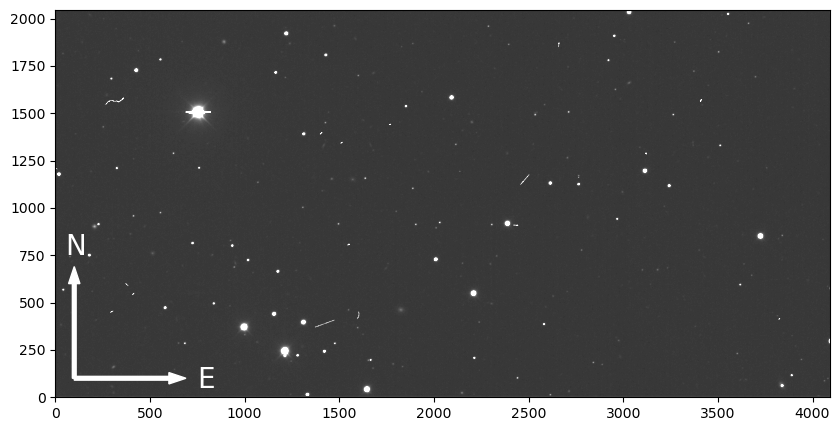

In [879]:
from scipy.ndimage import rotate

name = '489f990fd94eb9cff4b14219e98b6bde_c4d_151218_061146_ooi_g_v1_S18.fits.fz'
file = ROOTDIR + '/dwfflare/dwfflareS18/' + name

flare_data = fits.getdata(ROOTDIR + '/dwfflare/dwfflareS18/' + name)
flare_header = fits.getheader(ROOTDIR + '/dwfflare/dwfflareS18/' + name)

fig = plt.figure(figsize=(10,10))
ax = plt.subplot()
ax.imshow(rotate(flare_data, angle=0), cmap='gray', clim=(0,100), origin='lower')
ax.arrow(x=2000, y=100, dx=0, dy=500, color='white', width=20)
ax.annotate("E", xy=(1950, 750), c='white', fontsize=20)

ax.arrow(x=2000, y=100, dx=-500, dy=0, color='white', width=20)
ax.annotate("N", xy=(1250, 50), c='white', fontsize=20)
fig.show()

fig = plt.figure(figsize=(10,10))
ax = plt.subplot()
ax.imshow(rotate(flare_data, angle=90), cmap='gray', clim=(0,100), origin='lower')
ax.arrow(x=100, y=100, dx=0, dy=500, color='white', width=20)
ax.annotate("N", xy=(50, 750), c='white', fontsize=20)

ax.arrow(x=100, y=100, dx=500, dy=0, color='white', width=20)
ax.annotate("E", xy=(750, 50), c='white', fontsize=20)
fig.show()

## PSF Fitting

## testing from image ingestion to star finding to Gaussian PSF on a single image

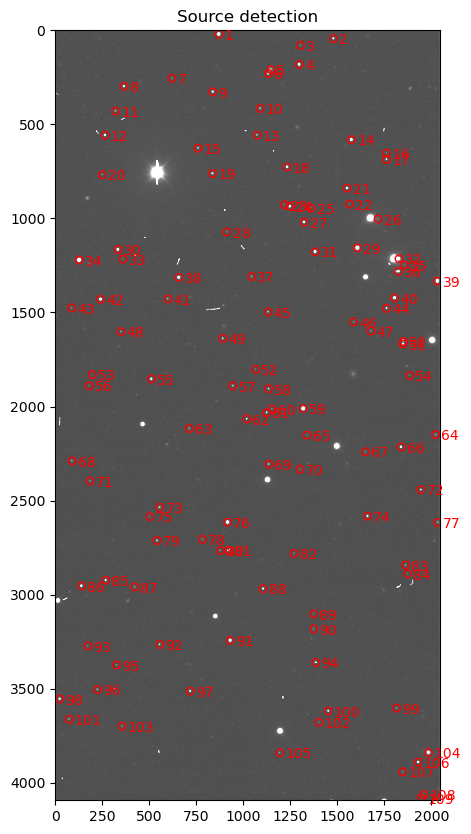

id,group_id,group_size,local_bkg,x_init,y_init,flux_init,x_fit,y_fit,flux_fit,x_err,y_err,flux_err,npixfit,qfit,cfit,flags
int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,int64
1,1,1,40.40919498665622,869.5739732526622,20.495276318332902,97440.12528908624,869.5696647475112,20.659653254374124,180829.35863408016,0.2774938435938347,0.27760573472787387,6671.2525506411,625,0.7807487334625651,0.012770805849908189,0
2,2,1,27.236731075710722,1478.852823066237,43.85627305499278,9496.593029894553,1478.8004603765937,43.97823162395786,14004.73700381945,0.294647284688172,0.2946013076419989,548.6841043253556,625,0.8330831923620086,0.014500821178357506,0
3,3,1,25.50950910291101,1304.2156505573394,79.32534761267652,3053.2589625515525,1303.9784280913595,79.55109223450762,1951.8496023562086,0.37376695000846316,0.37389341268107584,97.00712265924322,625,1.169239306042987,0.014983744725179332,0
4,4,1,29.199687254081653,1296.818401274623,181.28963829034686,32363.423889677037,1296.7948585573586,181.41563537179172,57752.37869350994,0.28382196467830373,0.28386333336641323,2179.552129366366,625,0.7870428889712338,0.013655935130722888,0
5,5,1,45.248244579331285,1145.2961244960914,209.3959469806366,5295.355501872485,1145.114524529873,209.82726144921068,2971.088776982483,0.5523488252772065,0.5528565592064312,218.2091463420989,625,2.13440415056377,0.00875295213937798,0
6,6,1,29.57187420714135,1133.3208999495037,229.9744879824448,14519.354513616452,1133.3412876837185,230.06083903209264,23120.753770903964,0.291846491500353,0.2917466488579866,897.0354137584509,625,0.8370473362069467,0.014187631414803184,0
7,7,1,26.00274153887215,620.1756210955302,255.27067160328303,3225.744759929811,620.1916112685913,255.3688699526021,2219.2953554840115,0.37350183083713656,0.3735456649375989,110.2180119047472,625,1.1337165909211926,0.015786230657563773,0
8,8,1,27.347665709764968,365.59558983311877,298.0222225853858,9801.925589817693,365.57447550596487,298.1589109119692,14571.45944447508,0.2930888283211171,0.2930337067060761,567.783567995094,625,0.832523697995793,0.013628585332939326,0
9,9,1,28.268826201626155,837.7215256616223,326.71214594092027,11296.146378182257,837.6188776993827,326.820484911755,17178.607442021494,0.29636571232951825,0.2963203566094219,676.8975549346931,625,0.8367646167088342,0.014550240517206806,0


In [987]:
imname = imnames[0]
imname = imname[:-8] + '_S18' + imname[-8:]
file = 'dwfflare/dwfflareS18/' + imname 
data = fits.getdata('dwfflare/dwfflareS18/' + imname)
header = fits.getheader('dwfflare/dwfflareS18/' + imname)
wcs = WCS(header)
time = Time(header['DATE-OBS'])

mmm_bkg = MMMBackground()
localbkg_estimator = LocalBackground(5, 10, mmm_bkg)

finder = DAOStarFinder(threshold=1*mmm_bkg(data), fwhm=header['FWHM'], 
                       roundlo=-0.5, roundhi=0.5, peakmax=10_000, exclude_border=True)
sources = finder(data)

positions = np.transpose((sources['xcentroid'], sources['ycentroid']))

xycoords = positions #we keep this as the golden list of stars for photometry
apertures = CircularAperture(positions, r=20.)

plt.figure(figsize=(20,10))
plt.imshow(data, clim=(0,100), cmap='Greys_r')
apertures.plot(color='red')

for i, p in enumerate(positions):
    plt.annotate('{0}'.format(sources['id'][i]), xy=p, xytext=p+30, color='r')
plt.title('Source detection')
plt.show()

psf_model = IntegratedGaussianPRF(sigma=header['FWHM'])
fit_shape = (25, 25)
psfphot = PSFPhotometry(psf_model, fit_shape, finder=finder, aperture_radius=5,
                        localbkg_estimator=localbkg_estimator)
phot = psfphot(data)


In [988]:
phot

id,group_id,group_size,local_bkg,x_init,y_init,flux_init,x_fit,y_fit,flux_fit,x_err,y_err,flux_err,npixfit,qfit,cfit,flags
int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,int64
1,1,1,40.40919498665622,869.5739732526622,20.495276318332902,97440.12528908624,869.5696647475112,20.659653254374124,180829.35863408016,0.2774938435938347,0.27760573472787387,6671.2525506411,625,0.7807487334625651,0.012770805849908189,0
2,2,1,27.236731075710722,1478.852823066237,43.85627305499278,9496.593029894553,1478.8004603765937,43.97823162395786,14004.73700381945,0.294647284688172,0.2946013076419989,548.6841043253556,625,0.8330831923620086,0.014500821178357506,0
3,3,1,25.50950910291101,1304.2156505573394,79.32534761267652,3053.2589625515525,1303.9784280913595,79.55109223450762,1951.8496023562086,0.37376695000846316,0.37389341268107584,97.00712265924322,625,1.169239306042987,0.014983744725179332,0
4,4,1,29.199687254081653,1296.818401274623,181.28963829034686,32363.423889677037,1296.7948585573586,181.41563537179172,57752.37869350994,0.28382196467830373,0.28386333336641323,2179.552129366366,625,0.7870428889712338,0.013655935130722888,0
5,5,1,45.248244579331285,1145.2961244960914,209.3959469806366,5295.355501872485,1145.114524529873,209.82726144921068,2971.088776982483,0.5523488252772065,0.5528565592064312,218.2091463420989,625,2.13440415056377,0.00875295213937798,0
6,6,1,29.57187420714135,1133.3208999495037,229.9744879824448,14519.354513616452,1133.3412876837185,230.06083903209264,23120.753770903964,0.291846491500353,0.2917466488579866,897.0354137584509,625,0.8370473362069467,0.014187631414803184,0
7,7,1,26.00274153887215,620.1756210955302,255.27067160328303,3225.744759929811,620.1916112685913,255.3688699526021,2219.2953554840115,0.37350183083713656,0.3735456649375989,110.2180119047472,625,1.1337165909211926,0.015786230657563773,0
8,8,1,27.347665709764968,365.59558983311877,298.0222225853858,9801.925589817693,365.57447550596487,298.1589109119692,14571.45944447508,0.2930888283211171,0.2930337067060761,567.783567995094,625,0.832523697995793,0.013628585332939326,0
9,9,1,28.268826201626155,837.7215256616223,326.71214594092027,11296.146378182257,837.6188776993827,326.820484911755,17178.607442021494,0.29636571232951825,0.2963203566094219,676.8975549346931,625,0.8367646167088342,0.014550240517206806,0


## testing a different PSF model" moffat

In [989]:

psf_model = MoffatPSF()

fit_shape = (25, 25)
psfphot = PSFPhotometry(psf_model, fit_shape, finder=finder, aperture_radius=5,
                        localbkg_estimator=localbkg_estimator)
phot = psfphot(data)
phot

id,group_id,group_size,local_bkg,x_init,y_init,flux_init,x_fit,y_fit,flux_fit,x_err,y_err,flux_err,npixfit,qfit,cfit,flags
int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,int64
1,1,1,40.40919498665622,869.5739732526622,20.495276318332902,97440.12528908624,869.5168220622955,20.486600116868303,30180.9076068305,0.0333555742471433,0.03278740146826608,1313.3667236469455,625,3.0455943492725206,-0.03705552993469143,0
2,2,1,27.236731075710722,1478.852823066237,43.85627305499278,9496.593029894553,1478.596662629047,43.53459001910754,2380.065433857985,0.037245506000852205,0.03262090639853282,104.60952770765572,625,3.288323227224955,-0.04856658513050429,0
3,3,1,25.50950910291101,1304.2156505573394,79.32534761267652,3053.2589625515525,1304.486110255049,79.4874830944703,351.13278863501836,0.03864516697964049,0.03791876205605629,17.670127905409256,625,6.003653579851636,-0.031798880635990796,0
4,4,1,29.199687254081653,1296.818401274623,181.28963829034686,32363.423889677037,1296.5599753677068,181.46648243890007,9734.156644261962,0.034883193970555344,0.03252425336161571,422.6321221375051,625,2.9935408556007386,-0.04521169201461881,0
5,5,1,45.248244579331285,1145.2961244960914,209.3959469806366,5295.355501872485,1145.4324781009784,209.50509615390808,391.1112739347049,0.08209329677403675,0.08054534834264346,42.22343039847426,625,16.73571862380345,-0.043905844837850205,0
6,6,1,29.57187420714135,1133.3208999495037,229.9744879824448,14519.354513616452,1133.4750806636803,229.55964014635114,3905.3973442024603,0.03349803299048274,0.03403163427515117,173.22898886599586,625,3.294313544902284,-0.04036984925485716,0
7,7,1,26.00274153887215,620.1756210955302,255.27067160328303,3225.744759929811,620.4740650299406,255.43408730013613,416.428625918574,0.034905891974661325,0.03555427450277792,19.451332181794665,625,5.202708696576847,-0.04505792889108805,0
8,8,1,27.347665709764968,365.59558983311877,298.0222225853858,9801.925589817693,365.516581937337,298.42987205326375,2471.284069236553,0.03304724072517585,0.033682530655092774,109.14099336445062,625,3.343871812491742,-0.04444507200732588,0
9,9,1,28.268826201626155,837.7215256616223,326.71214594092027,11296.146378182257,837.5639873116353,326.5343295702841,2975.7482192454017,0.033729718022935506,0.03232737932501589,127.64648597075468,625,3.1998331017076866,-0.04409190051867345,0


## testing Empirical PSF model

In [1342]:
from defs import makefitpsf

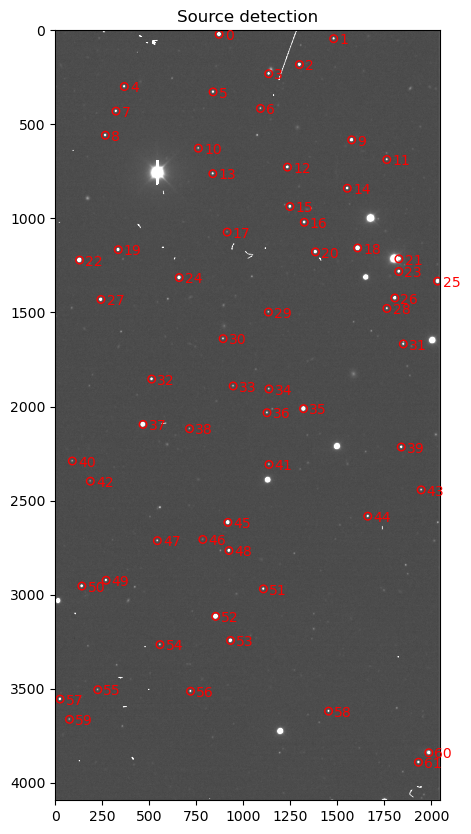

<Figure size 640x480 with 0 Axes>

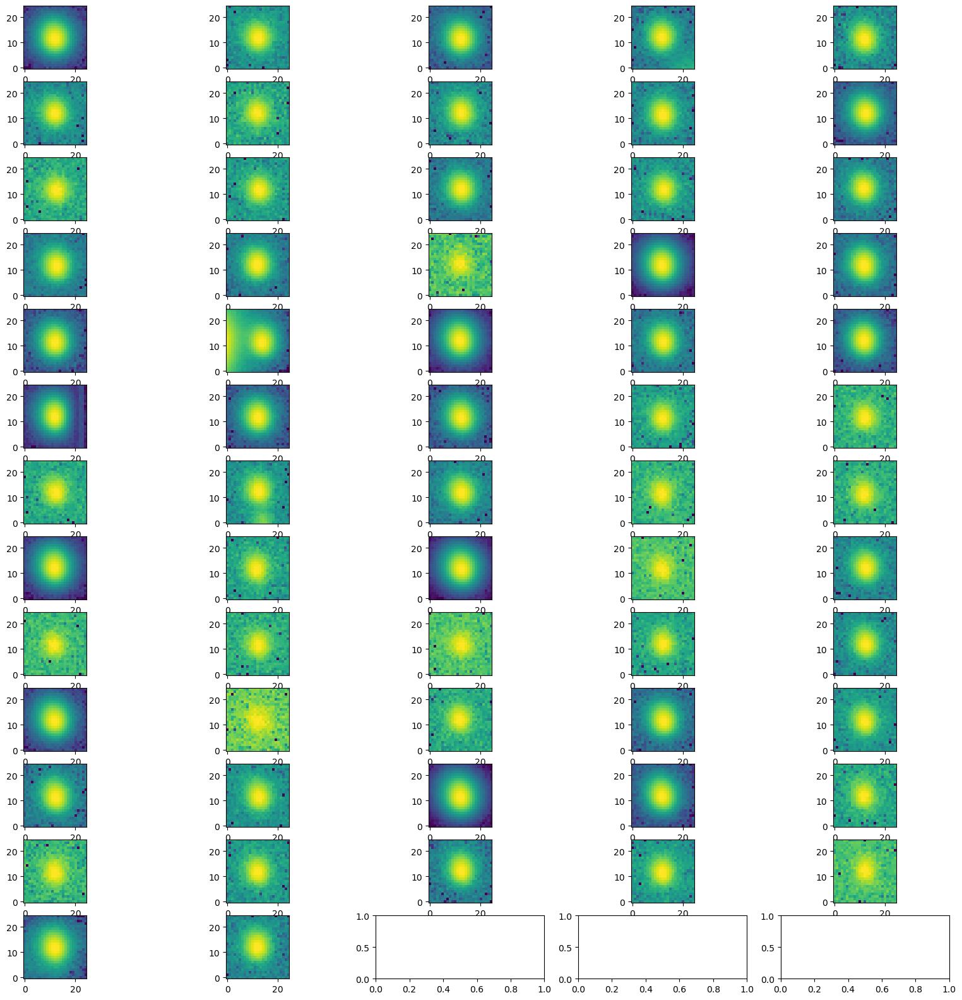

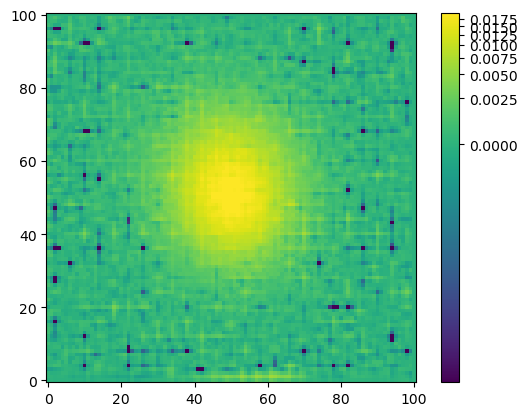

<ImagePSF(flux=1., x_0=0., y_0=0.)>

In [1032]:
imname = imnames_timeordered[40]
imname = imname[:-8] + '_S18' + imname[-8:]
file = 'dwfflare/dwfflareS18/' + imname 
data = fits.getdata('dwfflare/dwfflareS18/' + imname)
header = fits.getheader('dwfflare/dwfflareS18/' + imname)
wcs = WCS(header)
time = Time(header['DATE-OBS'])
makefitpsf(data, header, plot=True)

### which function fits our PSF based on image 40? Gaussian or Moffat

In [1114]:
 Moffat2D.evaluate?

Signature: Moffat2D.evaluate(x, y, amplitude, x_0, y_0, gamma, alpha)
Docstring: Two dimensional Moffat model function.
File:      /opt/anaconda3/lib/python3.11/site-packages/astropy/modeling/functional_models.py
Type:      function

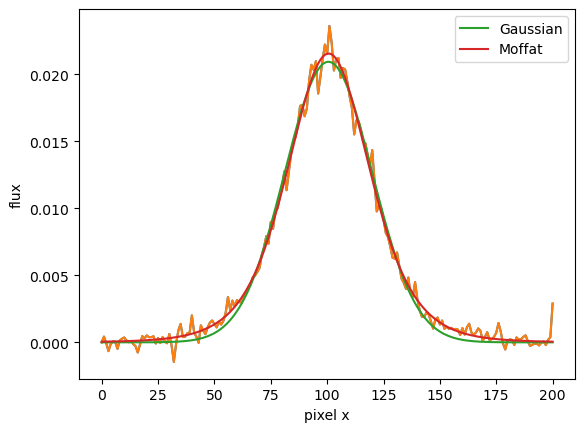

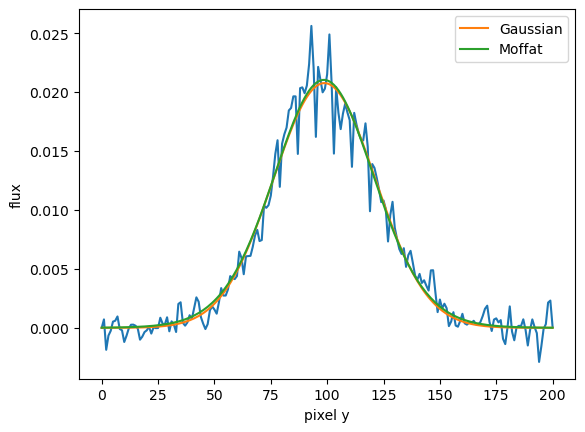

In [1135]:
import sys
from  scipy.optimize import minimize

plt.plot(epsf.data[100,:])
def dg(pars, x, truth):
    return ((g(pars, x) - truth)**2).sum()
def dm(pars, x, truth):
    return ((mf(pars, x) - truth)**2).sum()

def g(pars, x):
    mu, sig, a = pars
    return np.exp(-(x-mu)**2/2/sig**2)/a
def mf(pars, x):
    amplitude, mux, gamma, alpha = pars
    #print(pars)
    #plt.plot(Moffat2D.evaluate(x, 100, amplitude=amplitude, x_0=mux, y_0=100, gamma=gamma, alpha=alpha))
    return Moffat2D.evaluate(x, 100, amplitude=amplitude, x_0=mux, y_0=100, gamma=gamma, alpha=alpha)

x = np.arange(201)

truth = epsf.data[100,:]
plt.plot(truth)

pars0 = 100, 25, 25
pars = minimize(dg, pars0, args=(x, truth)).x
plt.plot(g(pars, x), label="Gaussian")

pars0 = 0.022, 100, 22, 1
pars = minimize(dm, pars0, args=(x, truth)).x
plt.plot(mf(pars, x), label="Moffat")
plt.ylabel("flux")
plt.xlabel("pixel x")
plt.legend()
plt.show()

truth = epsf.data[:,100]
plt.plot(truth)
pars0 = 100, 25, 25
pars = minimize(dg, pars0, args=(x, truth)).x
plt.plot(g(pars, x), label="Gaussian")

pars0 = 0.022, 100, 22, 1
pars = minimize(dm, pars0, args=(x, truth)).x
plt.plot(mf(pars, x), label="Moffat")
plt.ylabel("flux")
plt.xlabel("pixel y")
plt.legend()
plt.show()

## PSF Fitting Across Multiple Images

In [1307]:

print(f"Nimages: {end - start}")

Nimages: 74


In [ ]:
# testing on a few images with set parameters
psffittests(epsf,
    #IntegratedGaussianPRF(sigma=header['FWHM']), 
     1, 2, roundlo, roundhi, 
     peakmax, minsep, np.hstack([imnames_timeordered[start:start+1], imnames_timeordered[start+1:end:1]]))


### hyperparameter search for PSF fitting (any method)

0
Seeing: 1.1867006304 arcsec
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 104
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 104
build PSF model


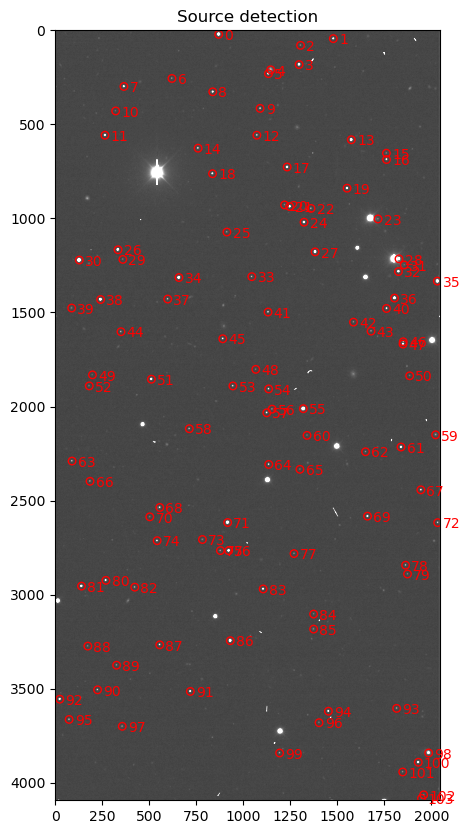

<Figure size 640x480 with 0 Axes>

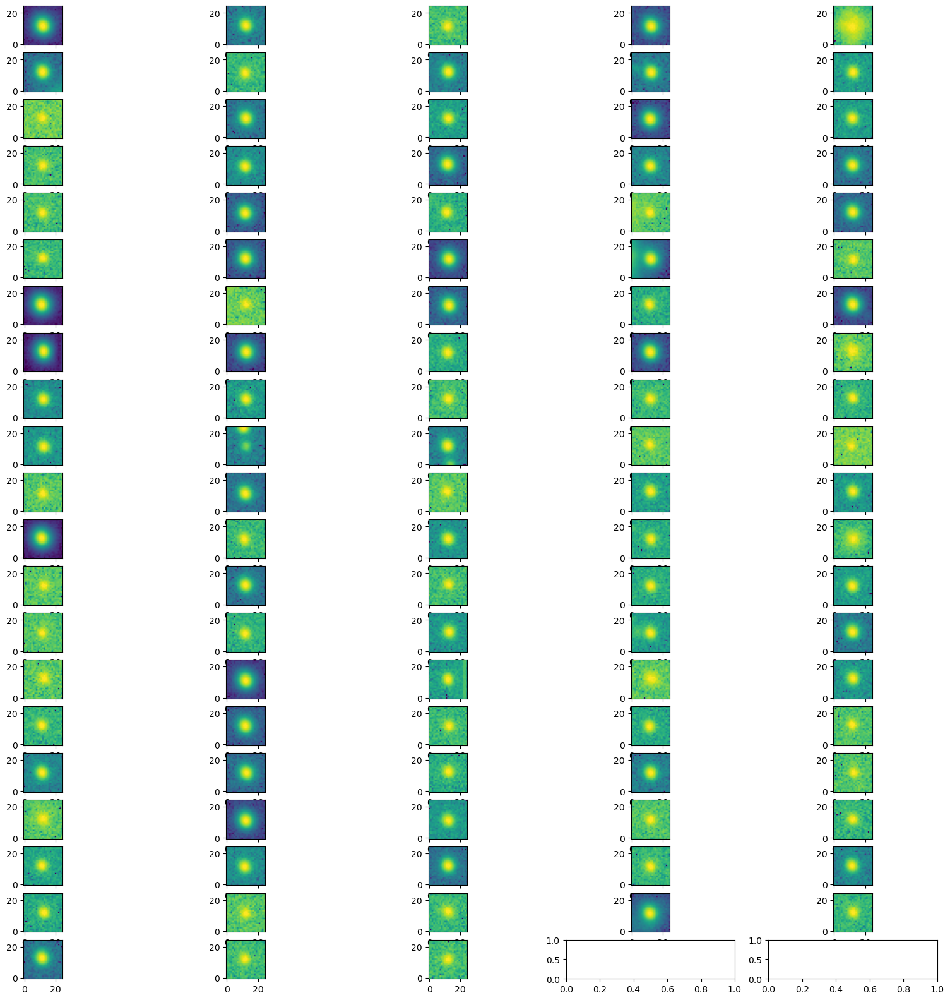

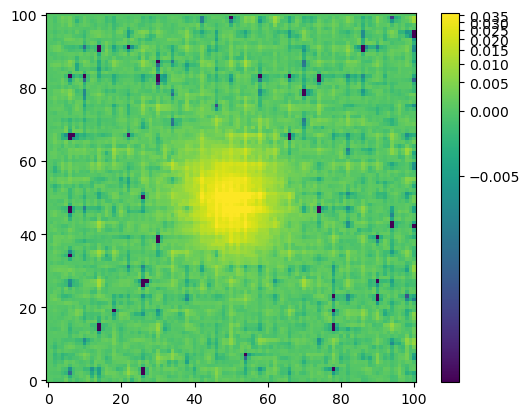

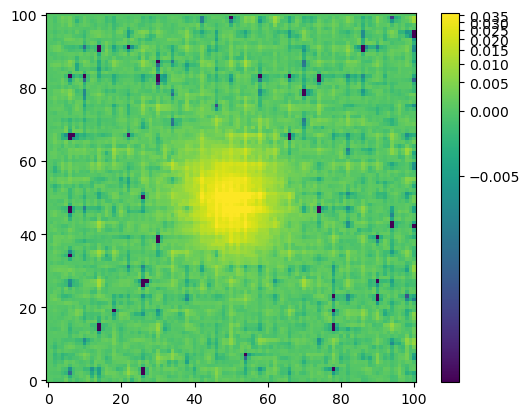

1
Seeing: 1.2884872482 arcsec
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 102
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 102
build PSF model


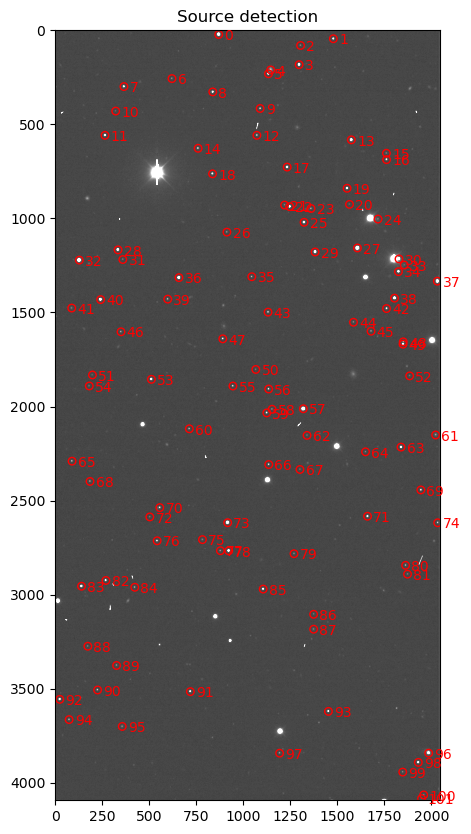

<Figure size 640x480 with 0 Axes>

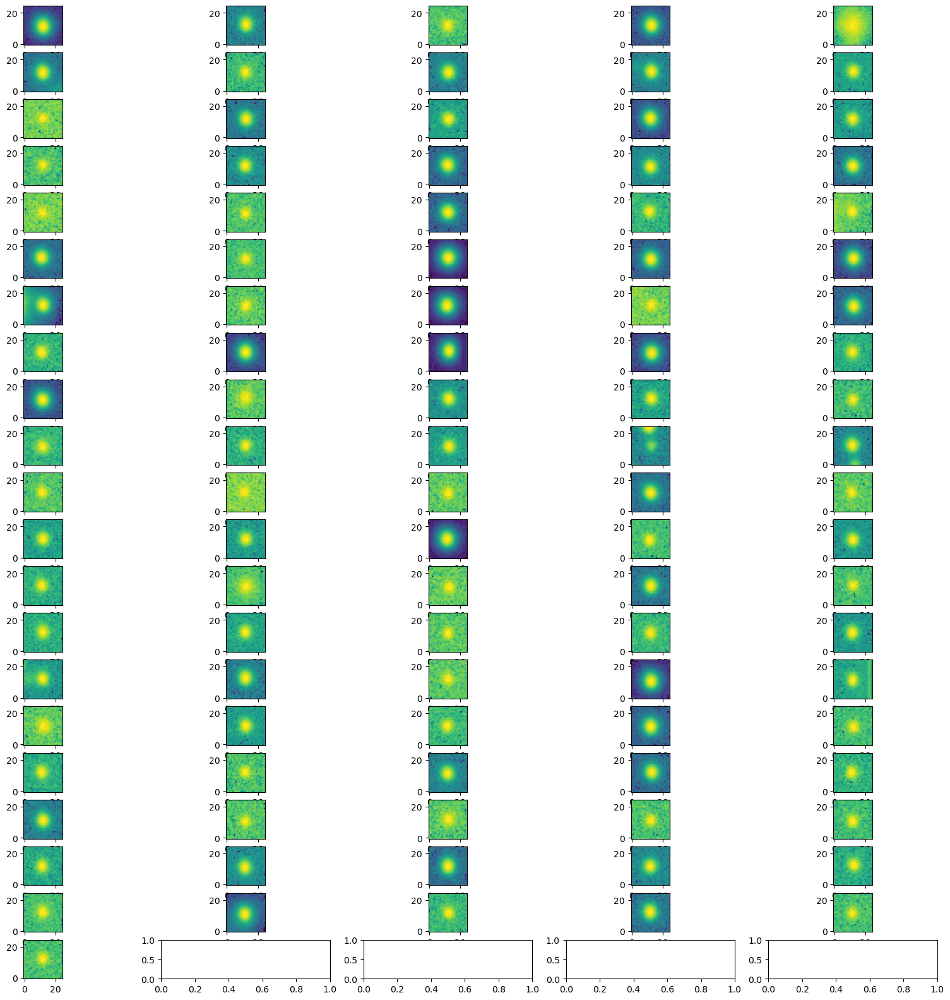

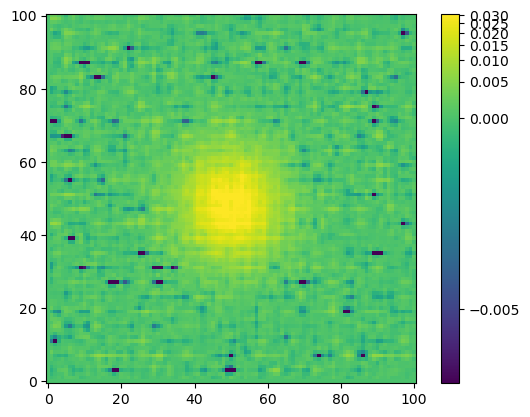

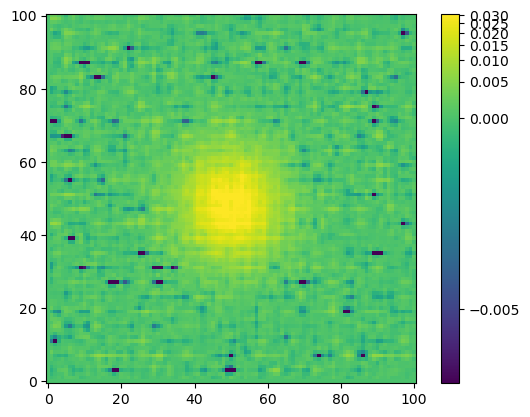

photometry sources 102
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
matchescount 99, 0
celest finder chart, black photometry output, blue matched output


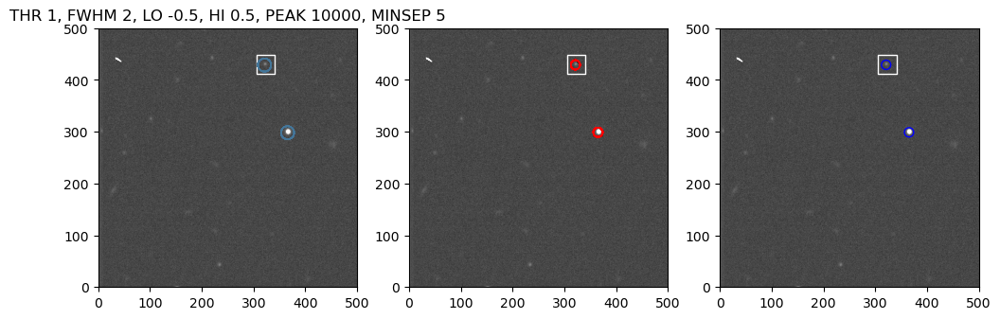

2
Seeing: 1.3968415782 arcsec
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 106
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 106
build PSF model


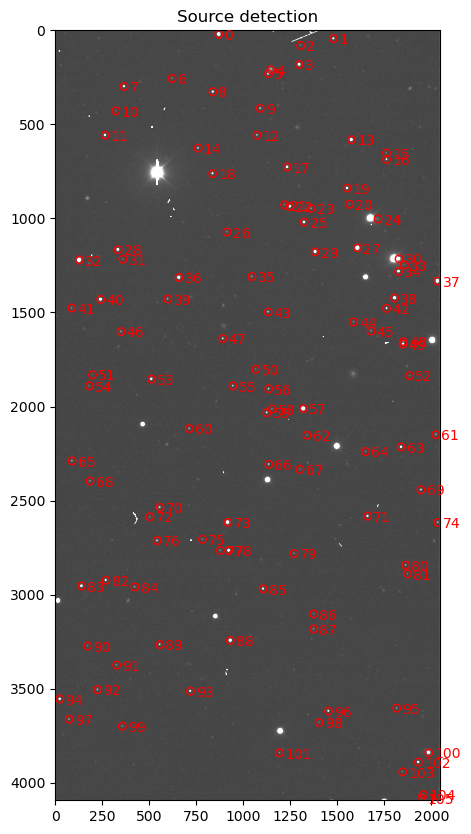

<Figure size 640x480 with 0 Axes>

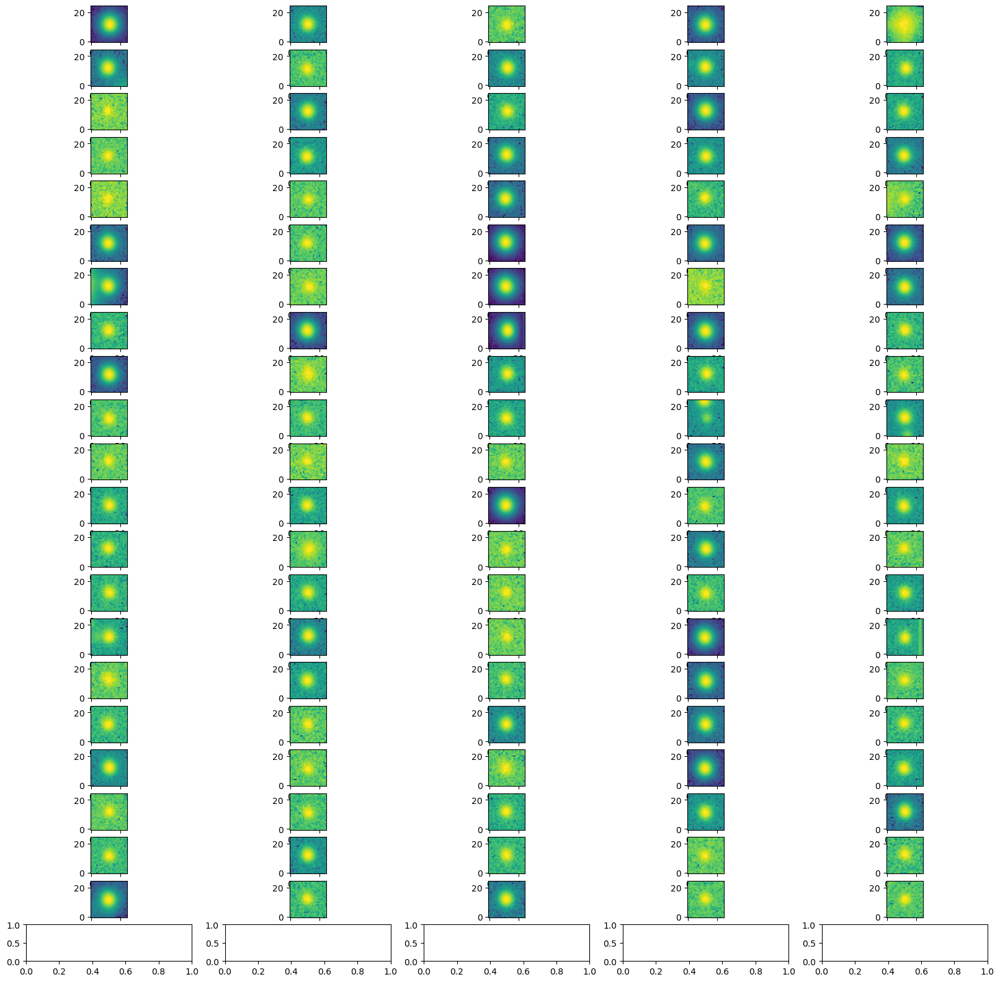

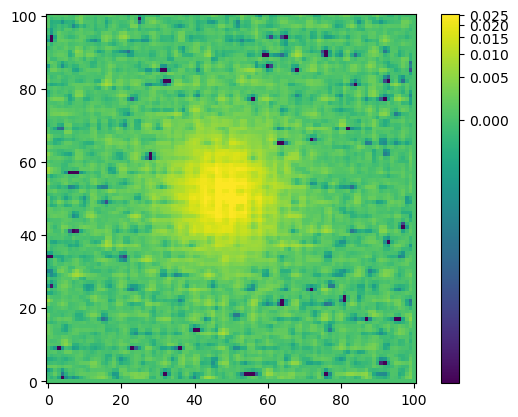

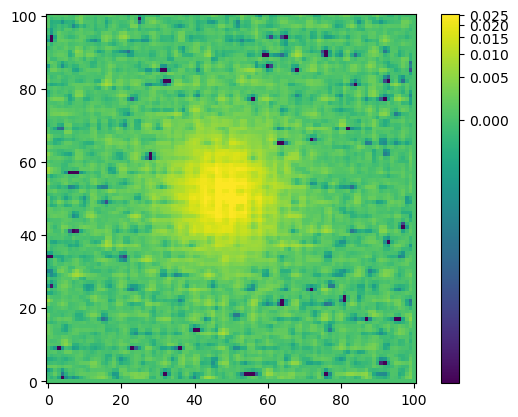

photometry sources 106
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
matchescount 102, 0
celest finder chart, black photometry output, blue matched output


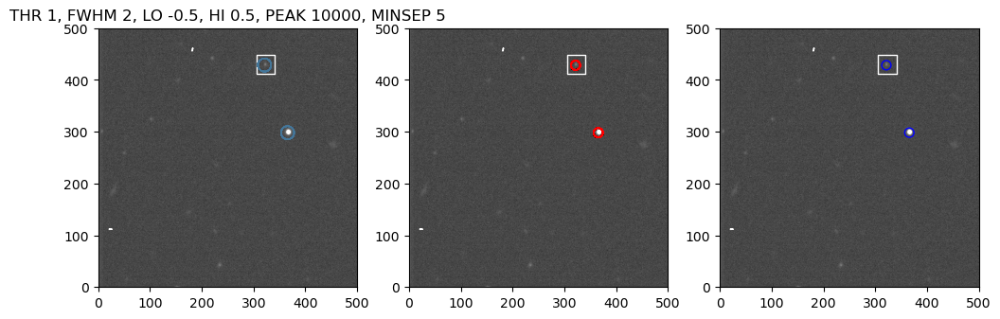

3
Seeing: 1.5879713382 arcsec
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 106
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 106
build PSF model


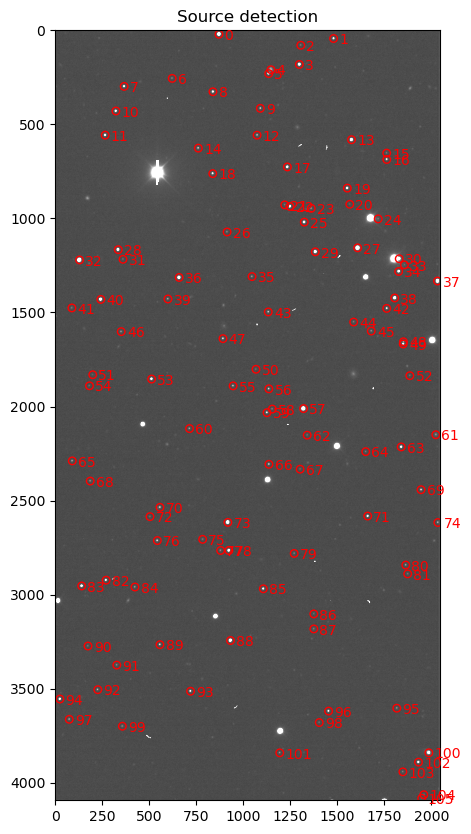

<Figure size 640x480 with 0 Axes>

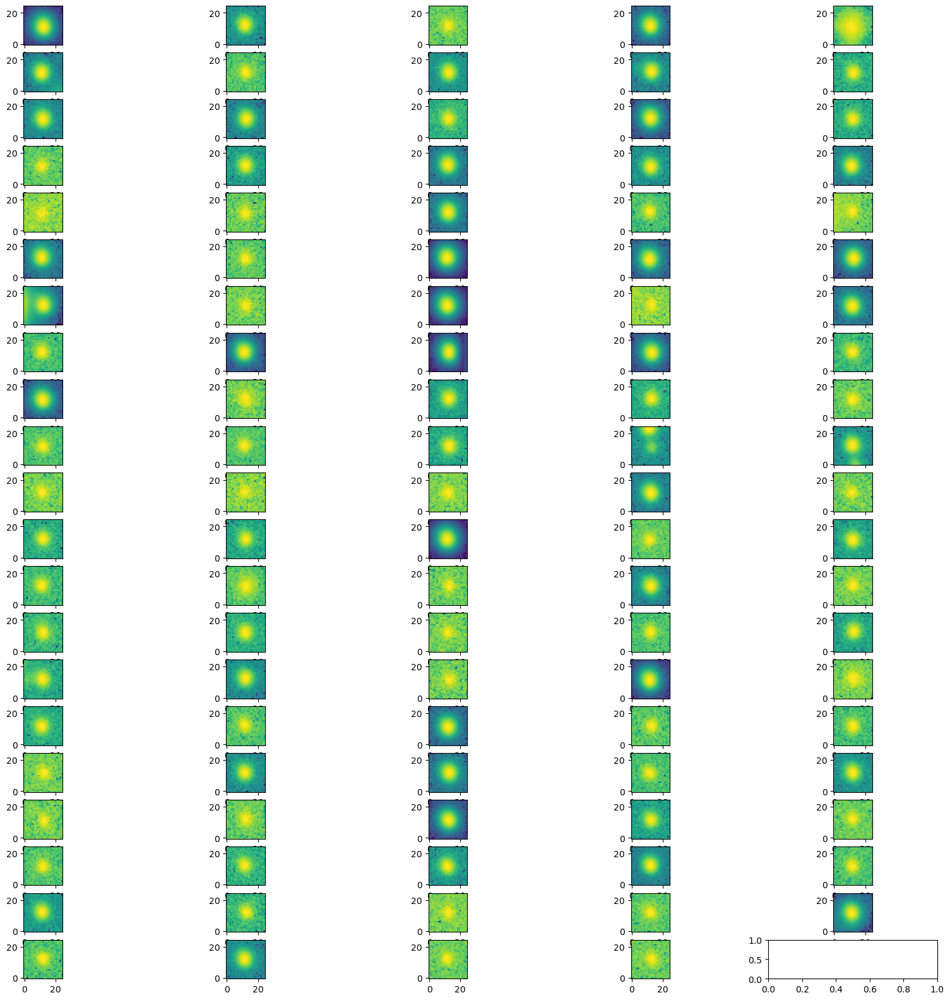

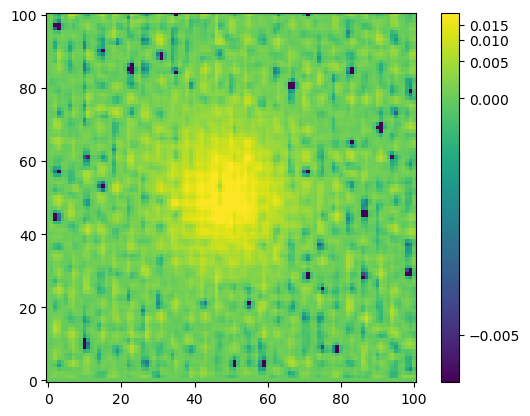

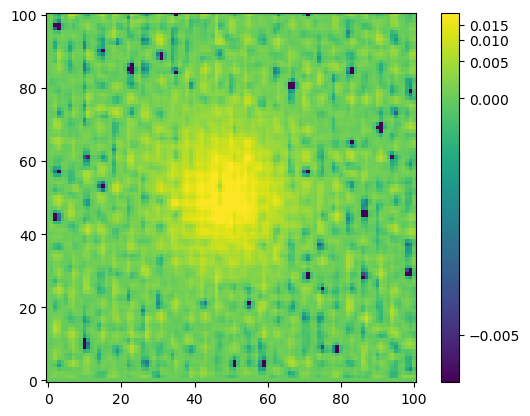

photometry sources 106
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
matchescount 100, 0
celest finder chart, black photometry output, blue matched output


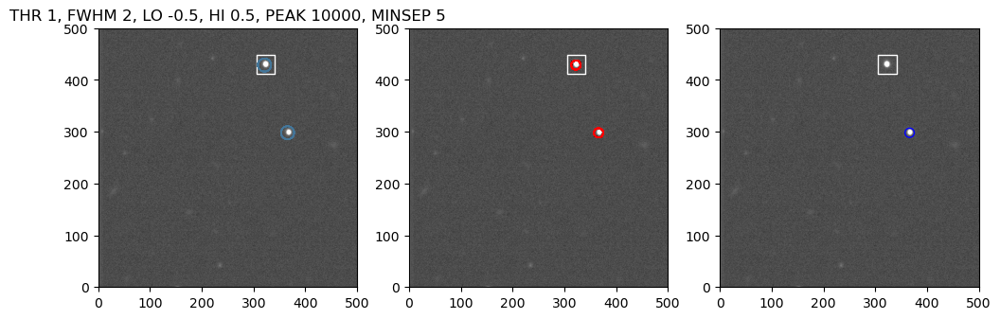

4
Seeing: 1.339820145 arcsec
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 106
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 106
build PSF model


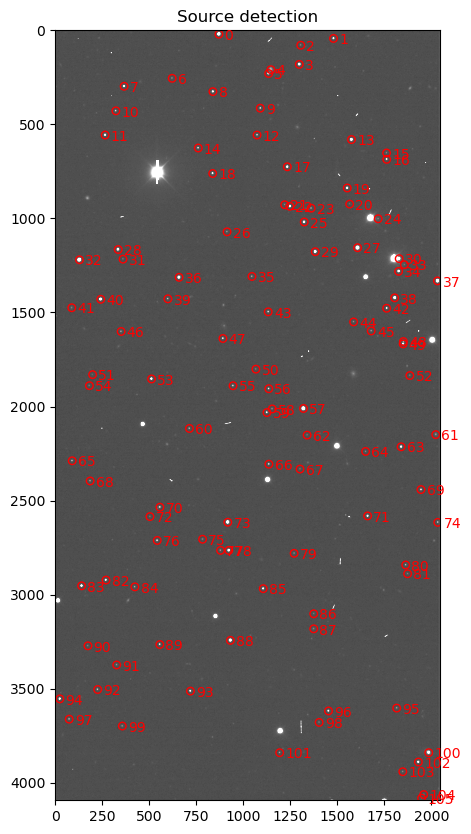

<Figure size 640x480 with 0 Axes>

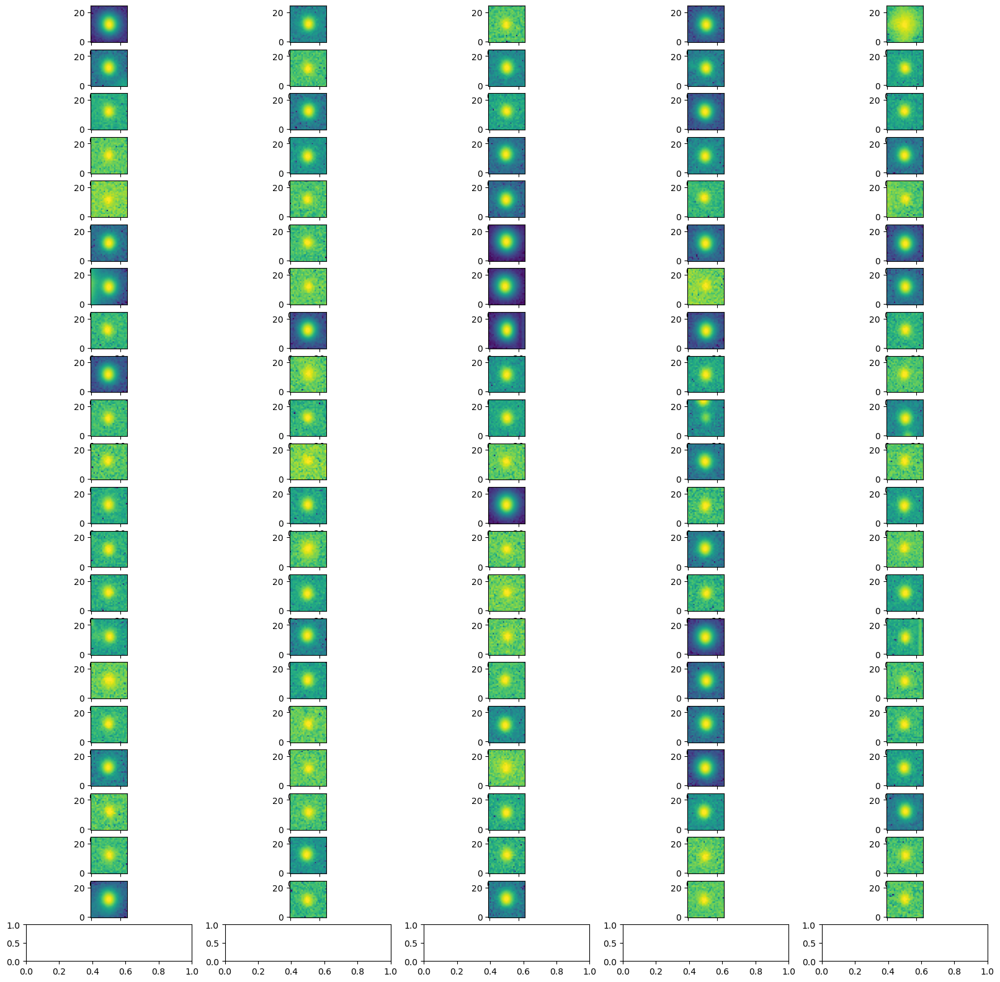

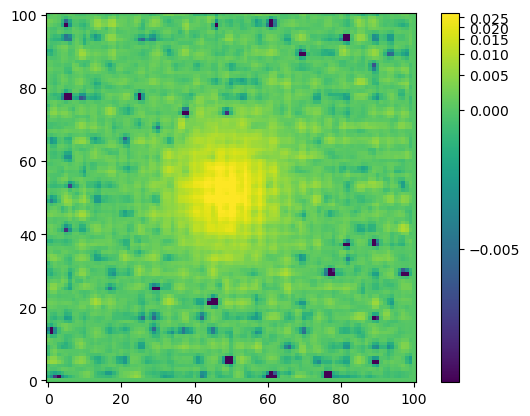

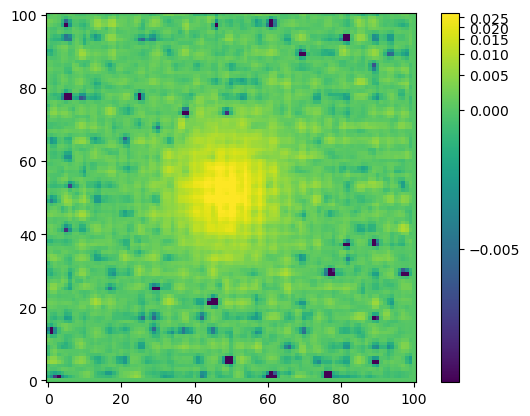

photometry sources 106
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
matchescount 103, 0
celest finder chart, black photometry output, blue matched output


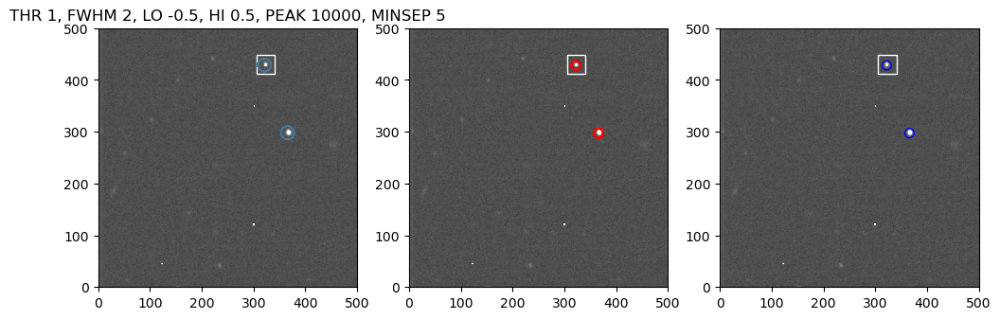

5
Seeing: 1.4041982808 arcsec
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
redoing daophot
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 86
build PSF model


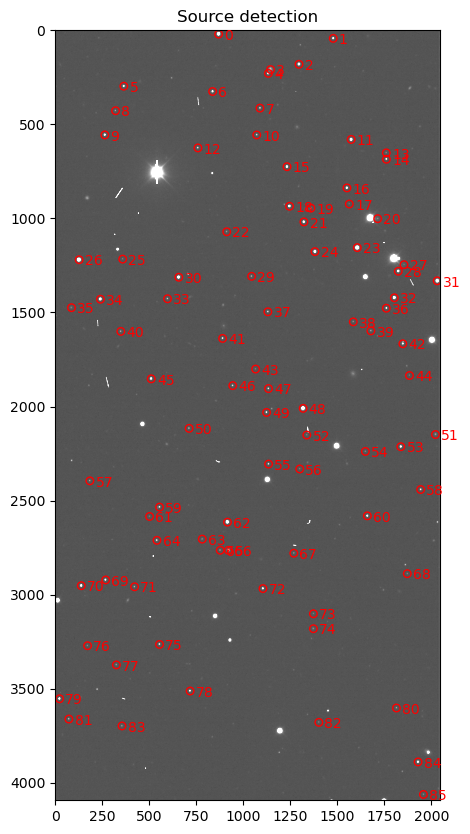

<Figure size 640x480 with 0 Axes>

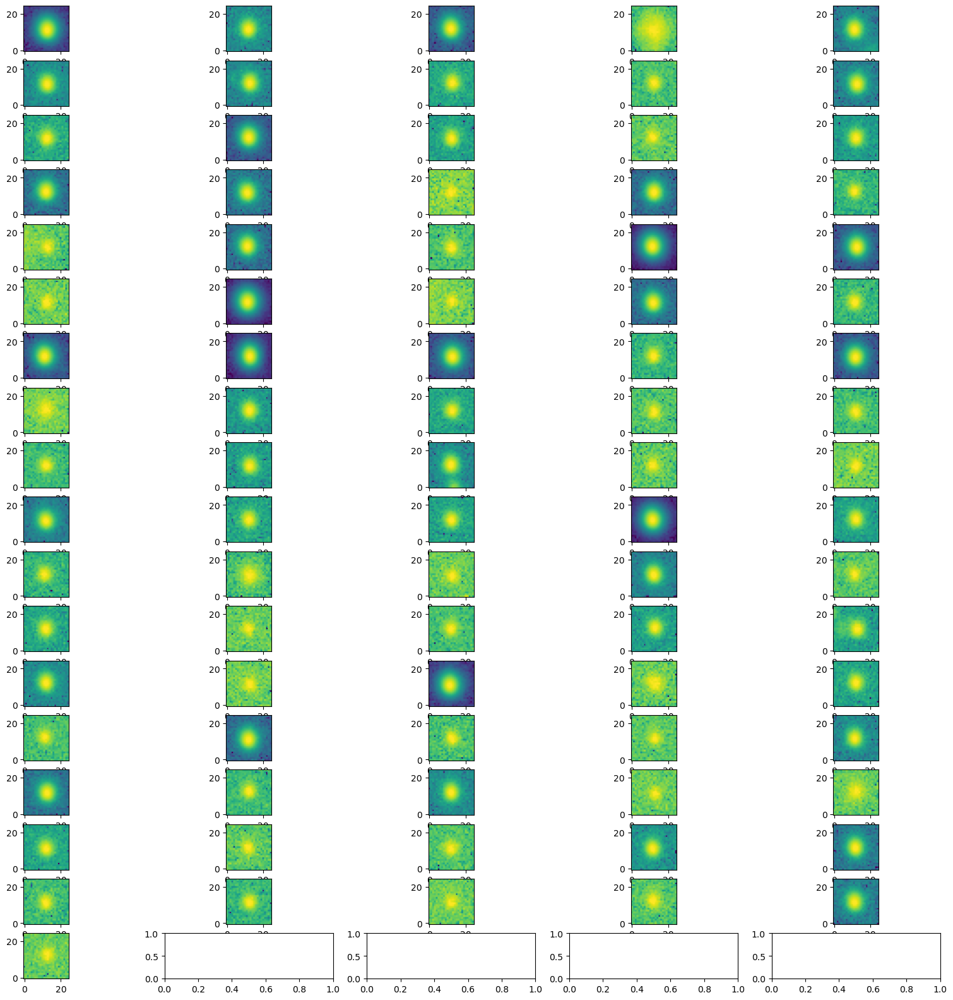

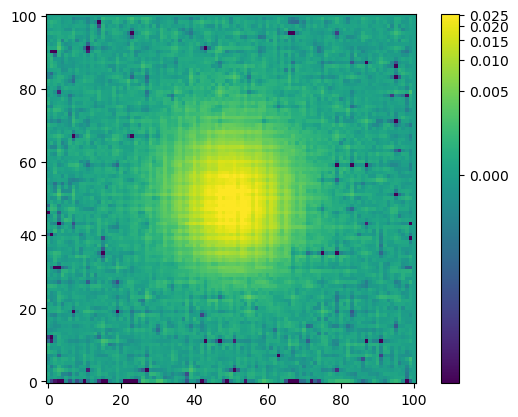

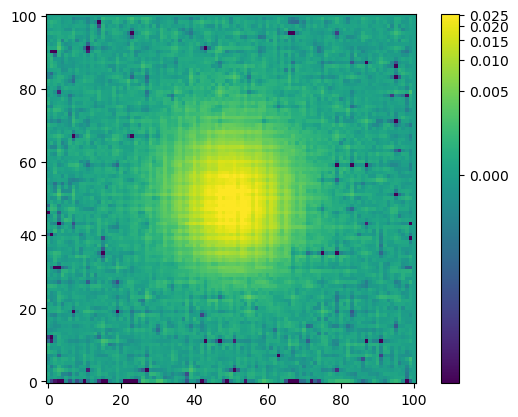

redoing psphot
photometry sources 86
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
matchescount 83, 0
celest finder chart, black photometry output, blue matched output


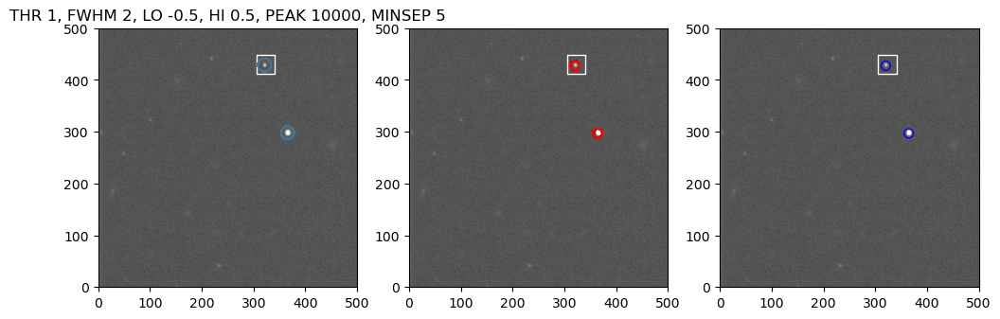

In [1035]:
thresholds = [1]#np.linspace(0.1,3,10)
fwhms = [2]#0.1, 0.2, 0.3]#np.linspace(0.5,2,3)
roundlos = [-0.5]#np.linspace(-4,0,3)
roundhis = [0.5]#np.linspace(0,4,5)
peakmaxs = [10_000]#np.linspace(1000,100_000,10)
minseps = [5]#np.linspace(2,20,10)
imgsize = 500
step=1
imgs = np.hstack([imnames_timeordered[start:start+1], imnames_timeordered[start+1:end:15]])
#xycoords = xycoords[(xycoords[:,0] < imgsize) * (xycoords[:,1] < imgsize)]
plot=True
for threshold in thresholds:
    for fwhm in fwhms:
        for roundlo in roundlos:
            for roundhi in roundhis:
               for peakmax in peakmaxs:
                   for minsep in minseps:#, roundhi, peakmax, minsep in zip(thresholds, fwhms, roundlos, 
                                                             #          roundhis, peakmaxs, minseps):
                        
                        fwhms, nsources,  matchescounts ,matched_flare_phot, matched_flare, bgs = psffittests(#MoffatPSF(),
                                                                    #IntegratedGaussianPRF(sigma=header['FWHM']),
                                                                                                  None,
                                                                                                  threshold, fwhm, 
                                                                                                  roundlo, roundhi, 
                                                                                                  peakmax, minsep, 
                                                                                                  imgs, sharplo=0.2,
                                                                                                 shaprhi=1)

0
Seeing: 1.1867006304 arcsec
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 104
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 104
1
Seeing: 1.2378600126 arcsec
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
matchescount 103, 0
celest finder chart, black photometry output, blue matched output


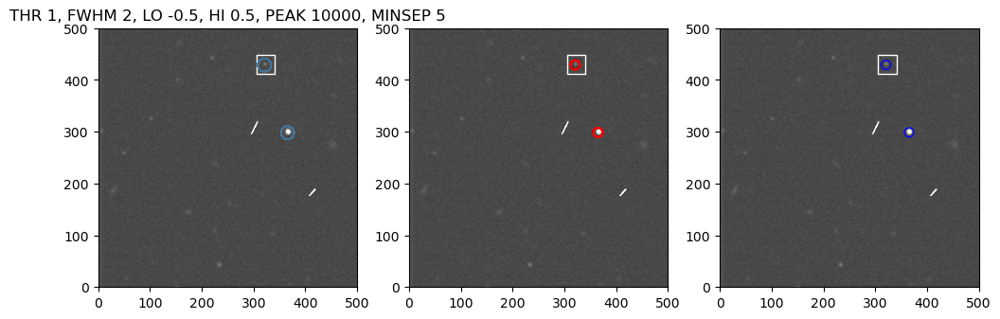

([1.1867006304, 1.2378600126],
 [104, 104, 105, 105],
 [0, 103],
 [0, 1],
 [0, 1, 0, 1],
 [21.881399154663086, 22.470571517944336])

In [1036]:
#test on problematic images
imgs = np.hstack([imnames_timeordered[start:start+1], imnames_timeordered[start+4:start+5]])
psffittests(IntegratedGaussianPRF(sigma=header['FWHM']), 1, 2, roundlo, roundhi, peakmax, minsep, imgs)
                                                                                                

# test if success may depend on FWHM or BG noise - correlations

In [829]:
np.array(matched_flare_phot) == 0

array([ True, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False,  True, False, False, False, False,
       False, False, False, False, False,  True,  True,  True, False,
       False, False, False,  True])

In [830]:
np.array(matched_flare) == 0

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,  True, False, False,
       False, False, False,  True])

In [831]:
(np.array(matched_flare) == 0) * (np.array(matched_flare_phot) == 0)

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,  True, False, False,
       False, False, False,  True])

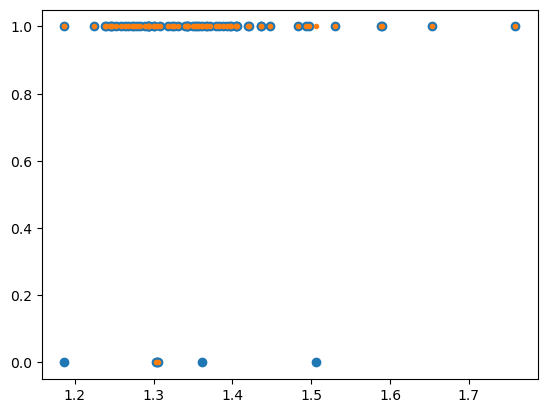

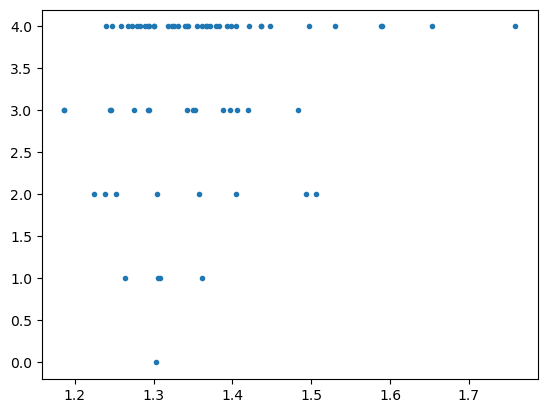

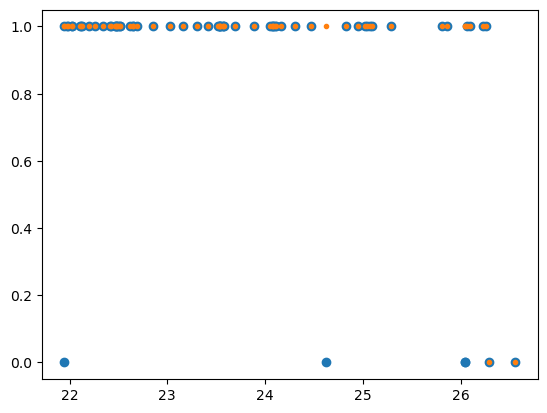

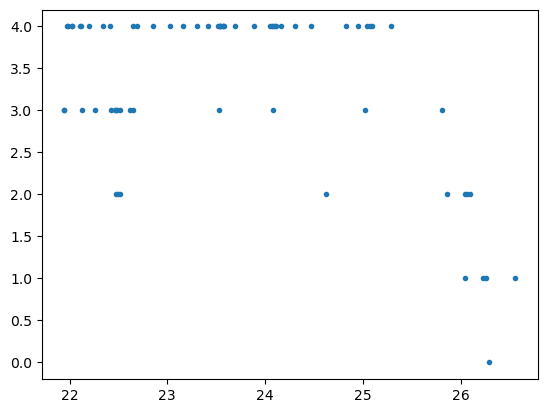

In [832]:
plt.plot(fwhms, matched_flare_phot, 'o')
plt.plot(fwhms, matched_flare, '.')
plt.show()
plt.plot(fwhms, nsources, '.')
plt.show()
plt.plot(bgs, matched_flare_phot, 'o')
plt.plot(bgs, matched_flare, '.')
plt.show()
plt.plot(bgs, nsources, '.')
plt.show()


In [1239]:

match_dist=0.5
fit_shape = (25, 25)

# TESTING PSF MODELS: GAUSSIAN

In [ ]:
import importlib
importlib.reload(defs)

tmp_argument_list = [start, end] +  [GaussianPRF(x_fwhm=header['FWHM'],y_fwhm=header['FWHM']), imnames_timeordered,  xycoords,
             flare_ref_pos, fit_shape,match_dist, flr_id]
defs.extract(tmp_argument_list)

1/74
2.2518749020641566 1
nsources detected 98
redoing psphot
2/74
1.936957617510279 1
nsources detected 104
redoing psphot
did we macth flare star? YES
matchescount 97, 1


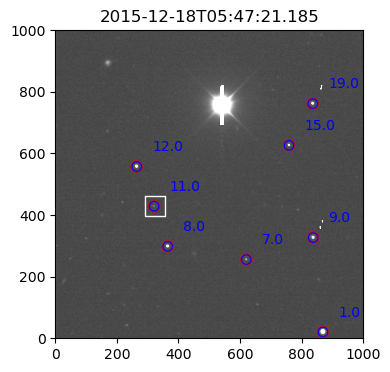

3/74
2.2950901930013767 1
nsources detected 104
redoing psphot
did we macth flare star? YES
matchescount 97, 1


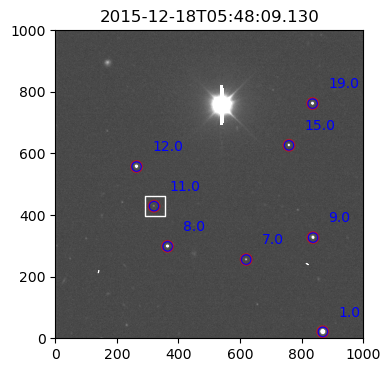

4/74
2.4936093075042303 1
nsources detected 103
redoing psphot
did we macth flare star? YES
matchescount 97, 1


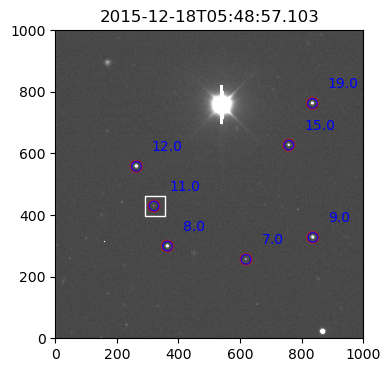

5/74
2.2573521761889395 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 98, 1


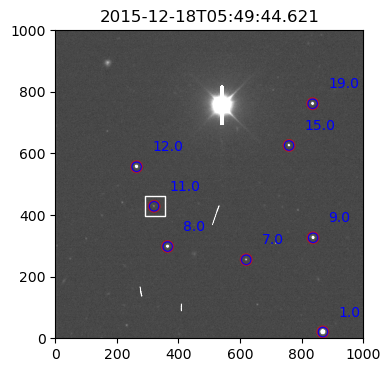

6/74
2.379918001766906 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 98, 1


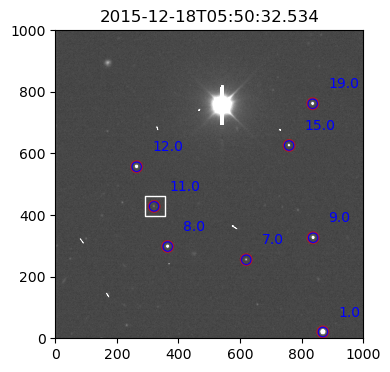

7/74
2.07930032159126 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 98, 1


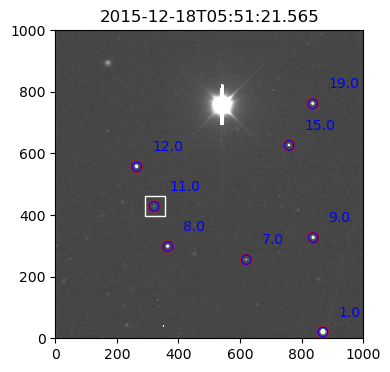

8/74
1.8351930607574611 1
nsources detected 105
did we macth flare star? YES
matchescount 98, 1


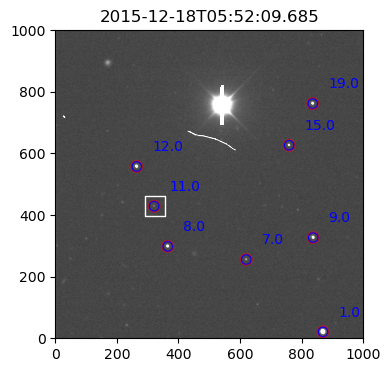

9/74
2.3322613324076062 1
nsources detected 104
redoing psphot
did we macth flare star? YES
matchescount 97, 1


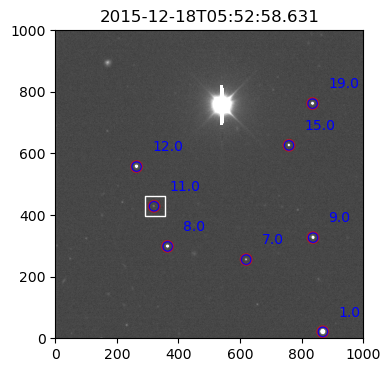

10/74
1.8744905498944922 1
nsources detected 102
redoing psphot
did we macth flare star? YES
matchescount 98, 1


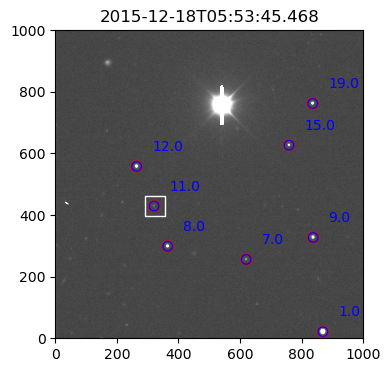

11/74
1.841174161455292 1
nsources detected 104
did we macth flare star? YES
matchescount 98, 1


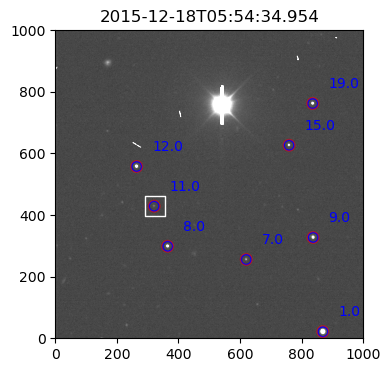

12/74
2.264939911264023 1
nsources detected 106
redoing psphot
did we macth flare star? YES
matchescount 98, 1


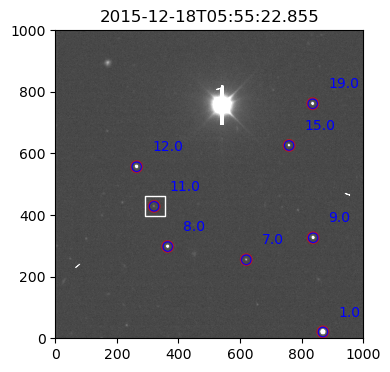

13/74
2.0657572873713557 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 98, 1


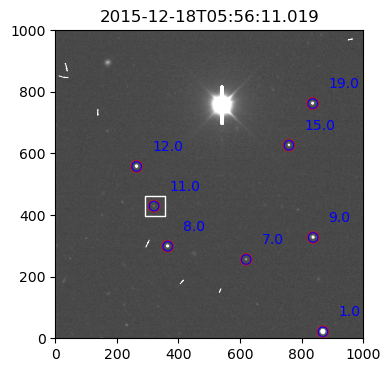

14/74
2.058623252531761 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 98, 1


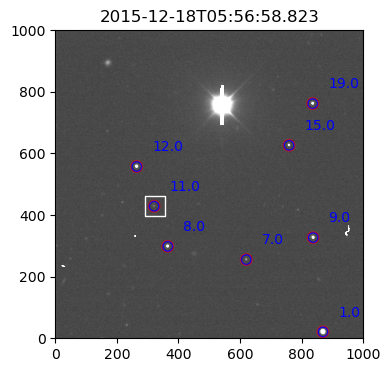

15/74
2.1300232844158784 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 98, 1


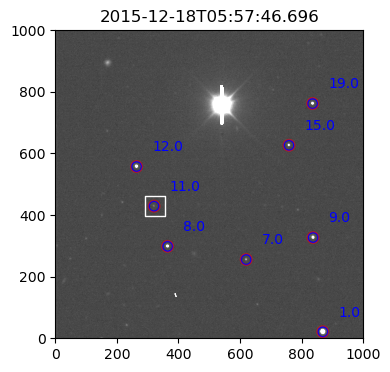

16/74
2.45000113177758 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 98, 1


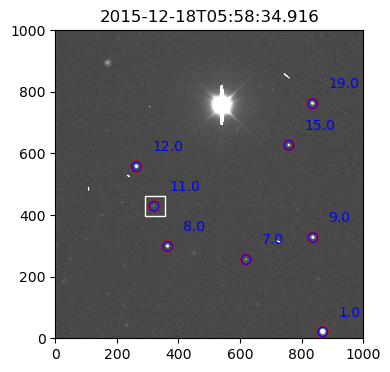

17/74
2.381765168418806 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 97, 1


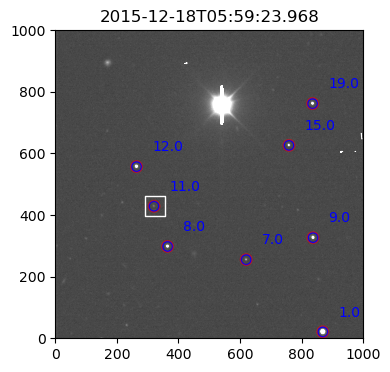

18/74
2.3757548292451474 1
nsources detected 104
redoing psphot
did we macth flare star? YES
matchescount 97, 1


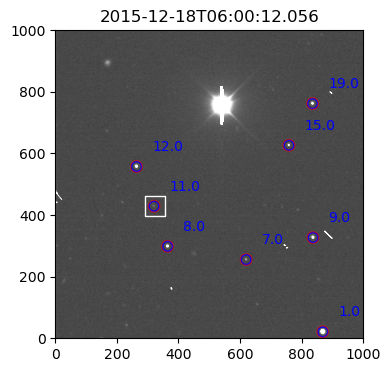

19/74
1.9001633218914304 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


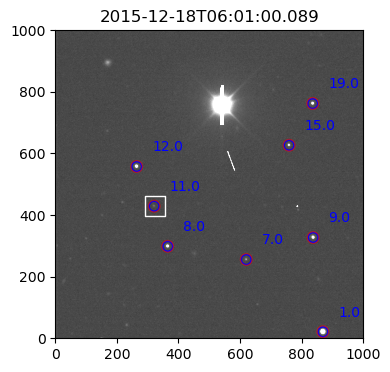

20/74
2.179836689198505 1
nsources detected 106
redoing psphot
did we macth flare star? YES
matchescount 98, 1


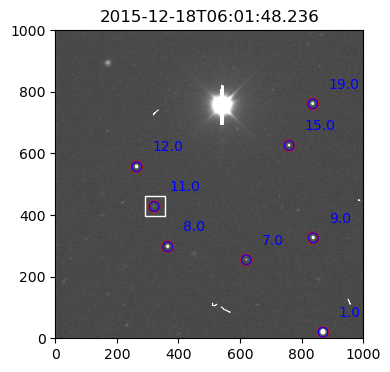

21/74
1.8300929423824348 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


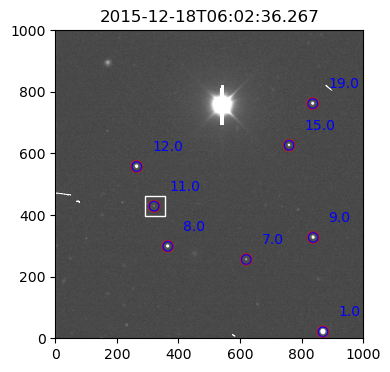

22/74
1.7693668652675516 1
nsources detected 105
did we macth flare star? YES
matchescount 98, 1


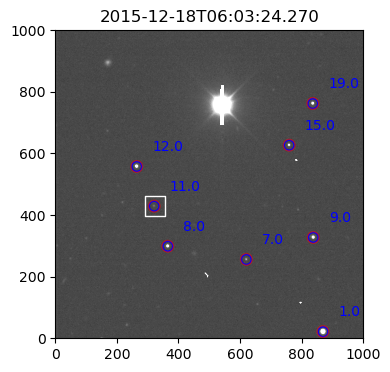

23/74
2.2948441417494254 1
nsources detected 107
redoing psphot
did we macth flare star? YES
matchescount 98, 1


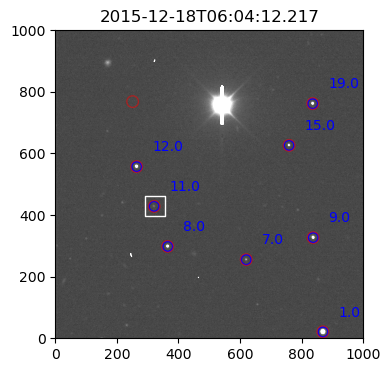

24/74
2.465654664405584 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 97, 1


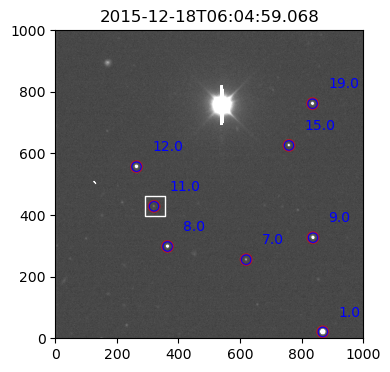

25/74
1.8860032872837964 1
nsources detected 106
redoing psphot
did we macth flare star? YES
matchescount 98, 1


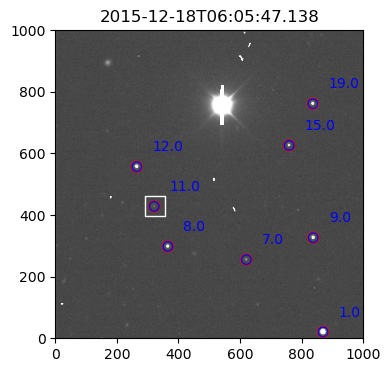

26/74
1.676444741804422 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


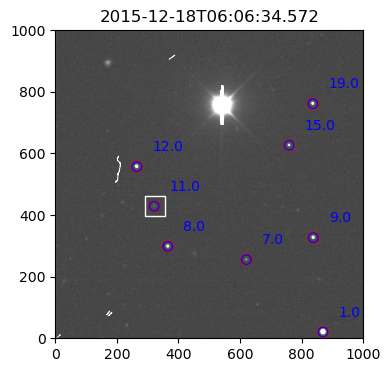

27/74
1.6947625892127494 1
nsources detected 106
did we macth flare star? YES
matchescount 97, 1


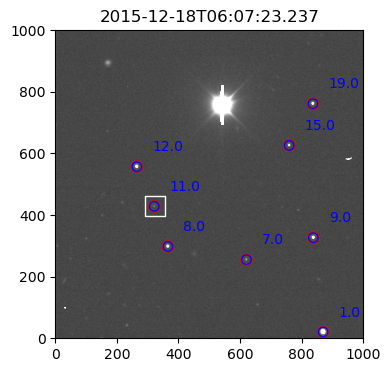

28/74
1.4846717813181727 1
nsources detected 107
did we macth flare star? YES
matchescount 98, 1


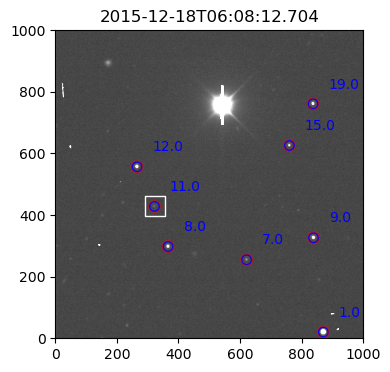

29/74
1.6824516180156994 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


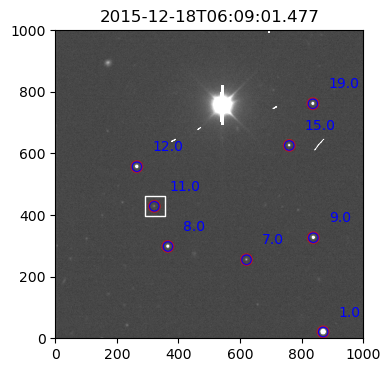

30/74
0.9962177560633204 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


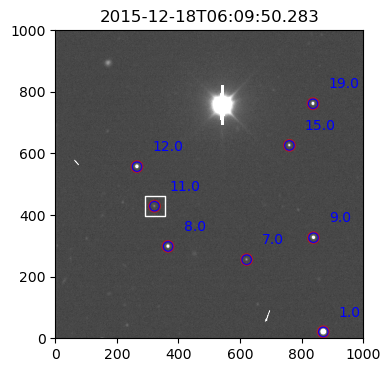

31/74
1.1772984022078532 1
nsources detected 106
did we macth flare star? YES
matchescount 97, 1


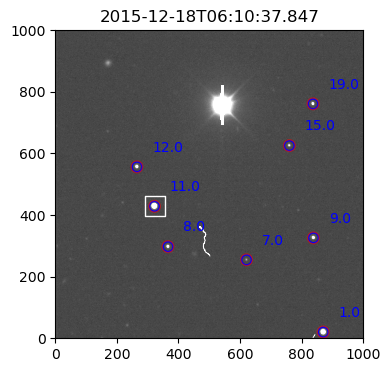

32/74
1.8007931146462857 1
nsources detected 105
did we macth flare star? YES
matchescount 97, 1


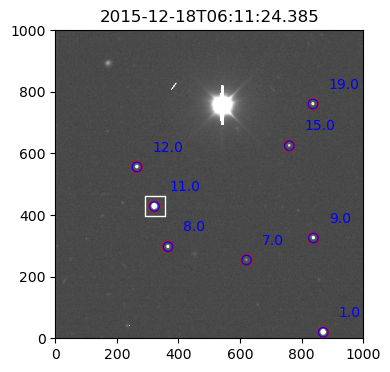

33/74
1.4668591036624083 1
nsources detected 106
did we macth flare star? YES
matchescount 97, 1


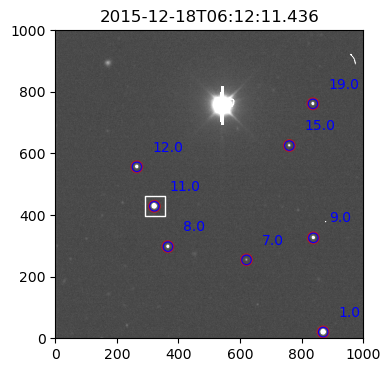

34/74
0.8366784774774755 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


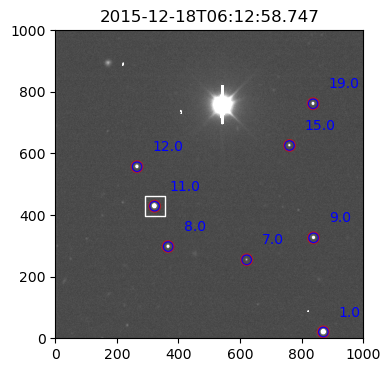

35/74
2.02921938496819 1
nsources detected 84
did we macth flare star? YES
matchescount 77, 1


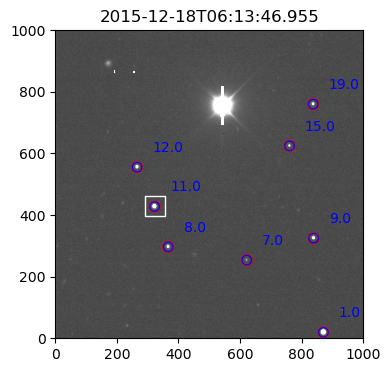

36/74
0.08826492590726488 1
nsources detected 104
did we macth flare star? YES
matchescount 97, 1


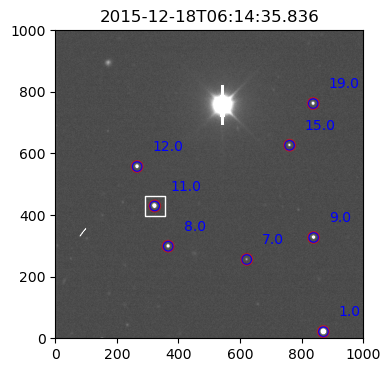

37/74
1.3886777172502154 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


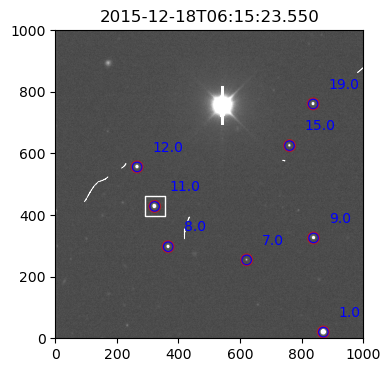

38/74
0.528407614423776 1
nsources detected 105
did we macth flare star? YES
matchescount 98, 1


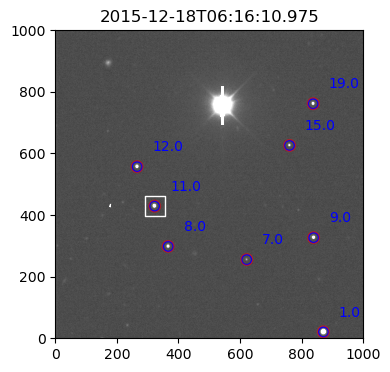

39/74
0.6102751885262988 1
nsources detected 101
did we macth flare star? YES
matchescount 93, 1


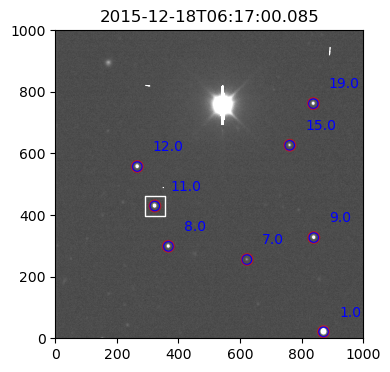

40/74
1.0690754752426115 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


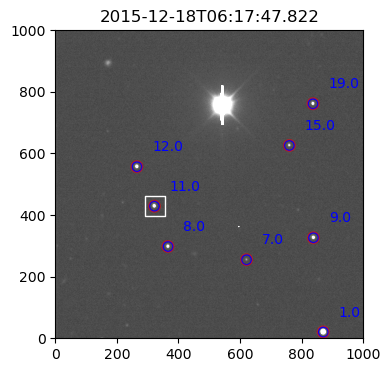

41/74
0.355659495437261 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


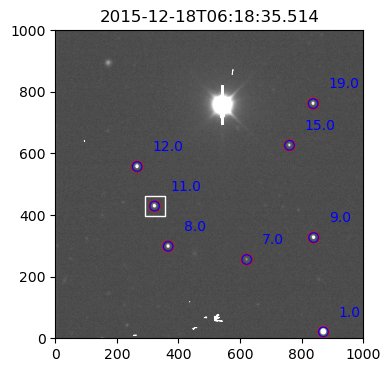

42/74
1.3428724454192806 1
nsources detected 104
did we macth flare star? YES
matchescount 96, 1


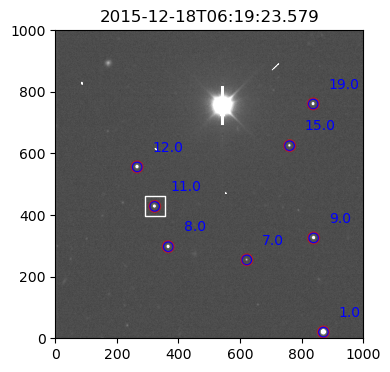

43/74
1.294085751875219 1
nsources detected 104
did we macth flare star? YES
matchescount 96, 1


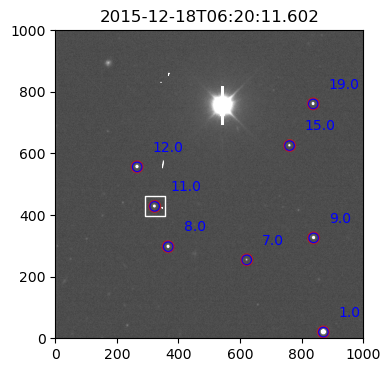

44/74
1.3142757250492285 1
nsources detected 102
did we macth flare star? YES
matchescount 94, 1


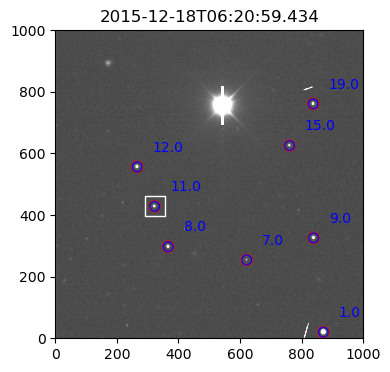

45/74
138.51488957241065 0
redoing daophot
nsources detected 102
did we macth flare star? YES
matchescount 94, 1


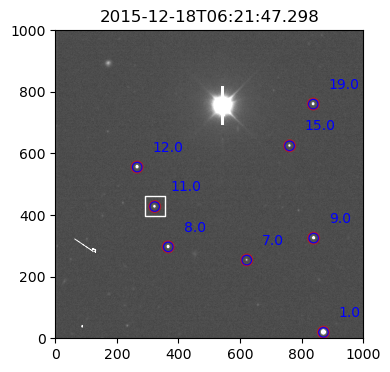

46/74
1.8417331137521815 1
nsources detected 103
did we macth flare star? YES
matchescount 96, 1


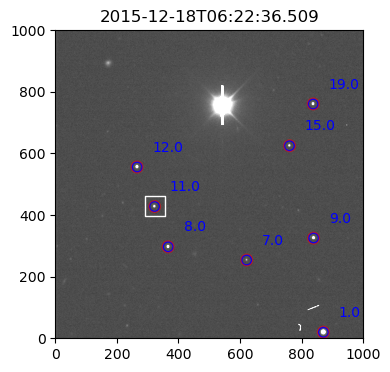

47/74
138.8533765123419 0
redoing daophot
nsources detected 98
did we macth flare star? YES
matchescount 90, 1


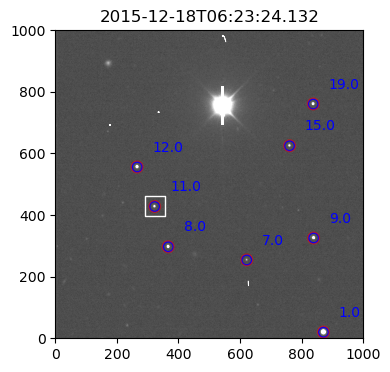

48/74
1.821129933639791 1
nsources detected 105
did we macth flare star? YES
matchescount 97, 1


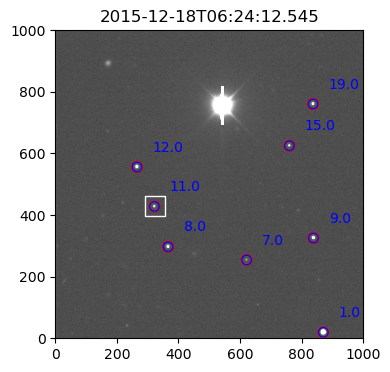

49/74
1.4639744306721316 1
nsources detected 101
did we macth flare star? YES
matchescount 93, 1


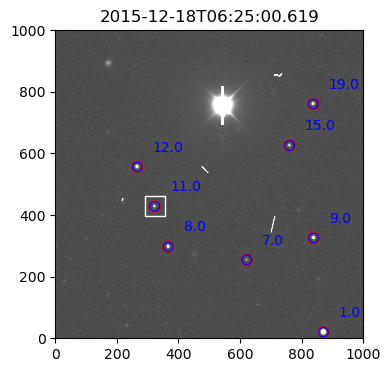

50/74
1.3860722924193658 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


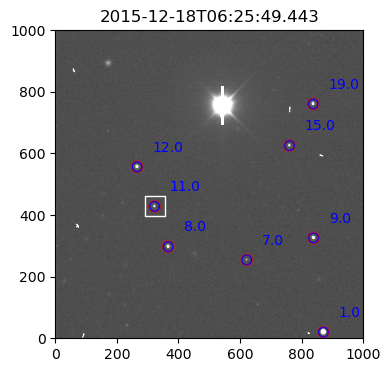

51/74
3.2276088530866063 1
nsources detected 75
redoing psphot
did we macth flare star? YES
matchescount 68, 1


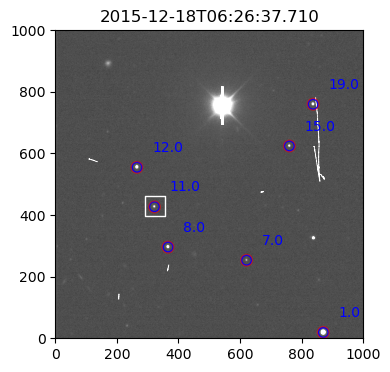

52/74
3.342256121030053 1
nsources detected 99
redoing psphot
did we macth flare star? YES
matchescount 91, 1


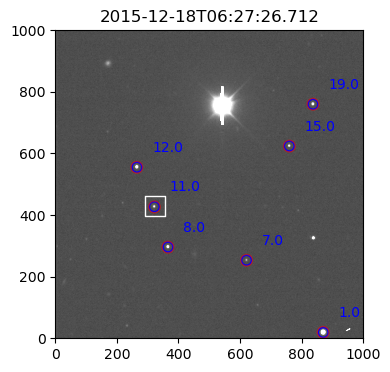

53/74
2.0662665214057987 1
nsources detected 106
redoing psphot
did we macth flare star? YES
matchescount 98, 1


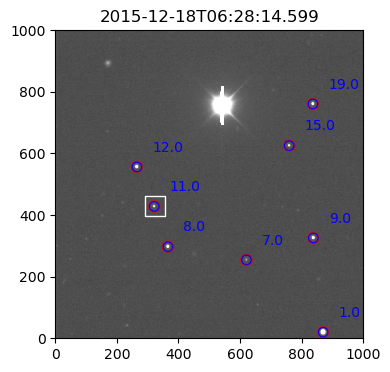

54/74
2.004043056784932 1
nsources detected 103
redoing psphot
did we macth flare star? YES
matchescount 95, 1


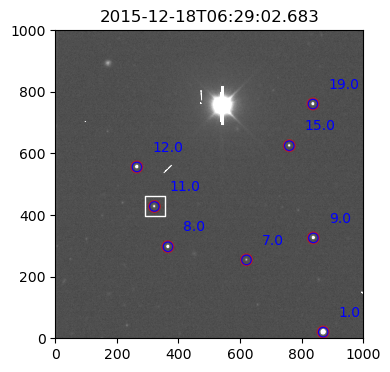

55/74
1.79218630419353 1
nsources detected 106
did we macth flare star? YES
matchescount 98, 1


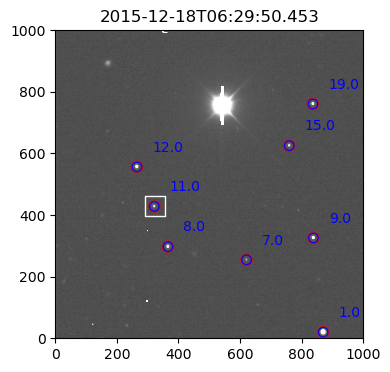

56/74
3.293620703875081 1
nsources detected 92
redoing psphot
did we macth flare star? YES
matchescount 85, 1


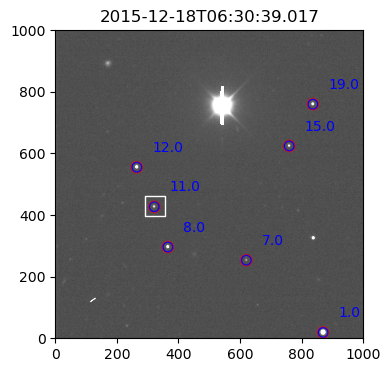

57/74
733.3382090073923 0
redoing daophot
nsources detected 99
redoing psphot
did we macth flare star? YES
matchescount 92, 1


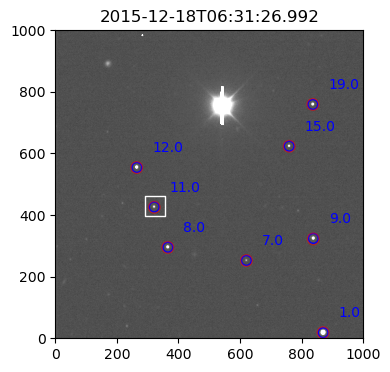

58/74
2.752824698606768 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 97, 1


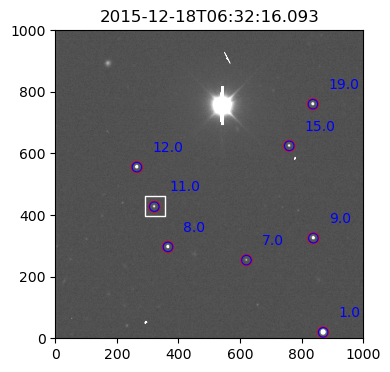

59/74
2.097844935334547 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 97, 1


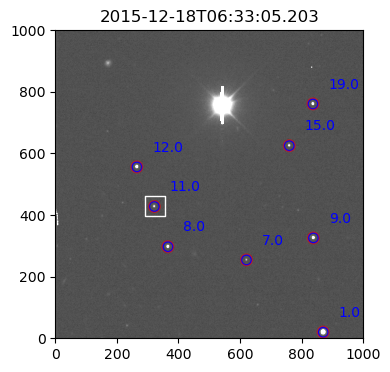

60/74
1.6954260059647561 1
nsources detected 105
did we macth flare star? YES
matchescount 97, 1


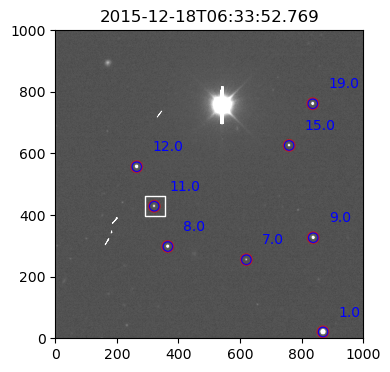

61/74
1.7736406644904381 1
nsources detected 106
did we macth flare star? YES
matchescount 96, 1


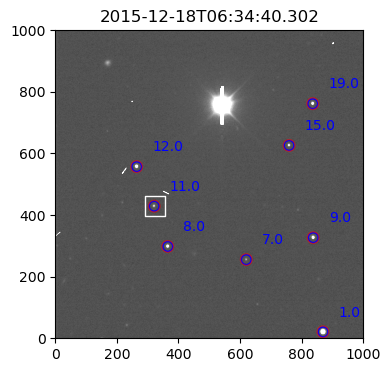

62/74
1.797998476683365 1
nsources detected 104
did we macth flare star? YES
matchescount 96, 1


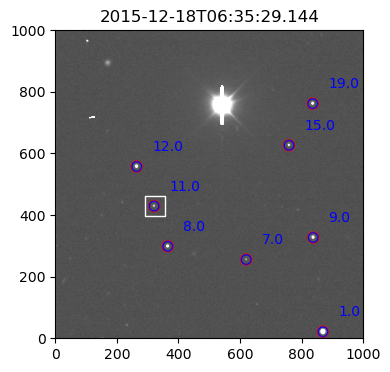

63/74
2.65613680820724 1
nsources detected 106
redoing psphot
did we macth flare star? YES
matchescount 98, 1


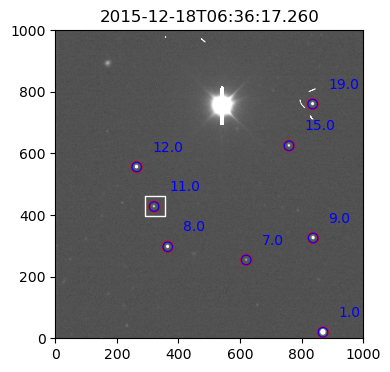

64/74
2.173180581189296 1
nsources detected 106
redoing psphot
did we macth flare star? YES
matchescount 98, 1


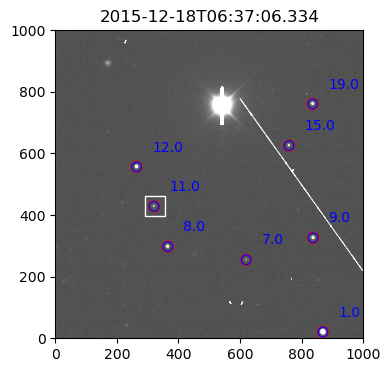

65/74
3.4951245979188257 1
nsources detected 102
redoing psphot
did we macth flare star? YES
matchescount 94, 1


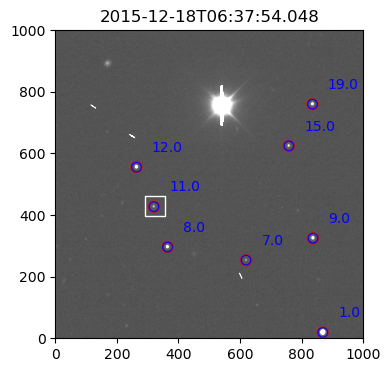

66/74
345.7523556606085 0
redoing daophot
nsources detected 94
redoing psphot
did we macth flare star? YES
matchescount 89, 1


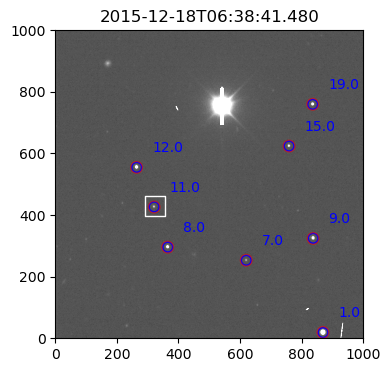

67/74
608.757964124647 0
redoing daophot
nsources detected 104
redoing psphot
did we macth flare star? YES
matchescount 95, 1


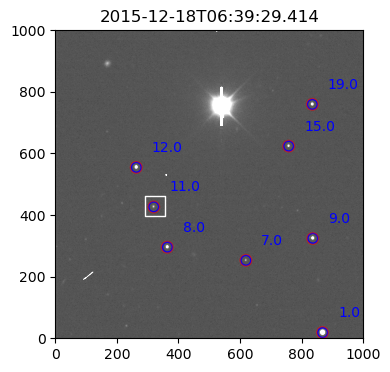

68/74
3.459427630264915 1
nsources detected 100
redoing psphot
did we macth flare star? YES
matchescount 92, 1


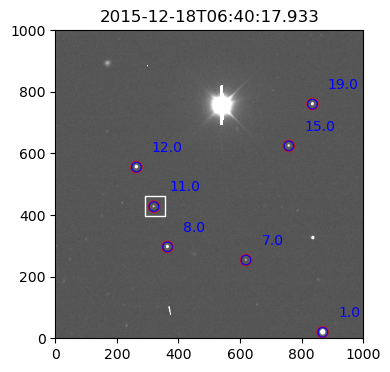

69/74
4.718739456105747 1
nsources detected 92
redoing psphot
did we macth flare star? YES
matchescount 85, 1


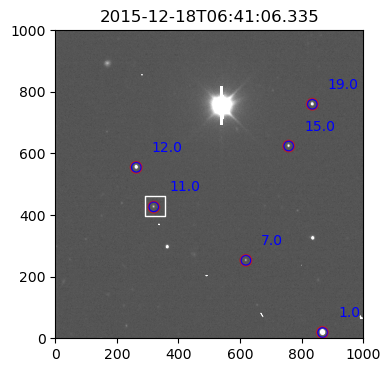

70/74
3.8116852175332716 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 97, 1


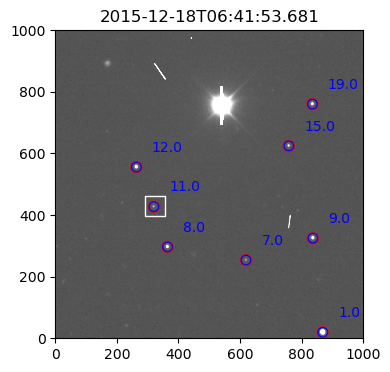

71/74
2.760798236136051 1
nsources detected 105
redoing psphot
did we macth flare star? YES
matchescount 97, 1


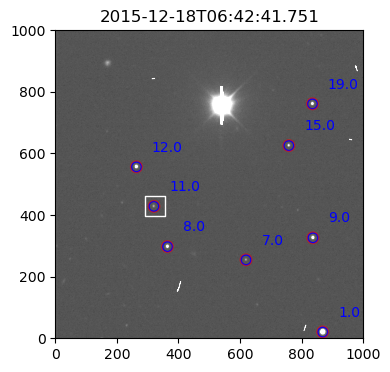

72/74
344.4702855416961 0
redoing daophot
nsources detected 99
redoing psphot
did we macth flare star? YES
matchescount 92, 1


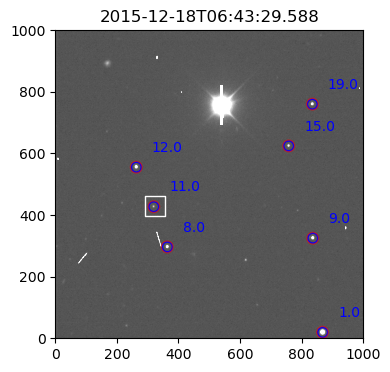

73/74
3.811036163201007 1
nsources detected 97
redoing psphot
did we macth flare star? YES
matchescount 89, 1


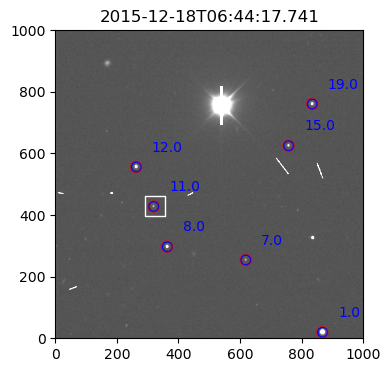

74/74
341.8328695250032 0
redoing daophot
nsources detected 102
redoing psphot
did we macth flare star? YES
matchescount 94, 1


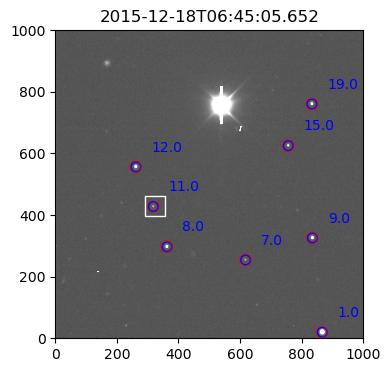

In [1308]:
importlib.reload(defs)
from defs import extract
match_dist = 0.5

gaussianmodel = GaussianPRF()
gaussianmodel.x_fwhm.fixed = False
gaussianmodel.y_fwhm.fixed = False

main_df_Gaussian, matchescounts_Gaussian = extract((start, end), gaussianmodel, imnames_timeordered,  xycoords,
             flare_ref_pos, fit_shape,match_dist, flr_id, plot=True)

# TESTING PSF MODELS: MOFFAT

1/66
2.3322613324076062 1
nsources detected 104
2/66
1.8744905498944922 1
nsources detected 102
did we macth flare star? YES
matchescount 100, 1


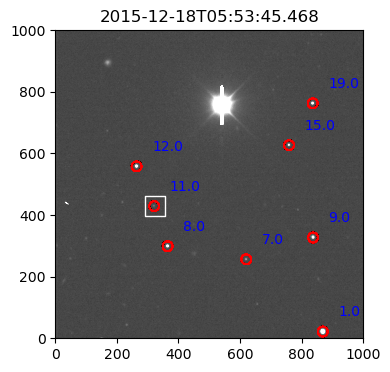

3/66
1.841174161455292 1
nsources detected 104
did we macth flare star? YES
matchescount 103, 1


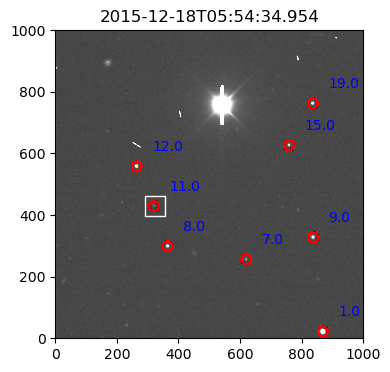

4/66
2.264939911264023 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


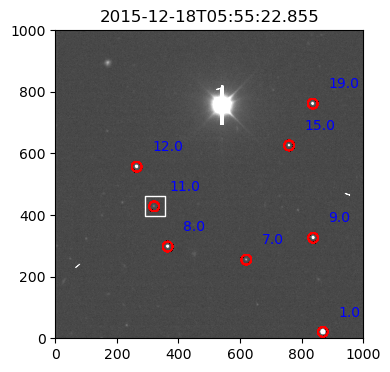

5/66
2.0657572873713557 1
nsources detected 105
did we macth flare star? YES
matchescount 104, 1


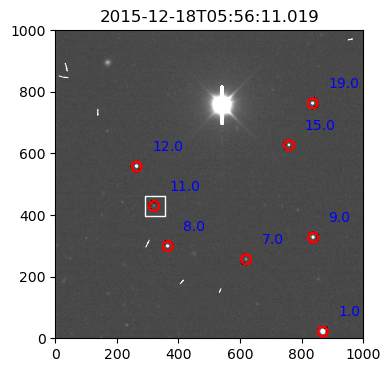

6/66
2.058623252531761 1
nsources detected 105
did we macth flare star? YES
matchescount 104, 1


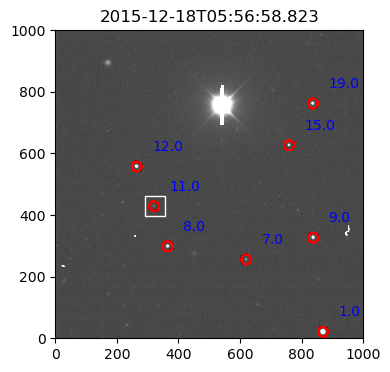

7/66
2.1300232844158784 1
nsources detected 105
did we macth flare star? YES
matchescount 104, 1


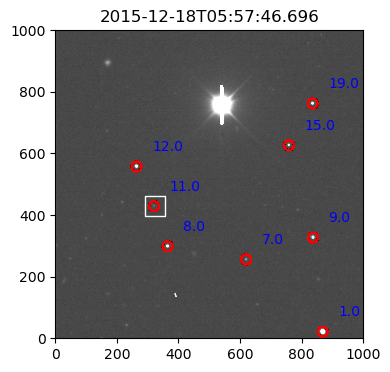

8/66
2.45000113177758 1
nsources detected 105
did we macth flare star? YES
matchescount 104, 1


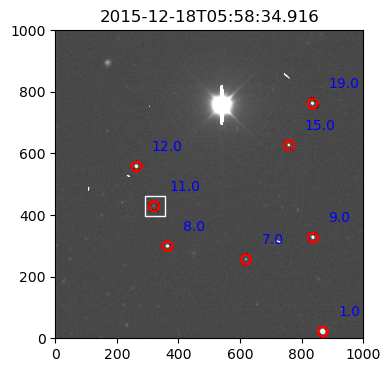

9/66
2.381765168418806 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


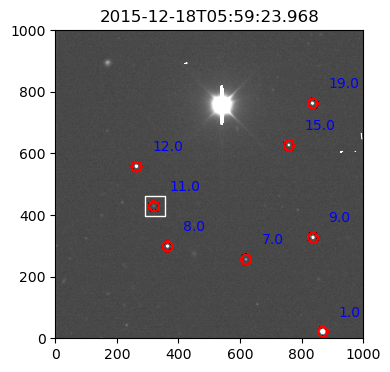

10/66
2.3757548292451474 1
nsources detected 104
did we macth flare star? YES
matchescount 103, 1


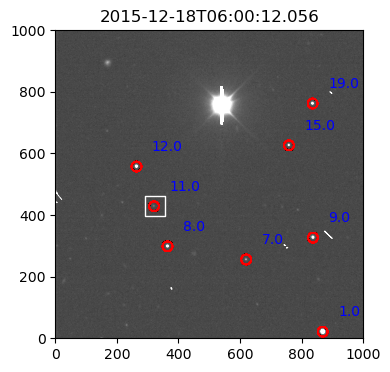

11/66
1.9001633218914304 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


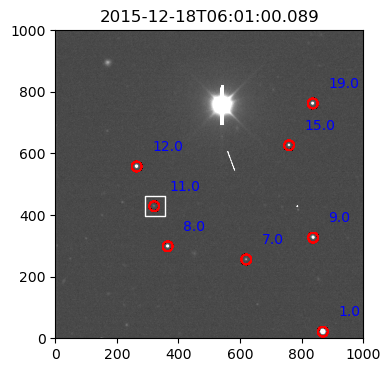

12/66
2.179836689198505 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


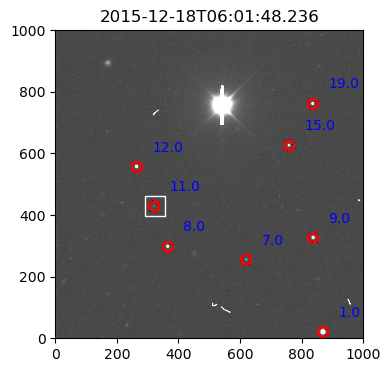

13/66
1.8300929423824348 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


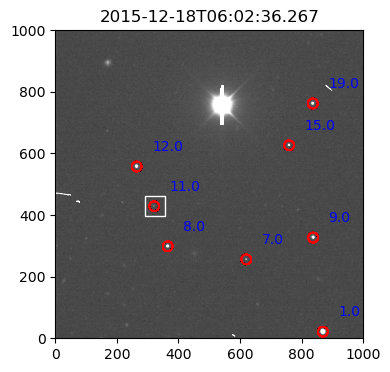

14/66
1.7693668652675516 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


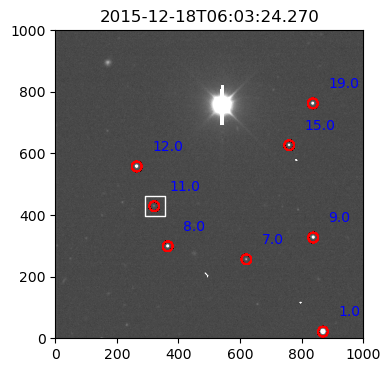

15/66
2.2948441417494254 1
nsources detected 107
did we macth flare star? YES
matchescount 104, 1


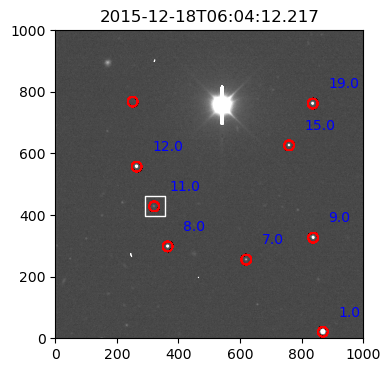

16/66
2.465654664405584 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


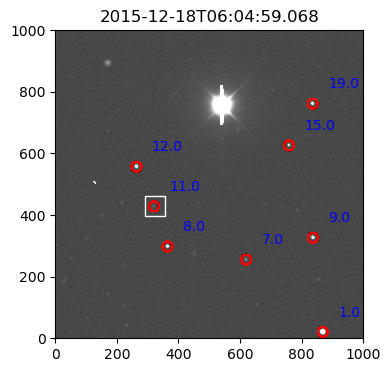

17/66
1.8860032872837964 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


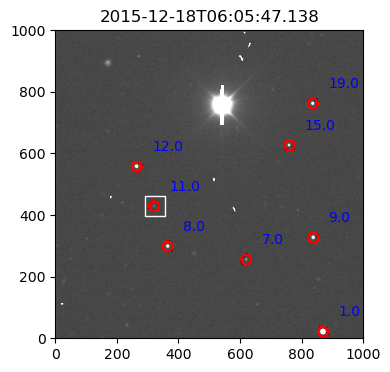

18/66
1.676444741804422 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


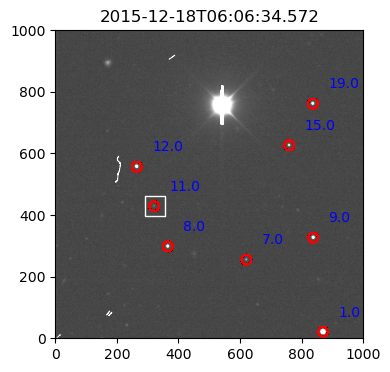

19/66
1.6947625892127494 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


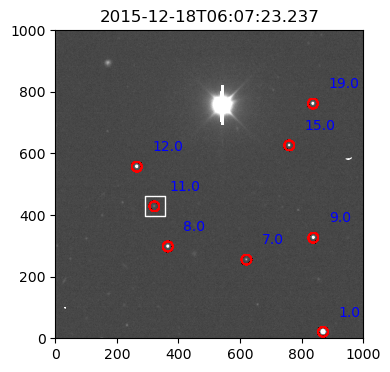

20/66
1.4846717813181727 1
nsources detected 107
did we macth flare star? YES
matchescount 104, 1


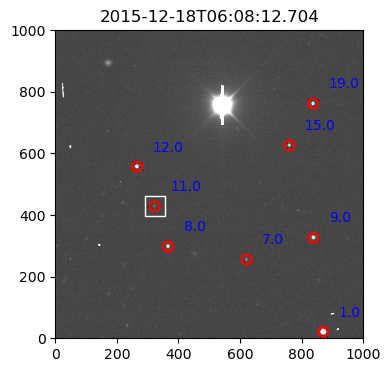

21/66
1.6824516180156994 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


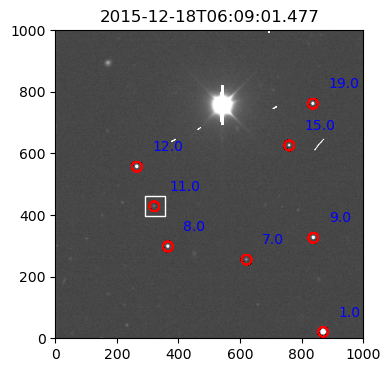

22/66
0.9962177560633204 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


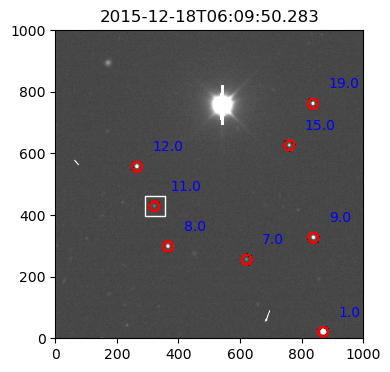

23/66
1.1772984022078532 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


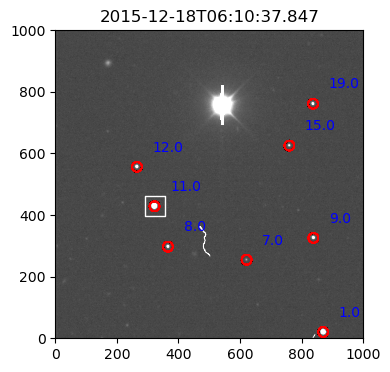

24/66
1.8007931146462857 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


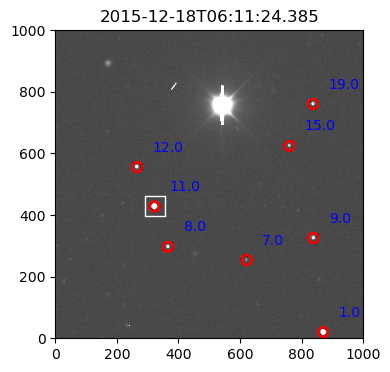

25/66
1.4668591036624083 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


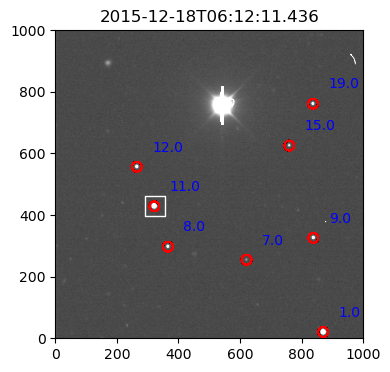

26/66
0.8366784774774755 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


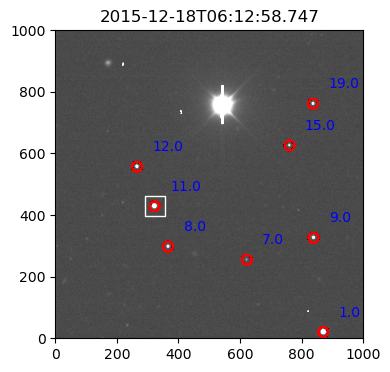

27/66
2.02921938496819 1
nsources detected 84
did we macth flare star? YES
matchescount 83, 1


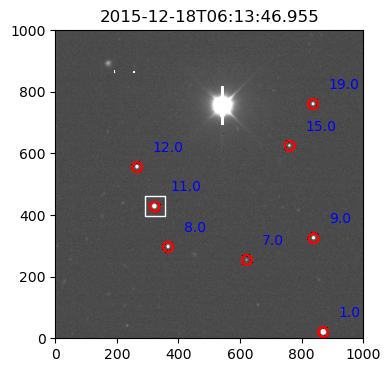

28/66
0.08826492590726488 1
nsources detected 104
did we macth flare star? YES
matchescount 102, 1


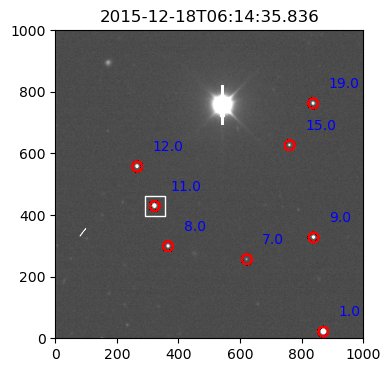

29/66
1.3886777172502154 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


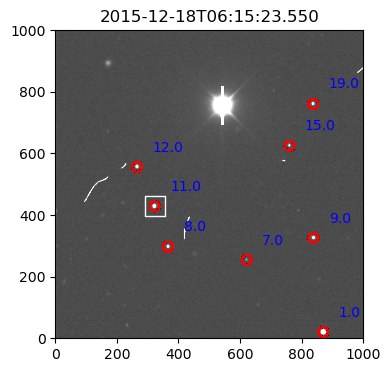

30/66
0.528407614423776 1
nsources detected 105
matchescount 102, 0


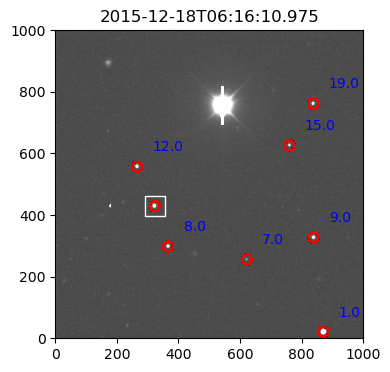

31/66
0.6102751885262988 1
nsources detected 101
did we macth flare star? YES
matchescount 96, 1


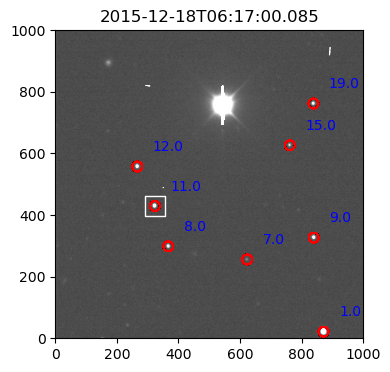

32/66
1.0690754752426115 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


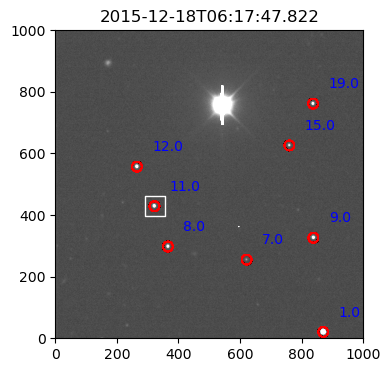

33/66
0.355659495437261 1
nsources detected 106
matchescount 99, 0


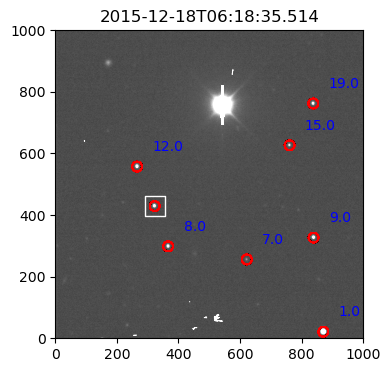

34/66
1.3428724454192806 1
nsources detected 104
did we macth flare star? YES
matchescount 102, 1


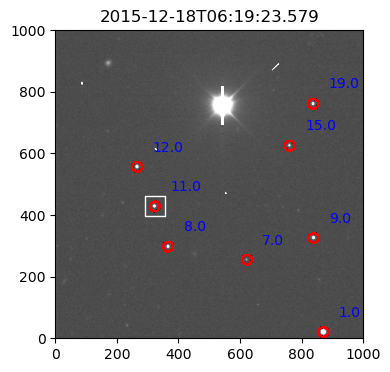

35/66
1.294085751875219 1
nsources detected 104
did we macth flare star? YES
matchescount 102, 1


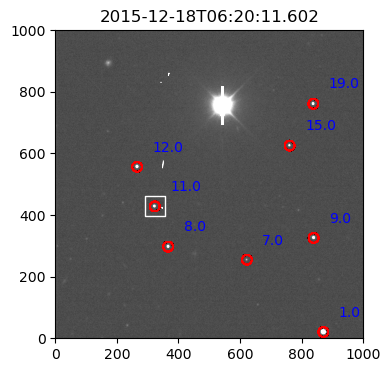

36/66
1.3142757250492285 1
nsources detected 102
did we macth flare star? YES
matchescount 100, 1


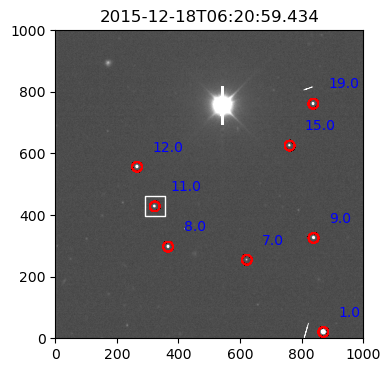

37/66
138.51488957241065 0
redoing daophot
nsources detected 102
did we macth flare star? YES
matchescount 100, 1


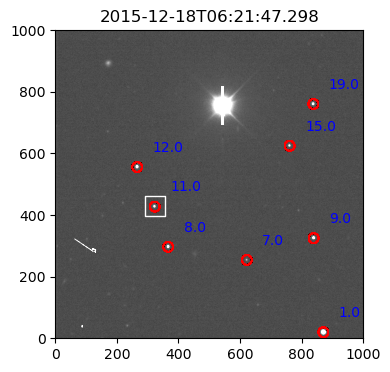

38/66
1.8417331137521815 1
nsources detected 103
did we macth flare star? YES
matchescount 102, 1


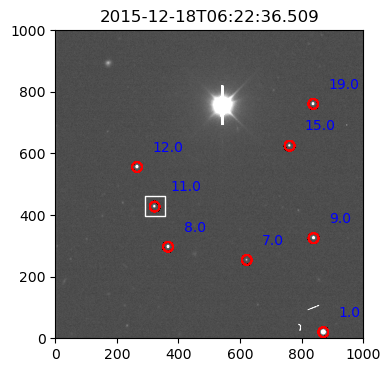

39/66
138.8533765123419 0
redoing daophot
nsources detected 98
did we macth flare star? YES
matchescount 96, 1


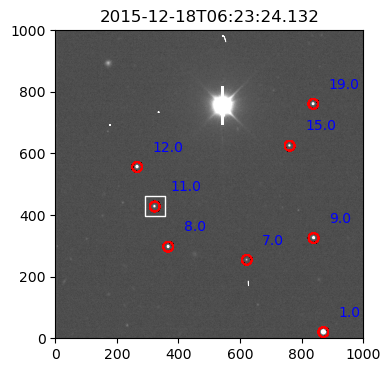

40/66
1.821129933639791 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


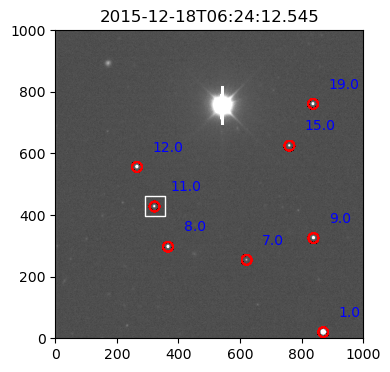

41/66
1.4639744306721316 1
nsources detected 101
matchescount 98, 0


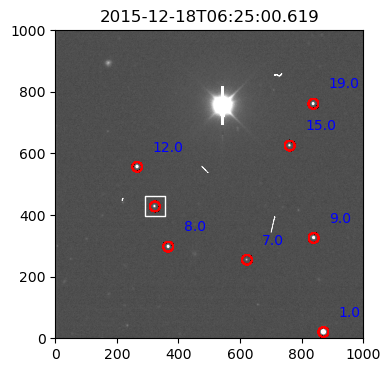

42/66
1.3860722924193658 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


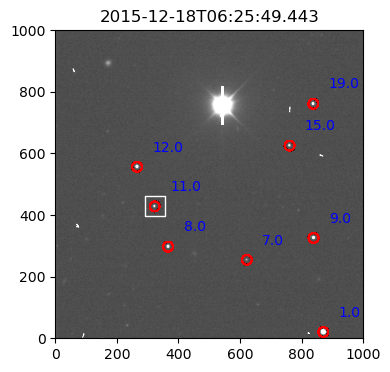

43/66
3.2276088530866063 1
nsources detected 75
did we macth flare star? YES
matchescount 73, 1


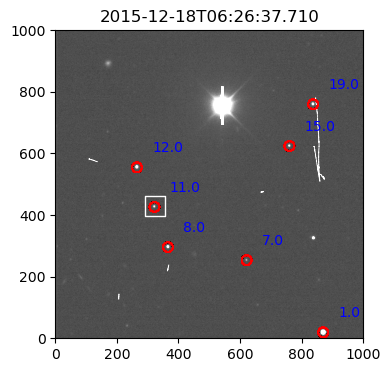

44/66
3.342256121030053 1
nsources detected 99
did we macth flare star? YES
matchescount 97, 1


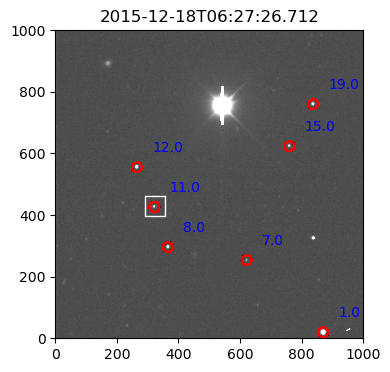

45/66
2.0662665214057987 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


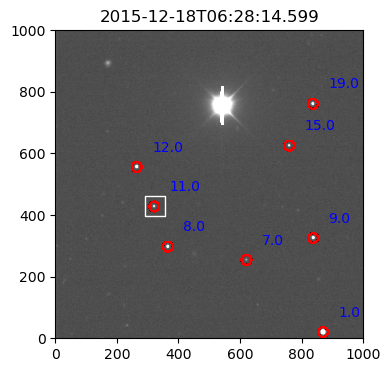

46/66
2.004043056784932 1
nsources detected 103
did we macth flare star? YES
matchescount 100, 1


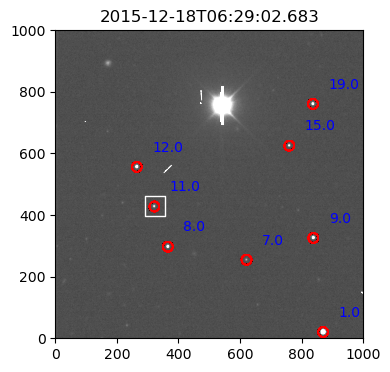

47/66
1.79218630419353 1
nsources detected 106
did we macth flare star? YES
matchescount 103, 1


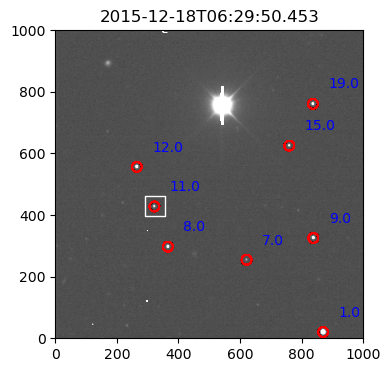

48/66
3.293620703875081 1
nsources detected 92
did we macth flare star? YES
matchescount 91, 1


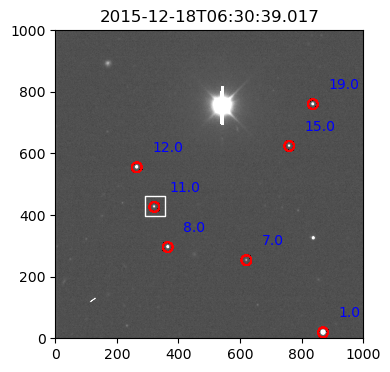

49/66
733.3382090073923 0
redoing daophot
nsources detected 99
did we macth flare star? YES
matchescount 91, 1


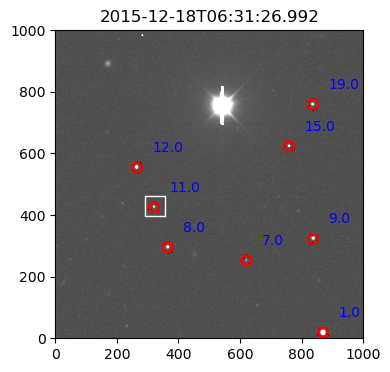

50/66
2.752824698606768 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


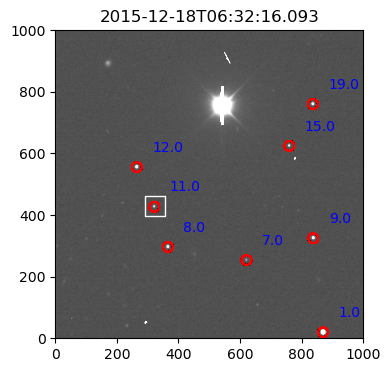

51/66
2.097844935334547 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


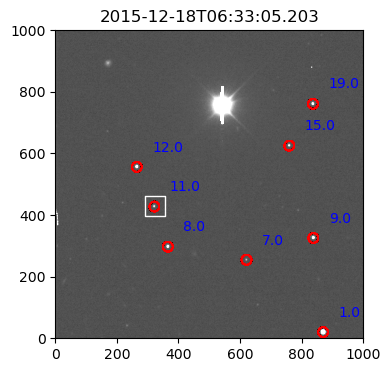

52/66
1.6954260059647561 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


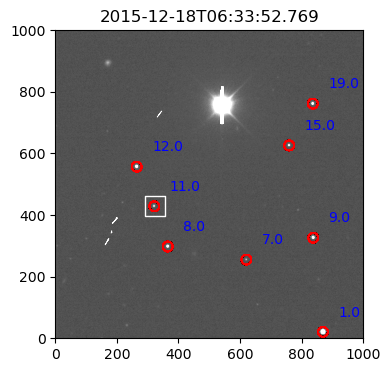

53/66
1.7736406644904381 1
nsources detected 106
did we macth flare star? YES
matchescount 102, 1


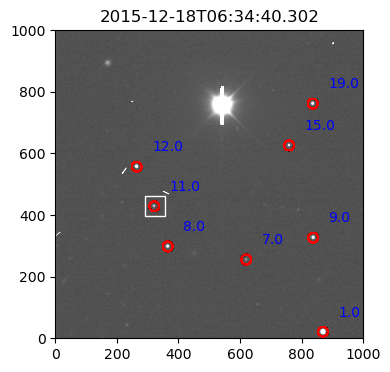

54/66
1.797998476683365 1
nsources detected 104
matchescount 101, 0


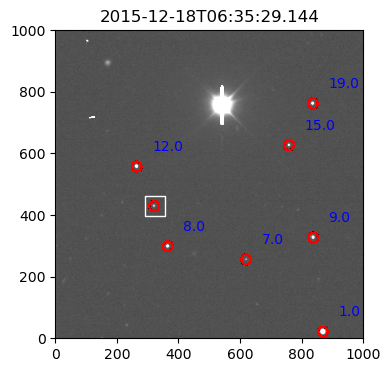

55/66
2.65613680820724 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


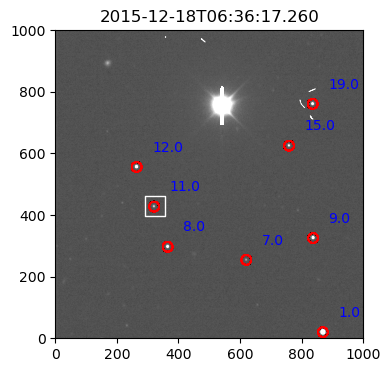

56/66
2.173180581189296 1
nsources detected 106
did we macth flare star? YES
matchescount 104, 1


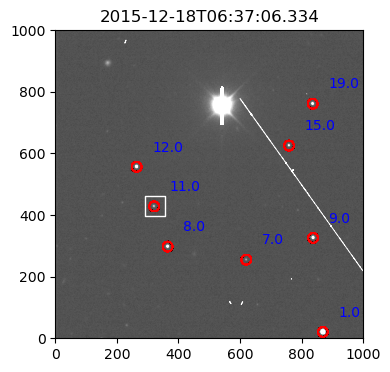

57/66
3.4951245979188257 1
nsources detected 102
did we macth flare star? YES
matchescount 100, 1


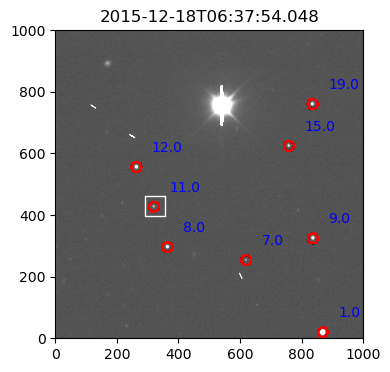

58/66
345.7523556606085 0
redoing daophot
nsources detected 94
did we macth flare star? YES
matchescount 91, 1


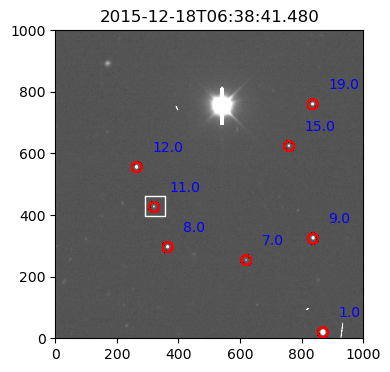

59/66
608.757964124647 0
redoing daophot
nsources detected 104
did we macth flare star? YES
matchescount 101, 1


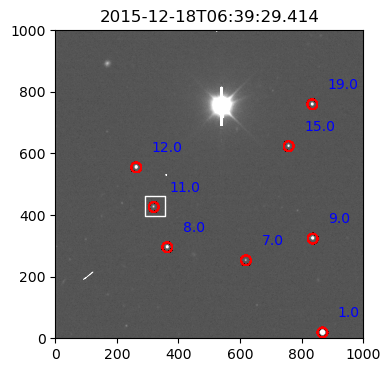

60/66
3.459427630264915 1
nsources detected 100
did we macth flare star? YES
matchescount 97, 1


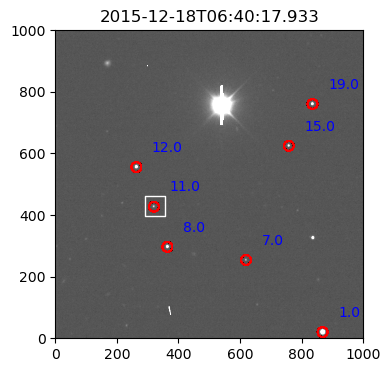

61/66
4.718739456105747 1
nsources detected 92
did we macth flare star? YES
matchescount 91, 1


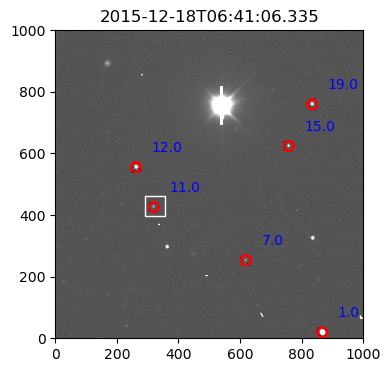

62/66
3.8116852175332716 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


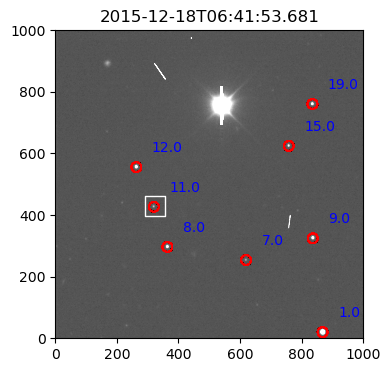

63/66
2.760798236136051 1
nsources detected 105
did we macth flare star? YES
matchescount 103, 1


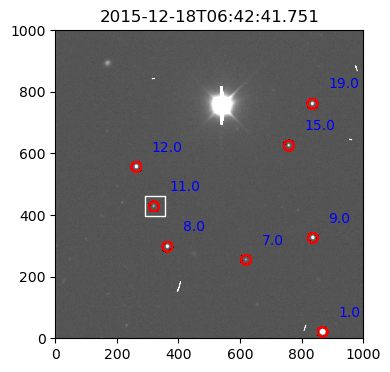

64/66
344.4702855416961 0
redoing daophot
nsources detected 99
did we macth flare star? YES
matchescount 97, 1


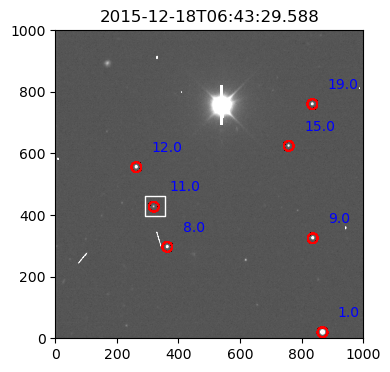

65/66
3.811036163201007 1
nsources detected 97
did we macth flare star? YES
matchescount 95, 1


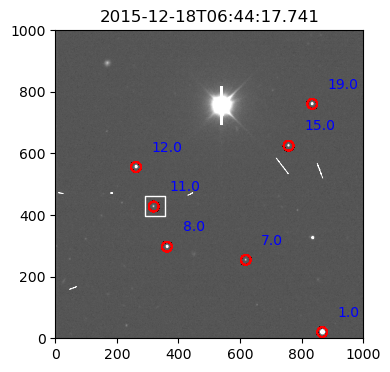

66/66
341.8328695250032 0
redoing daophot
nsources detected 102
did we macth flare star? YES
matchescount 101, 1


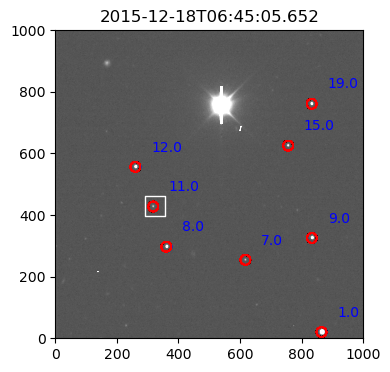

In [1136]:
plot = False
match_dist = 0.5
main_df_Moffat, matchescounts_Moffat = extract(MoffatPSF())

In [1193]:
main_df_Gaussian.to_csv(ROOTDIR + "/savedastrometry.csv")

Text(0.5, 0, 'img number')

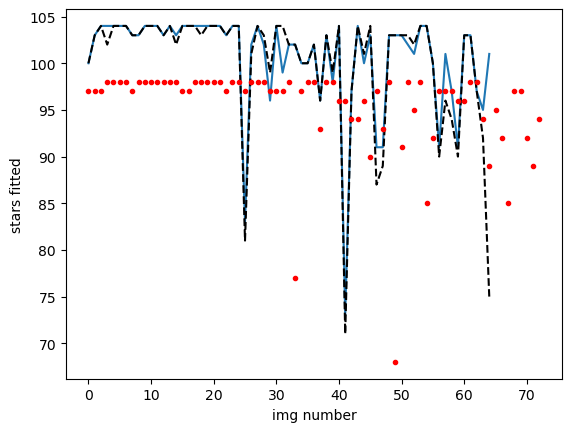

In [1309]:
plt.plot(matchescounts_Moffat)
plt.plot(matchescounts_Imagemodel, 'k--')
plt.plot(matchescounts_Gaussian, 'r.')
plt.ylabel("stars fitted")
plt.xlabel("img number")

In [1340]:
main_df = main_df_Gaussian #main_df_Imagemodel
print(main_df.shape)
main_df = main_df.sort_values('time')
main_df = main_df.dropna(how="all")

main_df.to_csv('Outdata/main_df_GaussPSF.csv', index=False)
print(main_df.shape)

main_df.head()


(7623, 28)
(7064, 28)


,id,group_id,group_size,local_bkg,x_init,y_init,flux_init,x_fit,y_fit,flux_fit,...,DEC,RA_ERR,DEC_ERR,time,x_fwhm_init,y_fwhm_init,x_fwhm_fit,y_fwhm_fit,x_fwhm_err,y_fwhm_err
0,1.0,1.0,1.0,32.954532,868.394115,21.562828,126758.384780,868.902078,21.013326,104968.384637,...,-54.992271,0.000001,7.038646e-07,57374.24066,NaN,NaN,NaN,NaN,NaN,NaN
71,72.0,72.0,1.0,22.699406,502.480951,2587.051335,8067.089820,502.776584,2587.067497,885.647114,...,-54.963825,0.000007,4.065092e-06,57374.24066,NaN,NaN,NaN,NaN,NaN,NaN
70,71.0,71.0,1.0,25.648732,1659.999934,2583.335751,18032.512919,1659.946718,2583.752164,9659.728915,...,-55.048371,0.000001,7.116992e-07,57374.24066,NaN,NaN,NaN,NaN,NaN,NaN
69,70.0,70.0,1.0,23.585986,555.596055,2537.173851,12086.546600,555.705773,2537.103946,3904.421275,...,-54.967731,0.000003,1.685421e-06,57374.24066,NaN,NaN,NaN,NaN,NaN,NaN
68,69.0,69.0,1.0,24.233255,1943.485763,2443.417415,11825.213272,1943.672124,2443.758100,4284.256870,...,-55.069223,0.000002,1.137959e-06,57374.24066,NaN,NaN,NaN,NaN,NaN,NaN


In [1311]:
len(main_df_Moffat), len(main_df_Gaussian), len(main_df_Imagemodel)

(6794, 7623, 6794)

What's the flare stars ID?

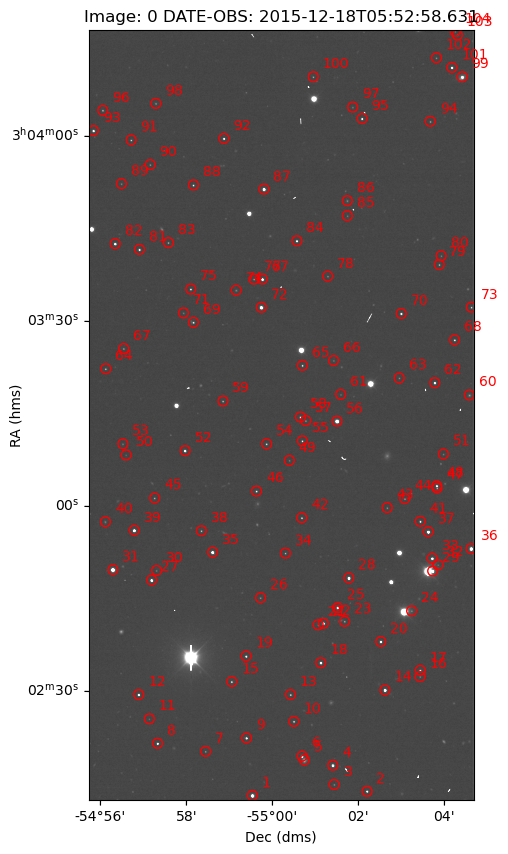

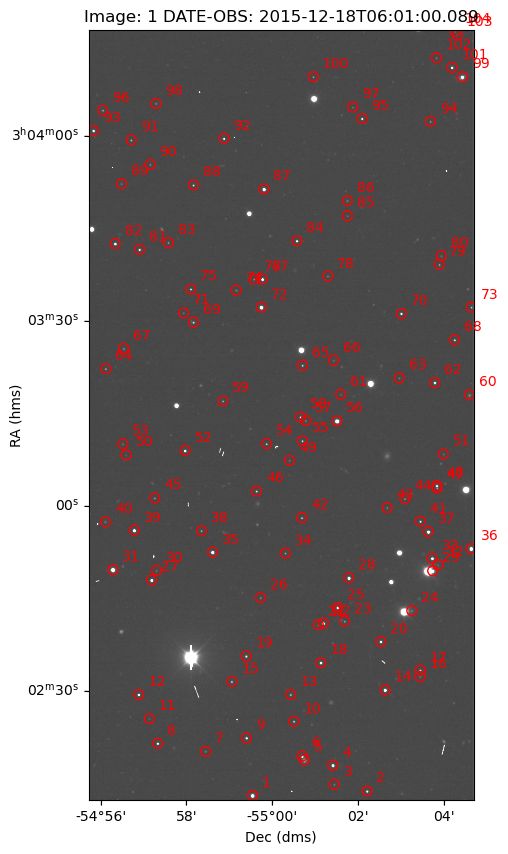

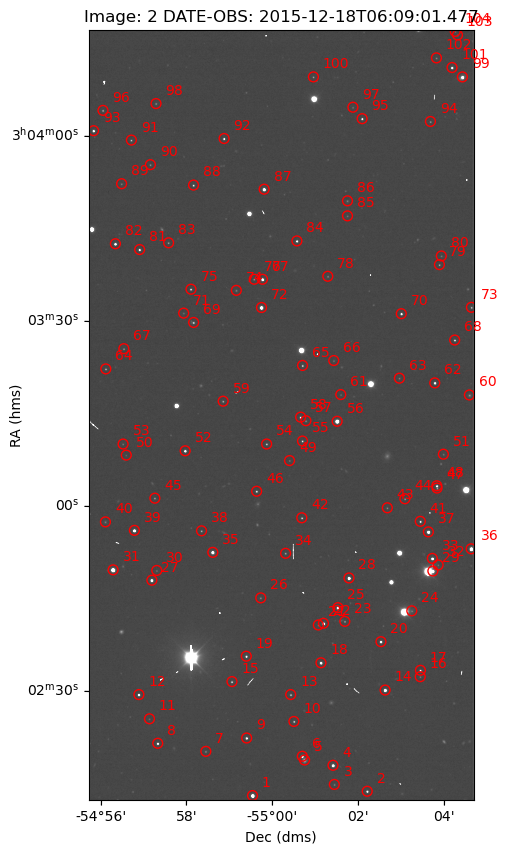

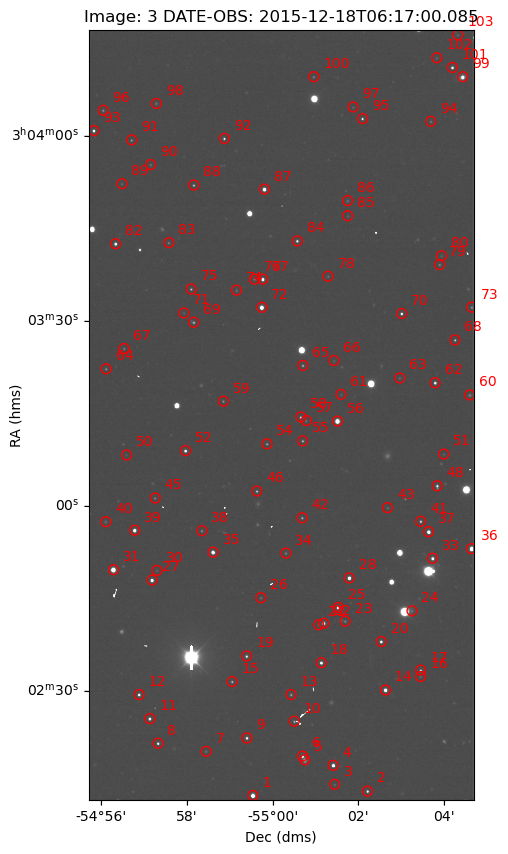

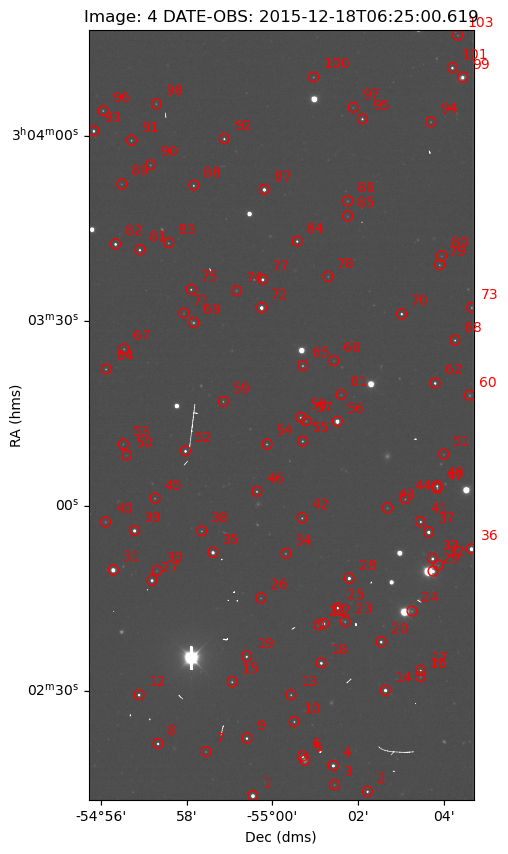

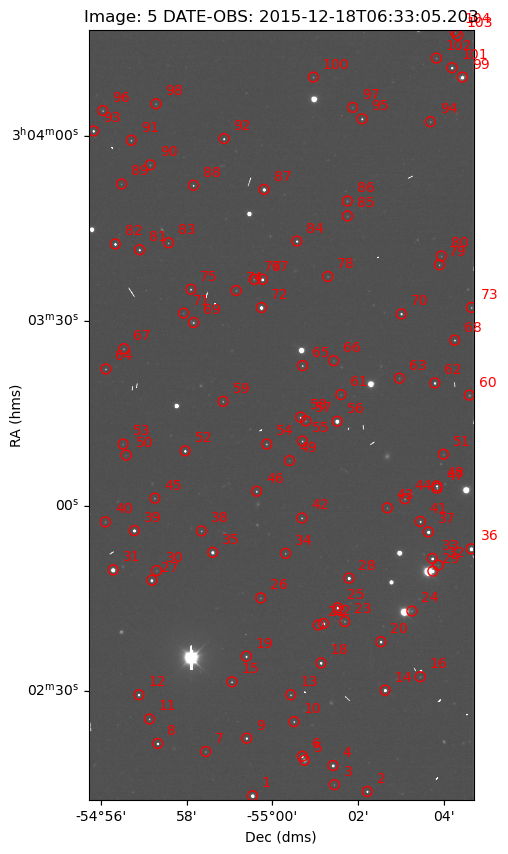

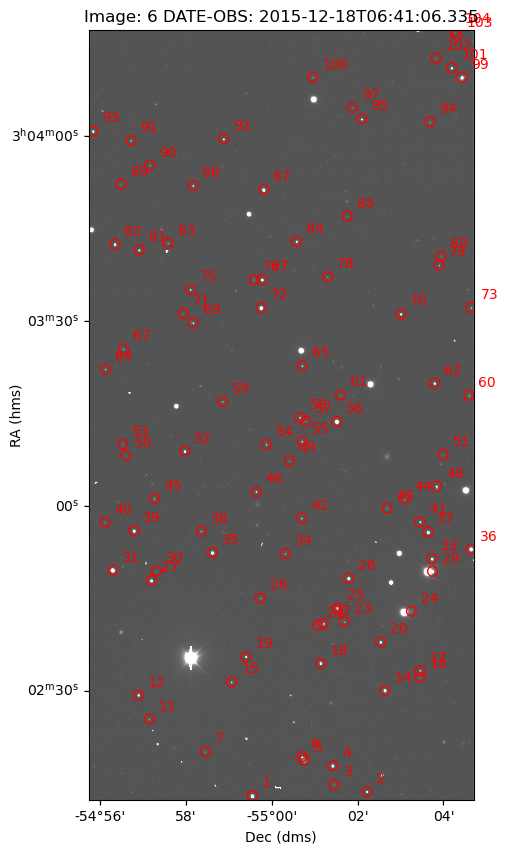

In [1197]:
for c, imname in enumerate(imnames_timeordered[start:end:10]):#start+10]):
    imnameS18 = imname[:-8] + '_S18' + imname[-8:]
    data = fits.getdata('dwfflare/dwfflareS18/' + imnameS18)
    header = fits.getheader('dwfflare/dwfflareS18/' + imnameS18)
    exp_header = fits.getheader('dwfflare/' + imname)
    wcs = WCS(header)
    time = Time(header['DATE-OBS'])

    fig, ax = plt.subplots(figsize=(20,10), subplot_kw={'projection': wcs})
    ax.imshow(data, clim=(0,100), cmap='Greys_r')
    #ax.scatter(flare_ref_pos[0], flare_ref_pos[1], marker='s', s=200, edgecolors='white', facecolors='None')
    ax.scatter(main_df['x_fit'][main_df['time'] == time.mjd], main_df['y_fit'][main_df['time'] == time.mjd], facecolor='None', edgecolor='red', s=50)

    for i, row in main_df[main_df['time'] == time.mjd].iterrows():
        ax.annotate('{0}'.format(int(row['id'])), xy=row[['x_fit', 'y_fit']], xytext=row[['x_fit', 'y_fit']]+50, color='red')

    ax.set_title('Image: {0} DATE-OBS: {1}'.format(c, time))

    lon, lat = ax.coords
    lon.set_ticks()
    lon.set_ticks_position('lb')
    lon.set_ticklabel_position('lb')
    lon.set_axislabel('Dec (dms)')
    lat.set_ticks()
    lat.set_ticks_position('lb')
    lat.set_ticklabel_position('lb')
    lat.set_axislabel('RA (hms)', minpad=-0.4)

    plt.show()

In [1312]:
main_df.columns

Index(['id', 'group_id', 'group_size', 'local_bkg', 'x_init', 'y_init',
       'flux_init', 'x_fit', 'y_fit', 'flux_fit', 'x_err', 'y_err', 'flux_err',
       'npixfit', 'qfit', 'cfit', 'flags', 'RA', 'DEC', 'RA_ERR', 'DEC_ERR',
       'time'],
      dtype='object')

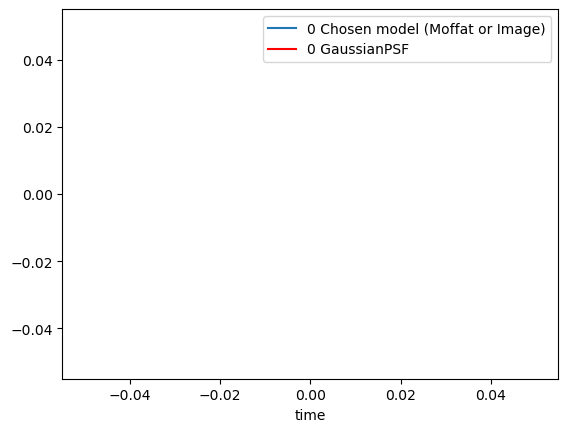

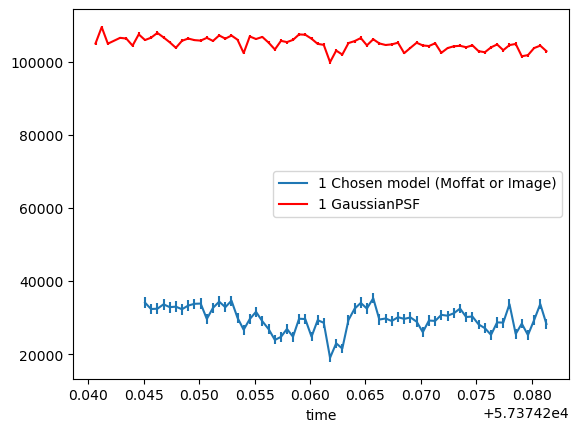

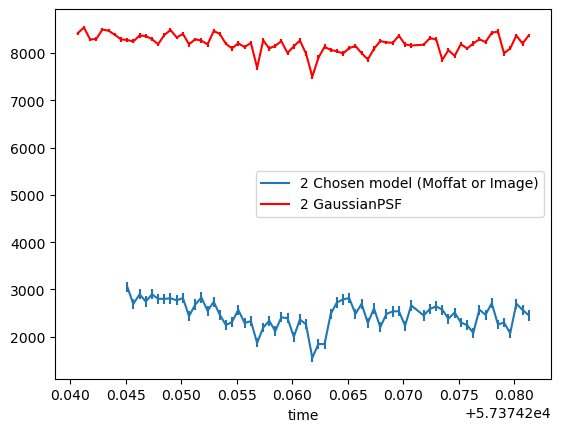

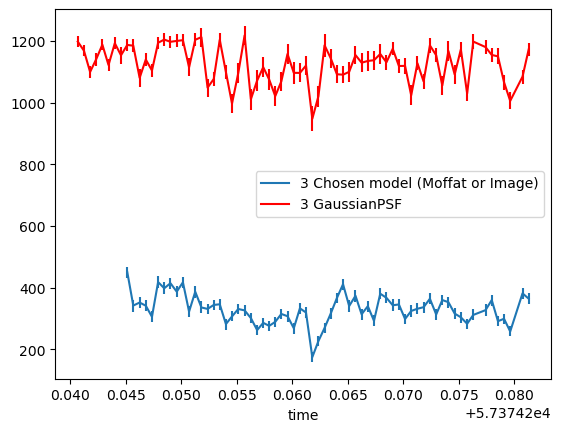

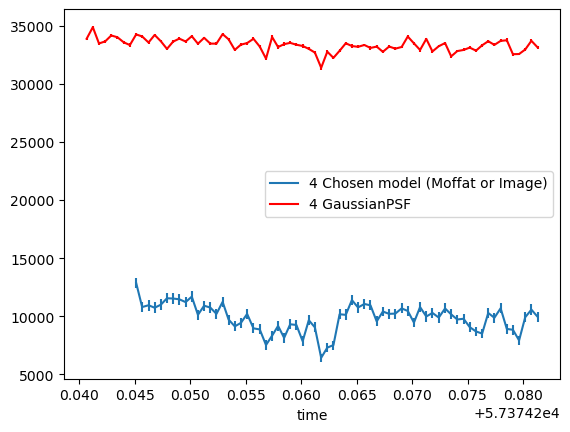

...

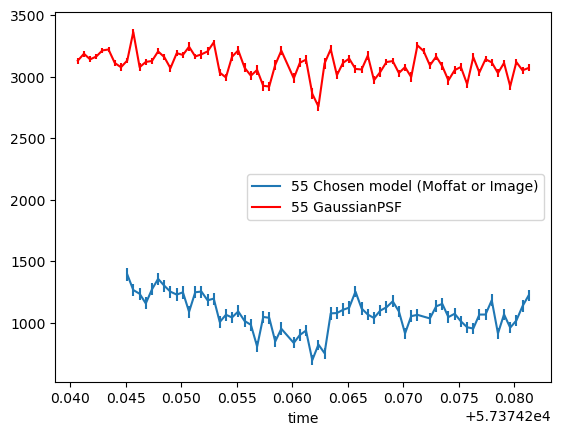

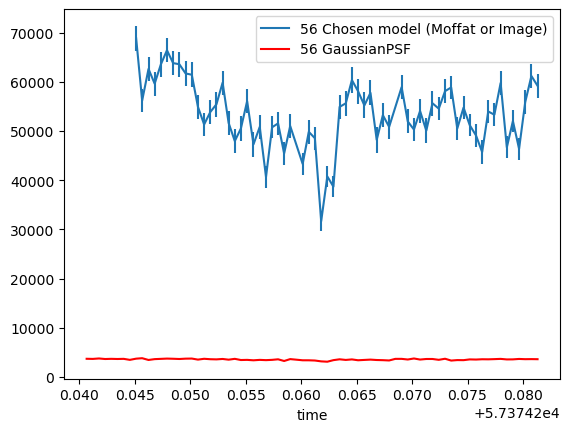

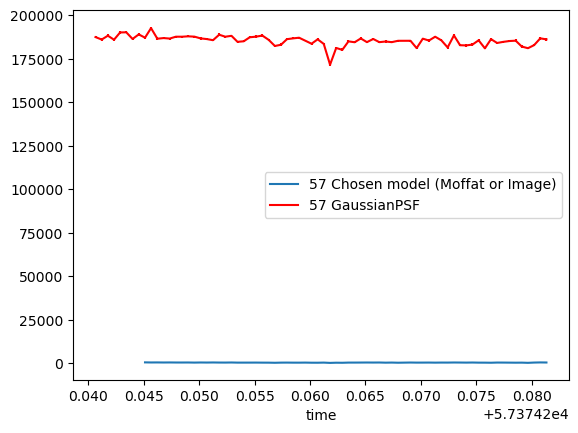

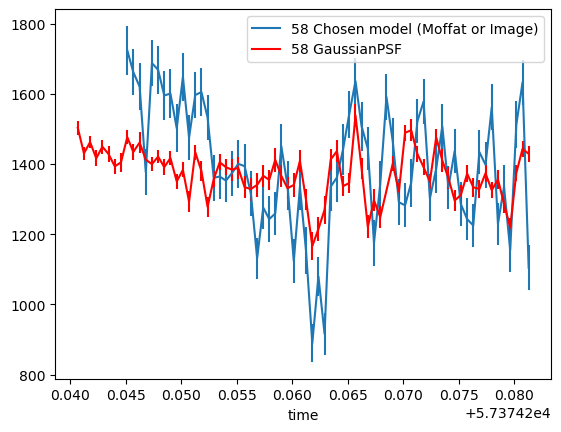

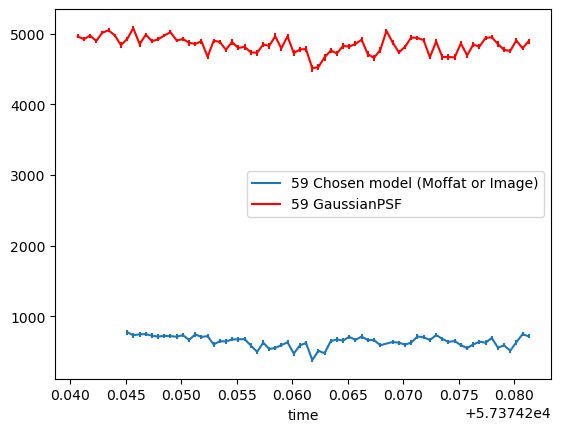

In [1313]:
for i in range(60):
    ax = main_df[main_df['id'] == i].plot(x = 'time', y='flux_fit', yerr='flux_err', label=f"{i} Chosen model (Moffat or Image)")
    main_df_Gaussian[main_df_Gaussian['id'] == i].plot(x = 'time', y='flux_fit', 
                                                       yerr='flux_err', label=f"{i} GaussianPSF", color='r', ax=ax)

In [1314]:
flr_id = 11

In [1318]:
(main_df['id'] == flr_id).sum()

74

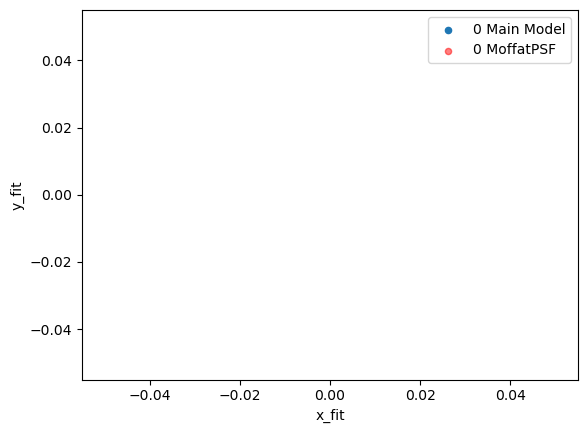

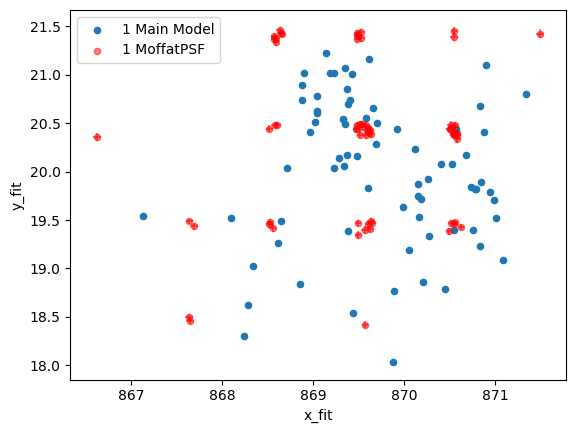

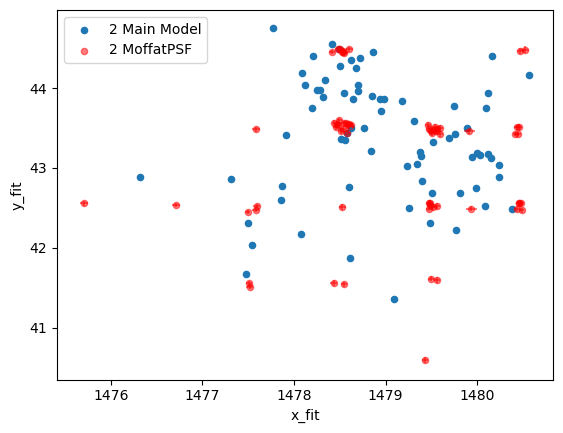

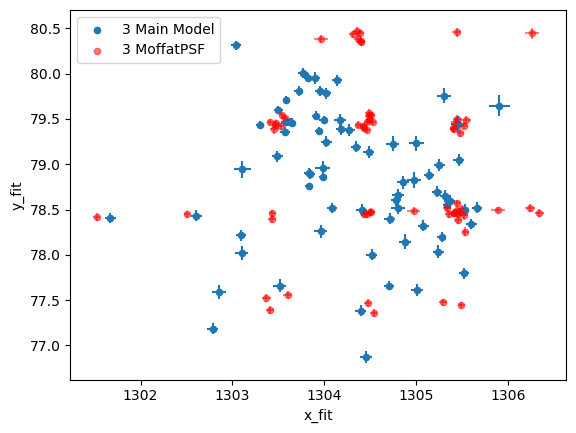

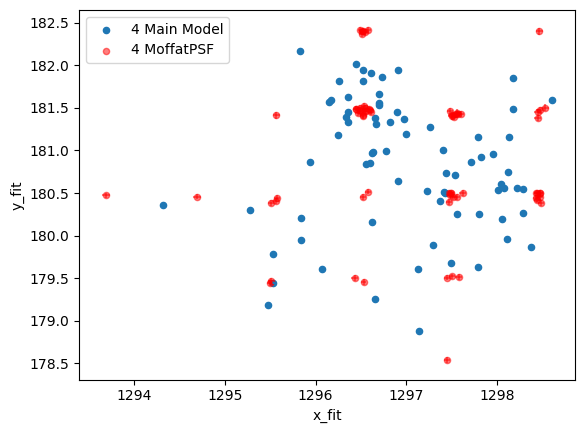

...

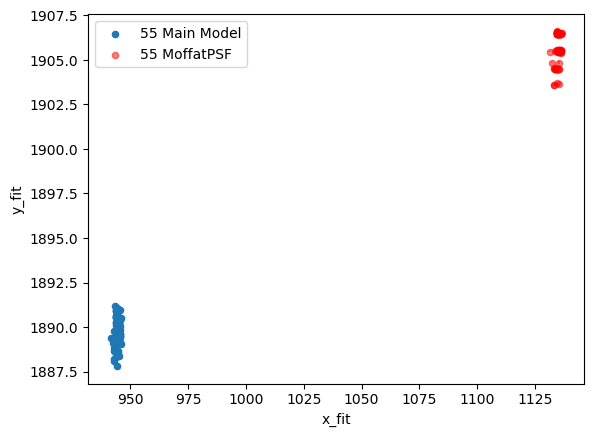

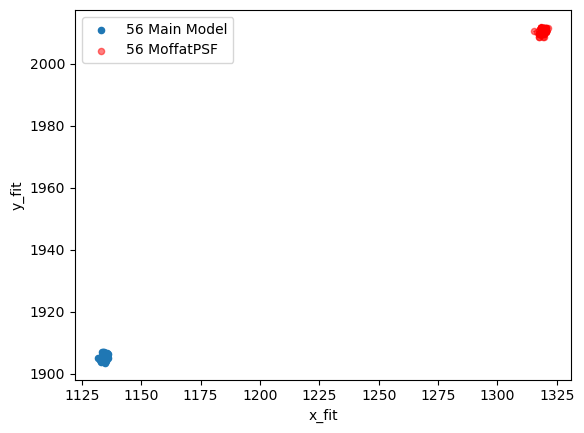

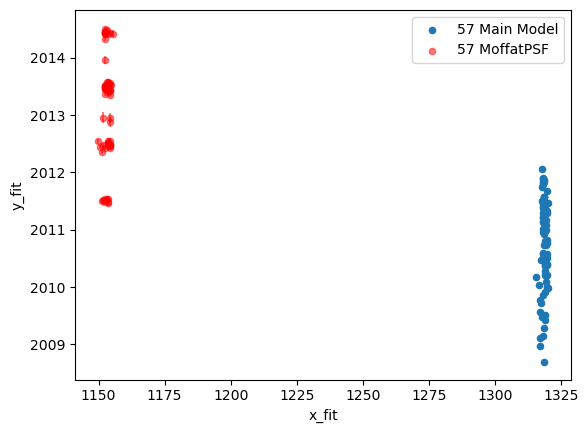

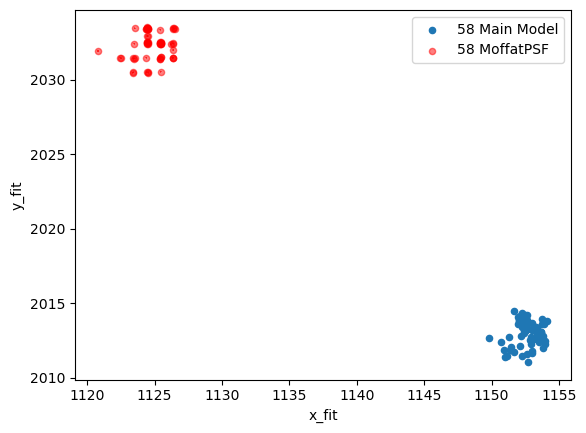

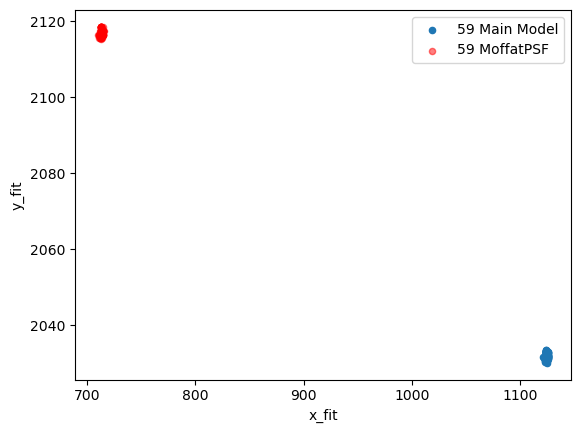

In [1338]:
for i in range(60):
    ax = main_df[main_df['id'] == i].plot(x = 'x_fit', y='y_fit', xerr='x_err', yerr='y_err', 
                                          label=f"{i} Main Model", kind='scatter')
    main_df_Moffat[main_df_Moffat['id'] == i].plot(x = 'x_fit', y='y_fit', xerr='x_err', yerr='y_err', 
                                                       label=f"{i} MoffatPSF", color='r', #ax=ax, 
                                                       kind='scatter', alpha=0.5, ax=ax)

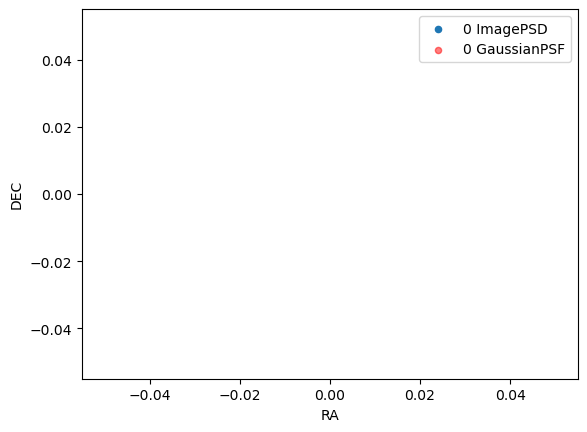

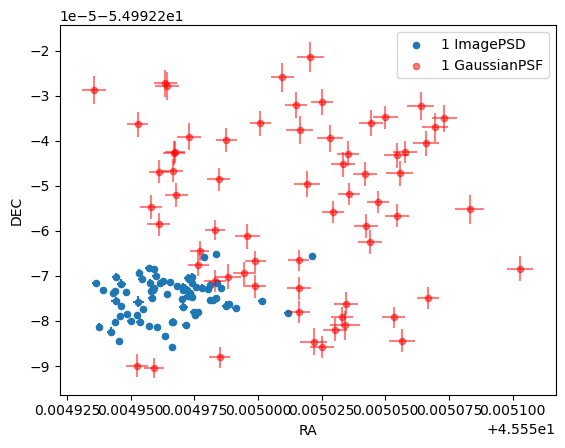

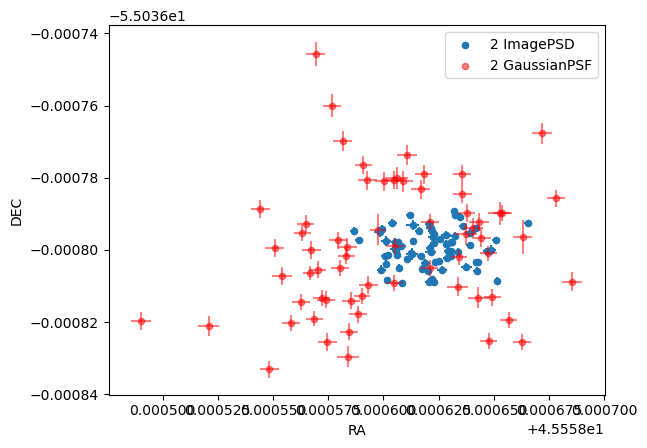

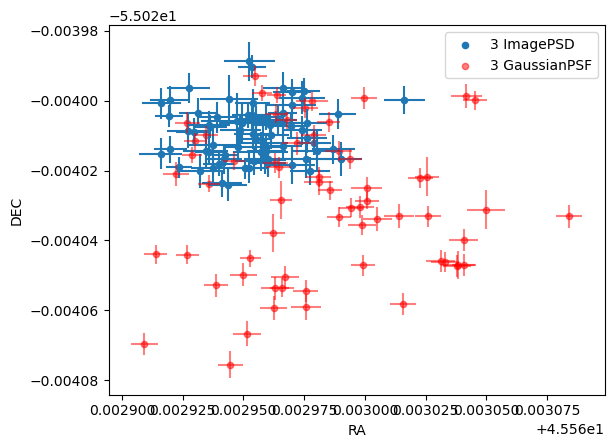

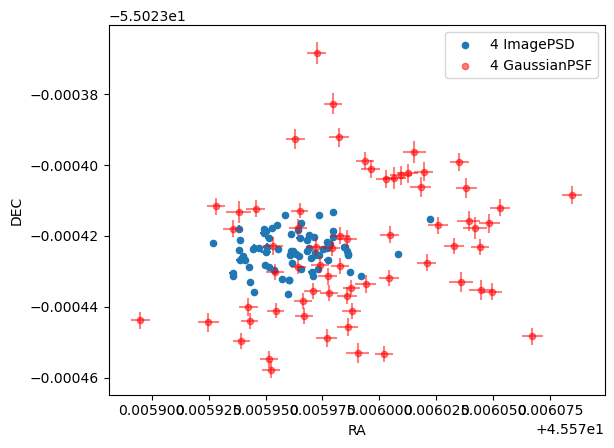

...

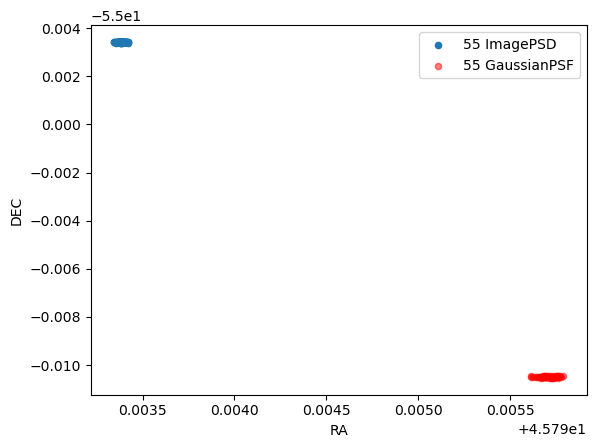

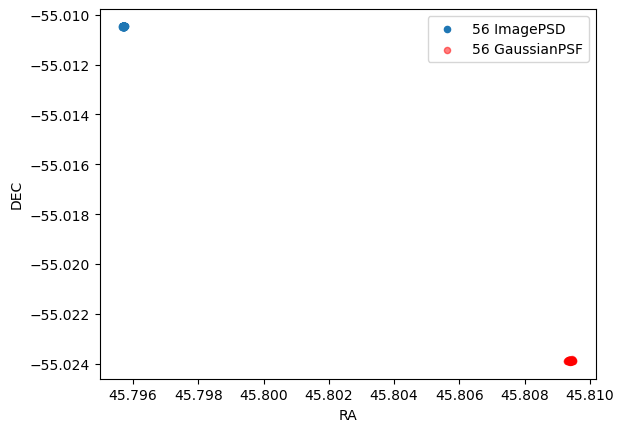

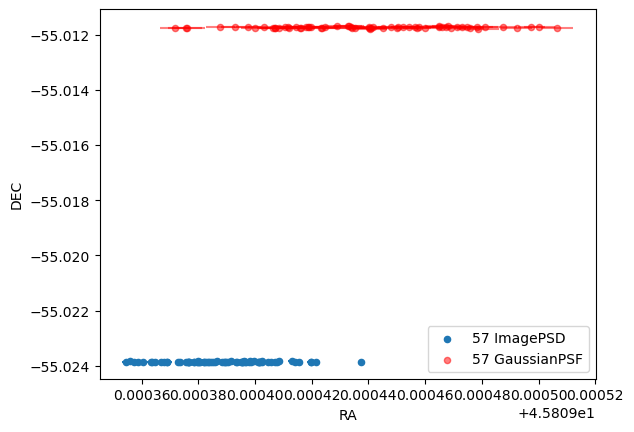

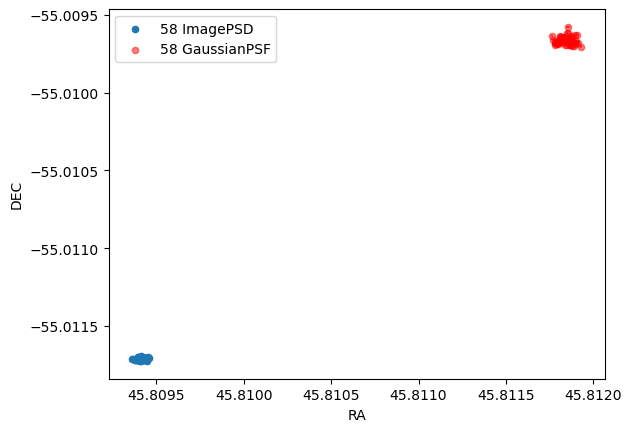

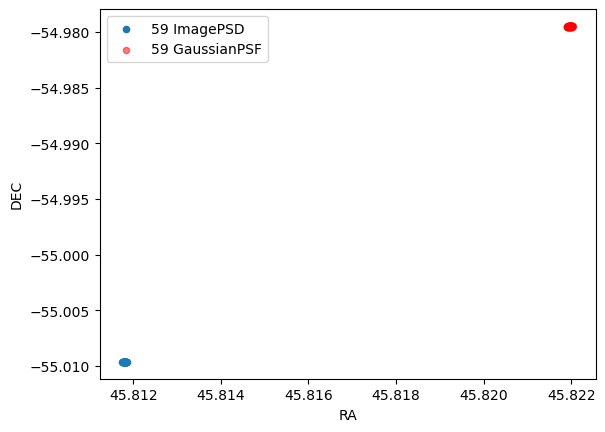

In [1337]:
for i in range(60):
    ax = main_df[main_df['id'] == i].plot(x = 'RA', y='DEC', xerr='RA_ERR', yerr='DEC_ERR', 
                                          label=f"{i} ImagePSD", kind='scatter')
    main_df_Moffat[main_df_Moffat['id'] == i].plot(x = 'RA', y='DEC', xerr='RA_ERR', yerr='DEC_ERR', 
                                                       label=f"{i} GaussianPSF", color='r', ax=ax, 
                                                       kind='scatter', alpha=0.5)

(array([ 1.,  0.,  0.,  1.,  3.,  2., 90.,  0.,  0.,  1.]),
 array([ 58.10810811,  64.18918919,  70.27027027,  76.35135135,
         82.43243243,  88.51351351,  94.59459459, 100.67567568,
        106.75675676, 112.83783784, 118.91891892]),
 <BarContainer object of 10 artists>)

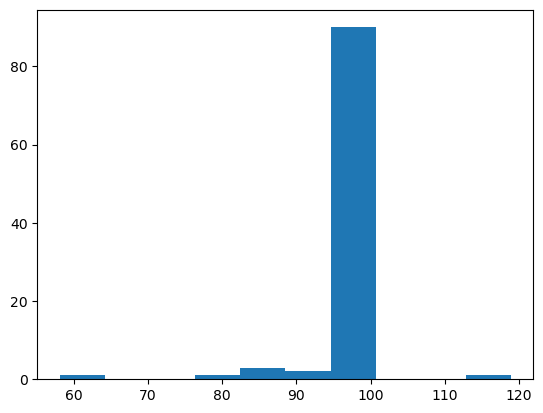

In [1321]:
m = []

for id in main_df['id'].unique():
    m.append((main_df[main_df['id'] == id].shape[0] / 74) * 100)

m = np.array(m)
plt.hist(m)

<Axes: xlabel='time'>

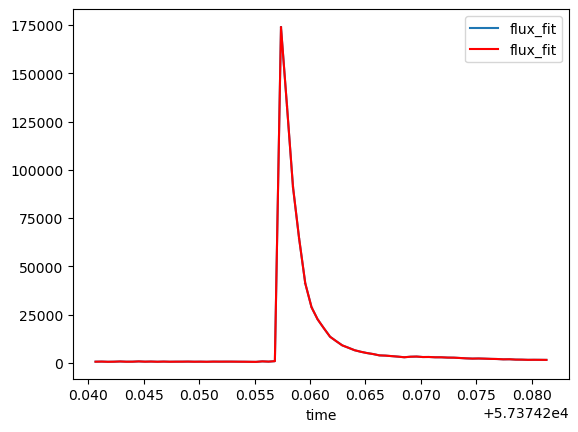

In [1339]:
ax = main_df[main_df['id'] == flr_id].plot(x = 'time', y='flux_fit', yerr='flux_err')
main_df_Gaussian[main_df_Gaussian['id'] == flr_id].plot(x = 'time', y='flux_fit', yerr='flux_err', 
                                                        color='r', ax=ax)

In [1323]:
len(main_df['time'].dropna().unique())#.count()

74

In [1324]:
len(main_df['time'][main_df['id'] == flr_id].dropna().unique())#.count()

74

In [1325]:
#this makes the timeline of the flare 
t_index = [] # dropping nan time? why??

for i , time in enumerate(main_df['time'].dropna().unique()):

    if (main_df['time'][main_df['id'] == flr_id].values == time).any():
        t_index.append(True)

    else:
        t_index.append(False) 
len(t_index)

74

In [1326]:
#put fluxes and turining them into magnitudes - with errors
g_flux = main_df[main_df['id'] == flr_id]['flux_fit']
g_flux_err = main_df[main_df['id'] == flr_id]['flux_err']
flr_times = main_df[main_df['id'] == flr_id]['time']
g_mag = 22.5 - 2.5 * np.log10(g_flux.values)
g_mag_err = (2.5/np.log(10)) * (g_flux_err/g_flux)
g_mag_err = g_mag_err.values #makes it a numpy array?
delta_g_mag = g_mag - np.mean(g_mag[((flr_times - flr_times.iloc[0]) * 3600 * 24) < 1000])
# FBB WHAT IS THE NEXT LINE???
delta_g_mag_err = g_mag_err# - np.sqrt(np.sum(g_mag_err[((flr_times - flr_times.iloc[0]) * 3600 * 24) < 1000] ** 2)) /  len(g_mag_err[((flr_times - flr_times.iloc[0]) * 3600 * 24) < 1000]) 



for i, t in enumerate(t_index):
    #print(t)
    if not t:
        delta_g_mag = np.insert(delta_g_mag, i, np.nan)
        delta_g_mag_err = np.insert(delta_g_mag_err, i, np.nan)
        flr_times = np.insert(flr_times, i, np.nan)
    else:
        pass

delta_g_mag, delta_g_mag_err

(array([ 3.30442449e-02, -5.79934808e-02,  1.26348658e-01,  3.60160763e-02,
        -1.56334831e-01,  5.40010001e-02,  2.19510890e-02, -2.06376791e-01,
         1.61591622e-02, -9.05836556e-02,  8.48588017e-02, -6.03177991e-02,
         7.24512876e-02,  2.22648811e-02,  5.81490986e-03, -5.44708031e-02,
         6.27468828e-02,  1.19198607e-02,  1.07102242e-01, -3.09436229e-02,
         2.34188761e-03, -1.13476233e-02, -1.66527543e-02,  4.12783564e-02,
         7.36218357e-02,  1.45222347e-01,  2.17986203e-01, -2.27612126e-01,
        -1.75380843e-02, -3.73111871e-01, -6.10643114e+00, -5.81722394e+00,
        -5.40412606e+00, -5.03111919e+00, -4.54280755e+00, -4.15345859e+00,
        -3.88661516e+00, -3.64475665e+00, -3.33410953e+00, -3.13333342e+00,
        -2.89747676e+00, -2.73778122e+00, -2.54482802e+00, -2.40458538e+00,
        -2.27079796e+00, -2.15147731e+00, -1.97683998e+00, -1.94056578e+00,
        -1.86241240e+00, -1.77752572e+00, -1.66403938e+00, -1.76102700e+00,
        -1.7

In [1327]:
delta_g_mag.shape

(74,)

In [1328]:
times_restrictes = []
for i, t in enumerate(t_index):
    #print(t)
    if not t:
        pass
    else:
        times_restrictes.append(times)

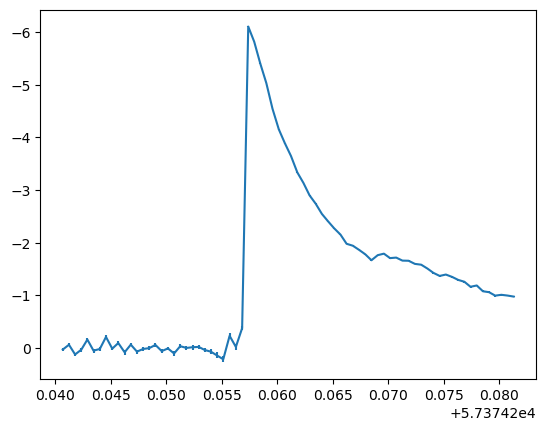

In [1329]:
plt.errorbar(#range(len(delta_g_mag)),
    #(np.array(times_restrictes) - times_restrictes[0]) * 3600 * 24, 
    flr_times,
    delta_g_mag, yerr=delta_g_mag_err)
    #yerr=g_mag_err)
plt.gca().invert_yaxis()

In [1330]:
main_df

,id,group_id,group_size,local_bkg,x_init,y_init,flux_init,x_fit,y_fit,flux_fit,...,DEC,RA_ERR,DEC_ERR,time,x_fwhm_init,y_fwhm_init,x_fwhm_fit,y_fwhm_fit,x_fwhm_err,y_fwhm_err
0,1.0,1.0,1.0,32.954532,868.394115,21.562828,126758.384780,868.902078,21.013326,104968.384637,...,-54.992271,0.000001,7.038646e-07,57374.240660,NaN,NaN,NaN,NaN,NaN,NaN
71,72.0,72.0,1.0,22.699406,502.480951,2587.051335,8067.089820,502.776584,2587.067497,885.647114,...,-54.963825,0.000007,4.065092e-06,57374.240660,NaN,NaN,NaN,NaN,NaN,NaN
70,71.0,71.0,1.0,25.648732,1659.999934,2583.335751,18032.512919,1659.946718,2583.752164,9659.728915,...,-55.048371,0.000001,7.116992e-07,57374.240660,NaN,NaN,NaN,NaN,NaN,NaN
69,70.0,70.0,1.0,23.585986,555.596055,2537.173851,12086.546600,555.705773,2537.103946,3904.421275,...,-54.967731,0.000003,1.685421e-06,57374.240660,NaN,NaN,NaN,NaN,NaN,NaN
68,69.0,69.0,1.0,24.233255,1943.485763,2443.417415,11825.213272,1943.672124,2443.758100,4284.256870,...,-55.069223,0.000002,1.137959e-06,57374.240660,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27,28.0,28.0,1.0,32.694400,330.546420,1165.056191,41246.179740,330.806960,1164.651910,29552.857345,...,-54.952446,0.000002,8.672674e-07,57374.281315,NaN,NaN,NaN,NaN,NaN,NaN
25,27.0,26.0,1.0,26.837021,909.076502,1071.233352,9864.797135,909.645593,1071.193862,1468.696247,...,-54.994793,0.000006,3.439001e-06,57374.281315,NaN,NaN,NaN,NaN,NaN,NaN
23,25.0,24.0,1.0,30.629072,1711.126654,1001.606878,10752.718060,1713.217017,1001.972674,993.537385,...,-55.053571,0.000013,7.286119e-06,57374.281315,NaN,NaN,NaN,NaN,NaN,NaN
34,35.0,35.0,1.0,28.274980,1041.867644,1308.271466,10535.347502,1041.937636,1308.241887,1934.755831,...,-55.004311,0.000005,2.946610e-06,57374.281315,NaN,NaN,NaN,NaN,NaN,NaN


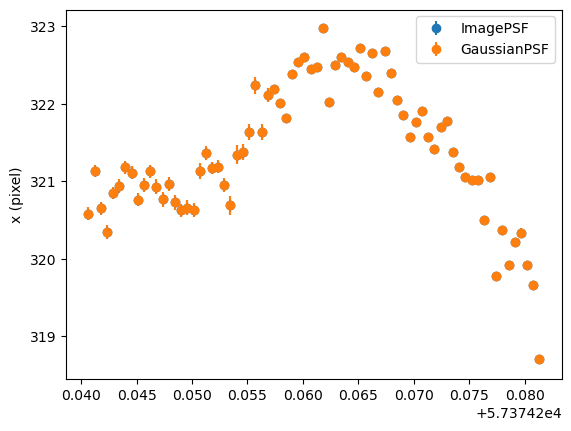

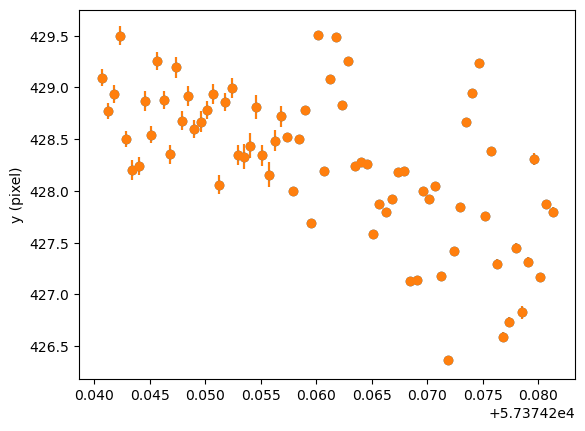

In [1331]:
plt.errorbar(main_df['time'][main_df['id'] == flr_id], main_df['x_fit'][main_df['id'] == flr_id], 
             yerr = main_df['x_err'][main_df['id'] == flr_id], marker='o', ls='None', label="ImagePSF")
#plt.errorbar(main_df_Moffat['time'][main_df_Moffat['id'] == flr_id], 
#             main_df_Moffat['x_fit'][main_df_Moffat['id'] == flr_id], 
#             yerr = main_df_Moffat['x_err'][main_df_Moffat['id'] == flr_id], marker='o', ls='None', label="MoffatPSF")
plt.errorbar(main_df_Gaussian['time'][main_df_Gaussian['id'] == flr_id], 
             main_df_Gaussian['x_fit'][main_df_Gaussian['id'] == flr_id], 
             yerr = main_df_Gaussian['x_err'][main_df_Gaussian['id'] == flr_id], marker='o', ls='None', label="GaussianPSF")
plt.ylabel('x (pixel)')
plt.legend()
plt.show()

plt.errorbar(main_df['time'][main_df['id'] == flr_id], main_df['y_fit'][main_df['id'] == flr_id], 
             yerr = main_df['y_err'][main_df['id'] == flr_id], marker='o', ls='None', label="ImagePSF")
#plt.errorbar(main_df_Moffat['time'][main_df_Moffat['id'] == flr_id], 
#             main_df_Moffat['y_fit'][main_df_Moffat['id'] == flr_id], 
#             yerr = main_df_Moffat['y_err'][main_df_Moffat['id'] == flr_id], marker='o', ls='None', label="MoffatPSF")
plt.errorbar(main_df_Gaussian['time'][main_df_Gaussian['id'] == flr_id], 
             main_df_Gaussian['y_fit'][main_df_Gaussian['id'] == flr_id], 
             yerr = main_df_Gaussian['y_err'][main_df_Gaussian['id'] == flr_id], marker='o', ls='None', label="GaussianPSF")
plt.ylabel('y (pixel)')
plt.show()


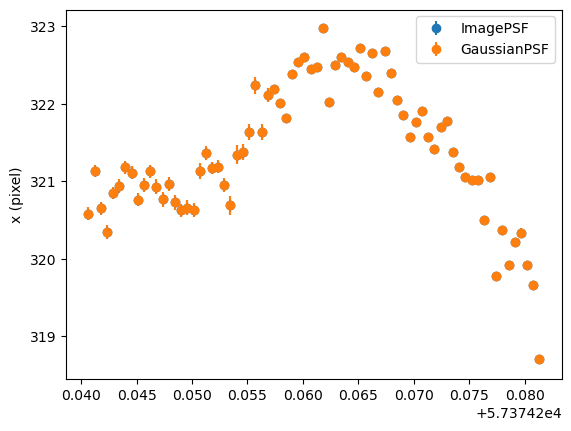

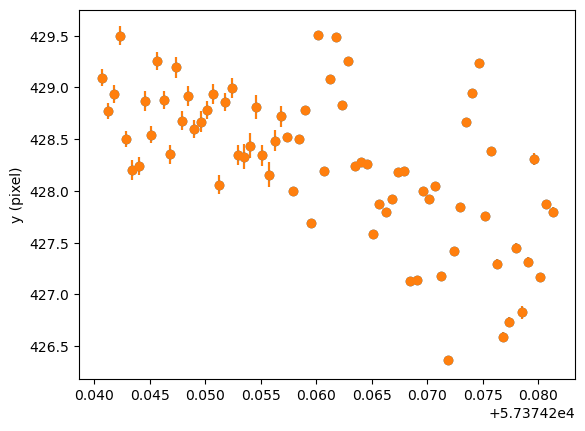

In [1332]:
plt.errorbar(main_df['time'][main_df['id'] == flr_id], main_df['x_fit'][main_df['id'] == flr_id], 
             yerr = main_df['x_err'][main_df['id'] == flr_id], marker='o', ls='None', label="ImagePSF")
#plt.errorbar(main_df_Moffat['time'][main_df_Moffat['id'] == flr_id], 
#             main_df_Moffat['x_fit'][main_df_Moffat['id'] == flr_id], 
#             yerr = main_df_Moffat['x_err'][main_df_Moffat['id'] == flr_id], marker='o', ls='None', label="MoffatPSF")
plt.errorbar(main_df_Gaussian['time'][main_df_Gaussian['id'] == flr_id], 
             main_df_Gaussian['x_fit'][main_df_Gaussian['id'] == flr_id], 
             yerr = main_df_Gaussian['x_err'][main_df_Gaussian['id'] == flr_id], marker='o', ls='None', label="GaussianPSF")
plt.ylabel('x (pixel)')
plt.legend()
plt.show()

plt.errorbar(main_df['time'][main_df['id'] == flr_id], main_df['y_fit'][main_df['id'] == flr_id], 
             yerr = main_df['y_err'][main_df['id'] == flr_id], marker='o', ls='None', label="ImagePSF")
#plt.errorbar(main_df_Moffat['time'][main_df_Moffat['id'] == flr_id], 
#             main_df_Moffat['y_fit'][main_df_Moffat['id'] == flr_id], 
#             yerr = main_df_Moffat['y_err'][main_df_Moffat['id'] == flr_id], marker='o', ls='None', label="MoffatPSF")
plt.errorbar(main_df_Gaussian['time'][main_df_Gaussian['id'] == flr_id], 
             main_df_Gaussian['y_fit'][main_df_Gaussian['id'] == flr_id], 
             yerr = main_df_Gaussian['y_err'][main_df_Gaussian['id'] == flr_id], marker='o', ls='None', label="GaussianPSF")
plt.ylabel('y (pixel)')
plt.show()


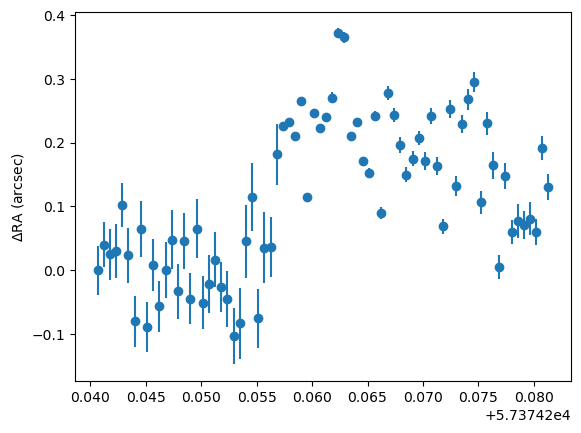

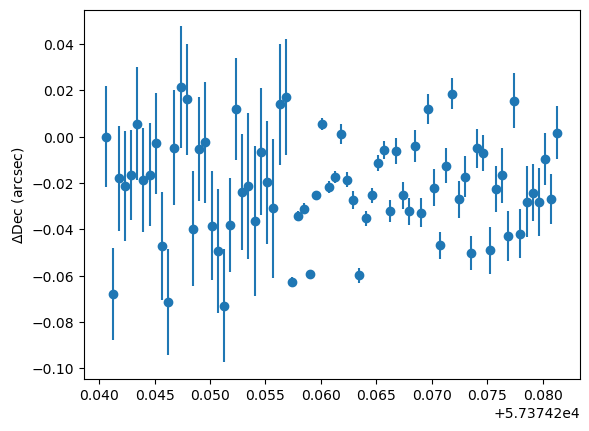

In [1333]:

plt.errorbar(main_df['time'][main_df['id'] == flr_id], (main_df['RA'][main_df['id'] == flr_id] - main_df['RA'][main_df['id'] == flr_id].iloc[0]) * 3600, yerr = main_df['RA_ERR'][main_df['id'] == flr_id] * 3600, marker='o', ls='None')
plt.ylabel(r'$\Delta$RA (arcsec)')
plt.show()

plt.errorbar(main_df['time'][main_df['id'] == flr_id], (main_df['DEC'][main_df['id'] == flr_id] - main_df['DEC'][main_df['id'] == flr_id].iloc[0]) * 3600, yerr = main_df['DEC_ERR'][main_df['id'] == flr_id] * 3600, marker='o', ls='None')
plt.ylabel(r'$\Delta$Dec (arcsec)')
plt.show()